# Introduction

This notebook recorde the basic QC level analysis for Donoir 4 and Donor 9

In [160]:
setwd("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9")

In [190]:
pdf="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/PDFs/"

# Configure

In [9]:
# system("cp /lab/solexa_weissman/cweng/Packages/scMitoTracing/renv.lock ./")
# system("cp /lab/solexa_weissman/cweng/Packages/scMitoTracing/activate.R ./")

In [1]:
source("activate.R") # Can skip this if put in .Rprofile 
Sys.setenv(RENV_PATHS_CACHE = "/lab/solexa_weissman/cweng/Packages/R/x86_64-pc-linux-gnu-library/4.1-focal") 
renv::paths$cache()
#renv::restore()

[1] "/lab/solexa_weissman/cweng/Packages/R/x86_64-pc-linux-gnu-library/4.1-focal/v5/R-4.1/x86_64-pc-linux-gnu"

In [335]:
library(devtools)
# devtools::install_github("chenweng1991/scMitoTracing")
# devtools::install_github("chenweng1991/EZsinglecell2")
#install.packages("/lab/solexa_weissman/cweng/Packages/scMitoTracing/")

#install.packages("/lab/solexa_weissman/cweng/Packages/MyMultiome/Helpers/EZsinglecell2")
detach("package:scMitoTracing",unload=T)
install.packages("/lab/solexa_weissman/cweng/Packages/scMitoTracing")
library(EZsinglecell2)
library(scMitoTracing)
library(gridExtra)
library(BuenColors)
library(ggrepel)

Installing scMitoTracing [0.0.0.9000] ...
	OK [built from source]


In [323]:
library(dplyr)

In [120]:
detach("package:EZsinglecell2",unload=T)
library(EZsinglecell2)
#detach("package:scMitoTracing",unload=T)

In [1917]:
devtools::install_github("mtennekes/cols4all")

colorspace (2.0-2 -> 2.0-3) [CRAN]


Installing 1 packages: colorspace

Installing package into ‘/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/renv/library/R-4.1/x86_64-pc-linux-gnu’
(as ‘lib’ is unspecified)



* checking for file ‘/tmp/Rtmp4uRNaY/remotesb5a836934ee6/mtennekes-cols4all-82e26e0/DESCRIPTION’ ... OK
* preparing ‘cols4all’:
* checking DESCRIPTION meta-information ... OK
* checking for LF line-endings in source and make files and shell scripts
* checking for empty or unneeded directories
* looking to see if a ‘data/datalist’ file should be added
* building ‘cols4all_0.1.tar.gz’



Installing package into ‘/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/renv/library/R-4.1/x86_64-pc-linux-gnu’
(as ‘lib’ is unspecified)



In [163]:
library(cols4all)
install.packages("wesanderson")
library(wesanderson)
#install.packages(c("shiny", "shinyjs", "kableExtra"))

Retrieving 'https://cloud.r-project.org/src/contrib/wesanderson_0.3.6.tar.gz' ...
	OK [downloaded 6.1 Kb in 4.8 secs]
Installing wesanderson [0.3.6] ...
	OK [built from source]
Moving wesanderson [0.3.6] into the cache ...
	OK [moved to cache in 3.4 milliseconds]


Registered S3 method overwritten by 'wesanderson':
  method        from      
  print.palette BuenColors




Listening on http://127.0.0.1:4355



# Variant parsing

## DN4_BMMC

### Fast load

In [10]:
## Fast load
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_BMMC/MTenrichCombine/mitoV/final"
DN4_BMMC.depth<-readRDS(paste(WD,"/DN4_BMMC.depth",sep=""))
DN4_BMMC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN4_BMMC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_BMMC.VariantsGTSummary,depth=DN4_BMMC.depth)

[1] "Total :\n 47320 variants to start"
[1] "47138 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 11674_C_T" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 11947_A_G" "Tag Homoplasmy: 12414_T_C"
 [5] "Tag Homoplasmy: 1243_T_C"  "Tag Homoplasmy: 12705_C_T"
 [7] "Tag Homoplasmy: 12923_G_T" "Tag Homoplasmy: 1406_T_C" 
 [9] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
[11] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 15884_G_C"
[13] "Tag Homoplasmy: 16223_C_T" "Tag Homoplasmy: 16292_C_T"
[15] "Tag Homoplasmy: 16519_T_C" "Tag Homoplasmy: 194_C_T"  
[17] "Tag Homoplasmy: 195_T_C"   "Tag Homoplasmy: 199_T_C"  
[19] "Tag Homoplasmy: 204_T_C"   "Tag Homoplasmy: 207_G_A"  
[21] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 2706_A_G" 
[23] "Tag Homoplasmy: 3505_A_G"  "Tag Homoplasmy: 4769_A_G" 
[25] "Tag Homoplasmy: 5046_G_A"  "Tag Homoplasmy: 5460_G_A" 
[27] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 7058_T_C" 
[29] "Tag Homoplasmy: 709_G_A"   "Tag Homoplasmy: 73_A

### Processing

In [3]:
## Sequencing depth (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_BMMC/MTenrichCombine/mitoV/final"
DN4_BMMC.depth<-DepthSummary(WD,CellSubset = NA,cellSubSetName = NA) ## Note, recommend to save out as RDS  
#saveRDS(DN4_BMMC.depth,paste(WD,"/DN4_BMMC.depth",sep=""))

[1] "Use all cells"
[1] "8020 Cells in QualifiedTotalCts"


In [4]:
## Genotype and variant feature (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_BMMC/MTenrichCombine/mitoV/final"
DN4_BMMC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =F)
DN4_BMMC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_BMMC.VariantsGTSummary,depth=DN4_BMMC.depth)

[1] "Total :\n 47320 variants to start"
[1] "47138 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 11674_C_T" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 11947_A_G" "Tag Homoplasmy: 12414_T_C"
 [5] "Tag Homoplasmy: 1243_T_C"  "Tag Homoplasmy: 12705_C_T"
 [7] "Tag Homoplasmy: 12923_G_T" "Tag Homoplasmy: 1406_T_C" 
 [9] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
[11] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 15884_G_C"
[13] "Tag Homoplasmy: 16223_C_T" "Tag Homoplasmy: 16292_C_T"
[15] "Tag Homoplasmy: 16519_T_C" "Tag Homoplasmy: 194_C_T"  
[17] "Tag Homoplasmy: 195_T_C"   "Tag Homoplasmy: 199_T_C"  
[19] "Tag Homoplasmy: 204_T_C"   "Tag Homoplasmy: 207_G_A"  
[21] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 2706_A_G" 
[23] "Tag Homoplasmy: 3505_A_G"  "Tag Homoplasmy: 4769_A_G" 
[25] "Tag Homoplasmy: 5046_G_A"  "Tag Homoplasmy: 5460_G_A" 
[27] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 7058_T_C" 
[29] "Tag Homoplasmy: 709_G_A"   "Tag Homoplasmy: 73_A

### Basic plots

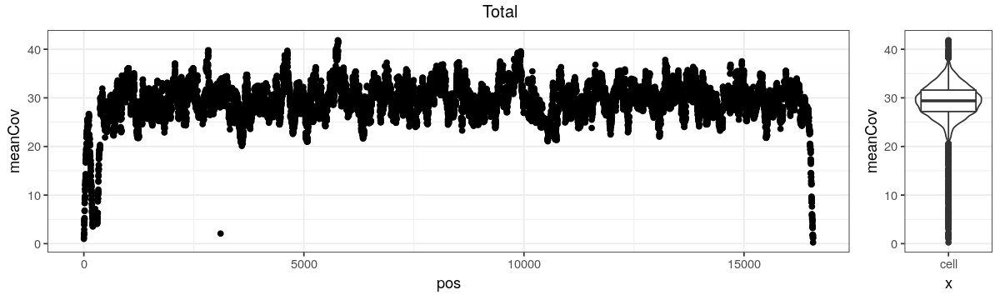

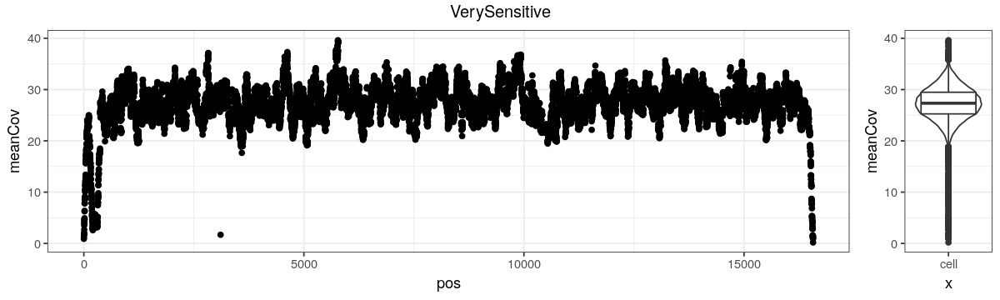

In [6]:
plot_depth(DN4_BMMC.depth$Total,"Total")
plot_depth(DN4_BMMC.depth$Sensitive,"Sensitive")

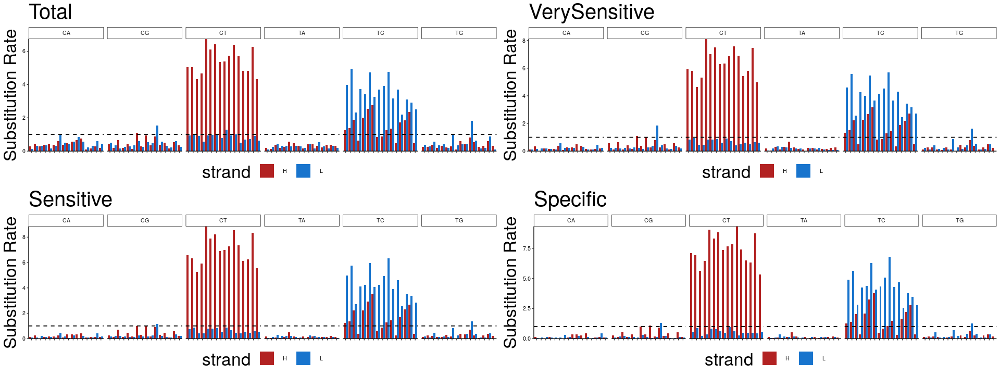

In [7]:
options(repr.plot.width=16, repr.plot.height=6)
ps<-list()
for(name in names(DN4_BMMC.Variants.feature.lst)){
p<-MutationProfile.bulk(DN4_BMMC.Variants.feature.lst[[name]]$Variants)+ggtitle(name)+theme(title =element_text(size=20))
ps<-c(ps,list(p))
}
grid.arrange(grobs=ps)

Loading required package: ggExtra

Warning message:
“Removed 719 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 183 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 2 rows containing non-finite values (stat_bin).”


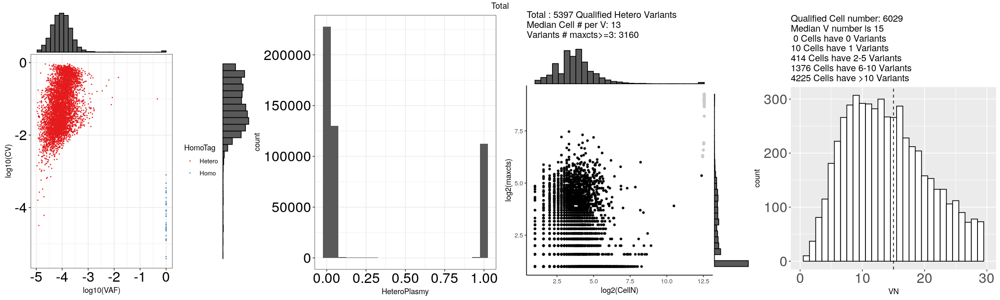

Warning message:
“Removed 77 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 5 rows containing non-finite values (stat_bin).”


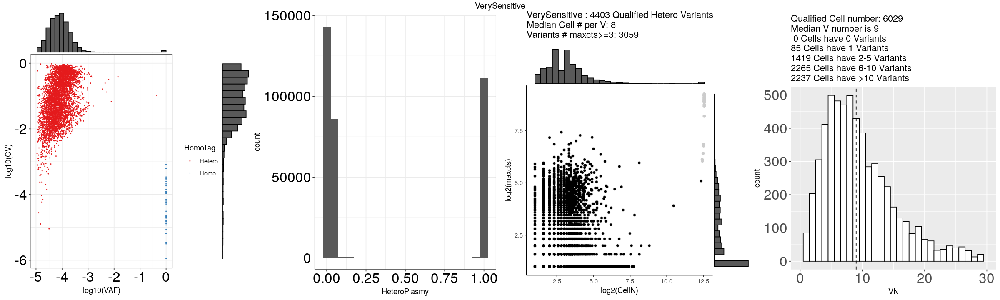

Warning message:
“Removed 33 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


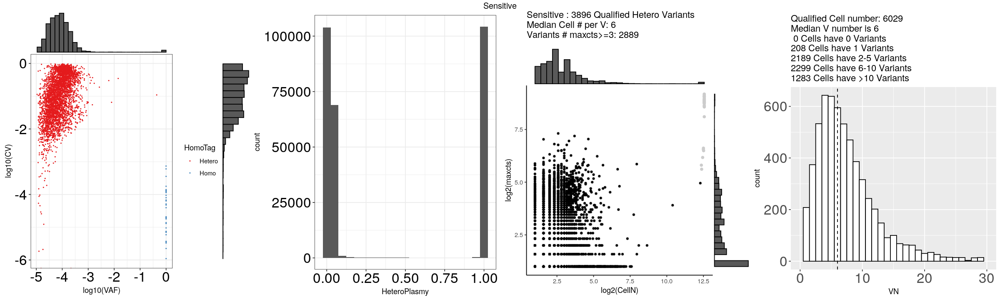

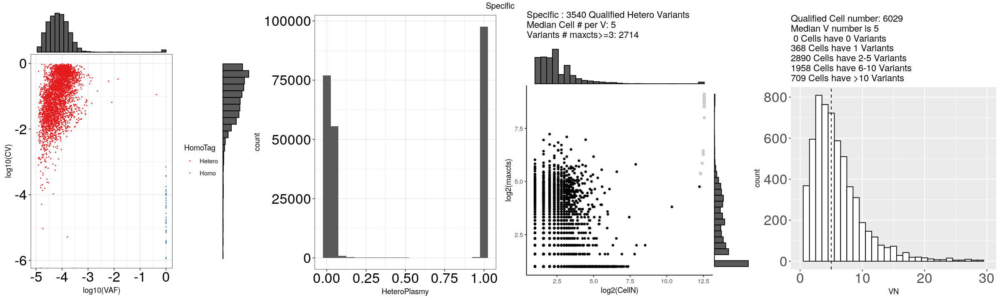

In [8]:
plot_variant(DN4_BMMC.VariantsGTSummary,DN4_BMMC.Variants.feature.lst,depth=DN4_BMMC.depth,cat=c("Total","VerySensitive","Sensitive","Specific"),p4xlim = 30)

## DN4_HPC

### Fast load

In [14]:
## Fast load
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HPC/MTenrichCombine/mitoV/final"
DN4_HPC.depth<-readRDS(paste(WD,"/DN4_HPC.depth",sep=""))
DN4_HPC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN4_HPC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_HPC.VariantsGTSummary,depth=DN4_HPC.depth)

[1] "Total :\n 48151 variants to start"
[1] "48111 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 11674_C_T" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 11947_A_G" "Tag Homoplasmy: 12414_T_C"
 [5] "Tag Homoplasmy: 1243_T_C"  "Tag Homoplasmy: 12705_C_T"
 [7] "Tag Homoplasmy: 12923_G_T" "Tag Homoplasmy: 1406_T_C" 
 [9] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
[11] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 15884_G_C"
[13] "Tag Homoplasmy: 16223_C_T" "Tag Homoplasmy: 16292_C_T"
[15] "Tag Homoplasmy: 16519_T_C" "Tag Homoplasmy: 194_C_T"  
[17] "Tag Homoplasmy: 195_T_C"   "Tag Homoplasmy: 199_T_C"  
[19] "Tag Homoplasmy: 204_T_C"   "Tag Homoplasmy: 207_G_A"  
[21] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 2706_A_G" 
[23] "Tag Homoplasmy: 3505_A_G"  "Tag Homoplasmy: 4769_A_G" 
[25] "Tag Homoplasmy: 5046_G_A"  "Tag Homoplasmy: 5460_G_A" 
[27] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 7058_T_C" 
[29] "Tag Homoplasmy: 709_G_A"   "Tag Homoplasmy: 73_A

### Processing

In [12]:
## Sequencing depth (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HPC/MTenrichCombine/mitoV/final"
DN4_HPC.depth<-DepthSummary(WD,CellSubset = NA,cellSubSetName = NA) ## Note, recommend to save out as RDS  
#saveRDS(DN4_HPC.depth,paste(WD,"/DN4_HPC.depth",sep=""))

[1] "Use all cells"
[1] "7404 Cells in QualifiedTotalCts"


In [13]:
## Genotype and variant feature (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HPC/MTenrichCombine/mitoV/final"
DN4_HPC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =F)
DN4_HPC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_HPC.VariantsGTSummary,depth=DN4_HPC.depth)

[1] "Total :\n 48151 variants to start"
[1] "48111 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 11674_C_T" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 11947_A_G" "Tag Homoplasmy: 12414_T_C"
 [5] "Tag Homoplasmy: 1243_T_C"  "Tag Homoplasmy: 12705_C_T"
 [7] "Tag Homoplasmy: 12923_G_T" "Tag Homoplasmy: 1406_T_C" 
 [9] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
[11] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 15884_G_C"
[13] "Tag Homoplasmy: 16223_C_T" "Tag Homoplasmy: 16292_C_T"
[15] "Tag Homoplasmy: 16519_T_C" "Tag Homoplasmy: 194_C_T"  
[17] "Tag Homoplasmy: 195_T_C"   "Tag Homoplasmy: 199_T_C"  
[19] "Tag Homoplasmy: 204_T_C"   "Tag Homoplasmy: 207_G_A"  
[21] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 2706_A_G" 
[23] "Tag Homoplasmy: 3505_A_G"  "Tag Homoplasmy: 4769_A_G" 
[25] "Tag Homoplasmy: 5046_G_A"  "Tag Homoplasmy: 5460_G_A" 
[27] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 7058_T_C" 
[29] "Tag Homoplasmy: 709_G_A"   "Tag Homoplasmy: 73_A

### Basic ploting

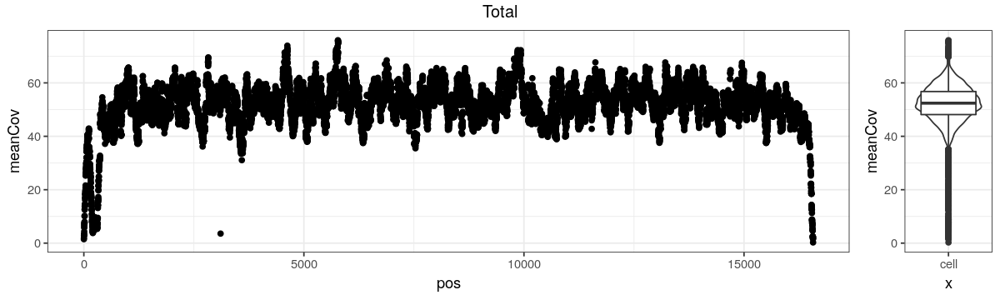

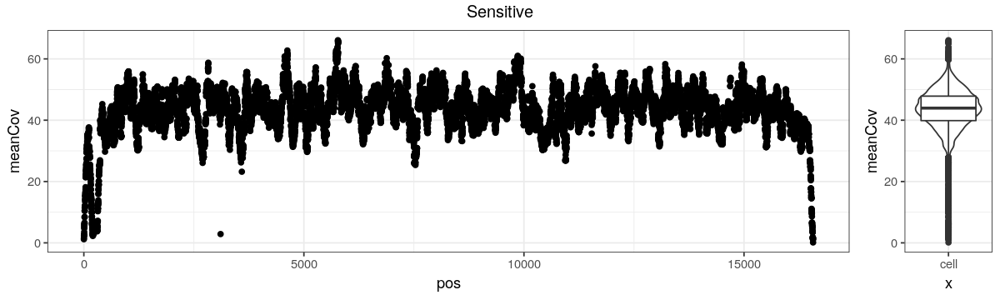

In [15]:
plot_depth(DN4_HPC.depth$Total,"Total")
plot_depth(DN4_HPC.depth$Sensitive,"Sensitive")

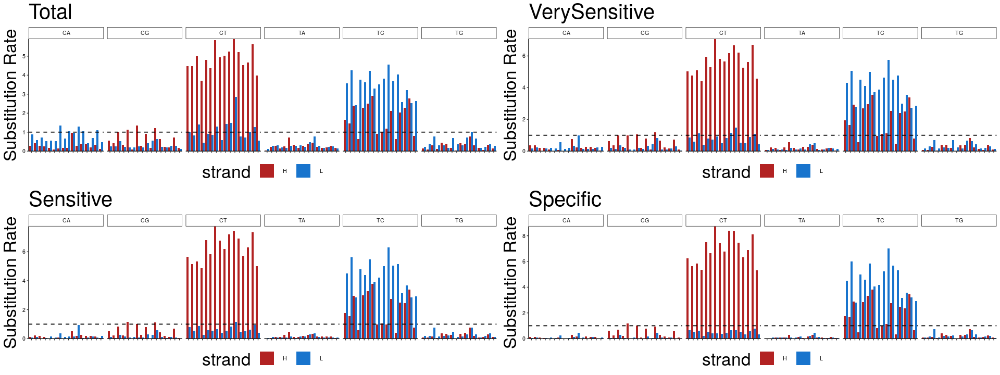

In [16]:
options(repr.plot.width=16, repr.plot.height=6)
ps<-list()
for(name in names(DN4_HPC.Variants.feature.lst)){
p<-MutationProfile.bulk(DN4_HPC.Variants.feature.lst[[name]]$Variants)+ggtitle(name)+theme(title =element_text(size=20))
ps<-c(ps,list(p))
}
grid.arrange(grobs=ps)

Warning message:
“Removed 3772 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 1 rows containing missing values (geom_vline).”
Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 1179 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”


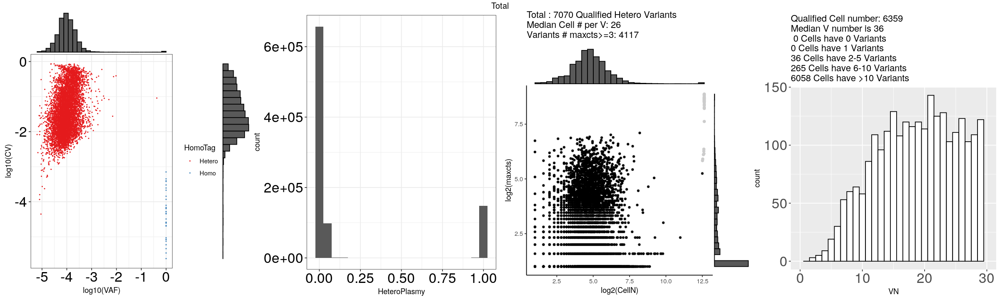

Warning message:
“Removed 204 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 3 rows containing non-finite values (stat_bin).”


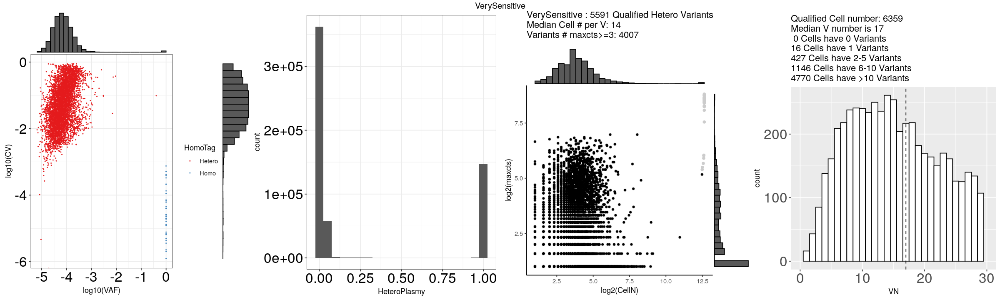

Warning message:
“Removed 7 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


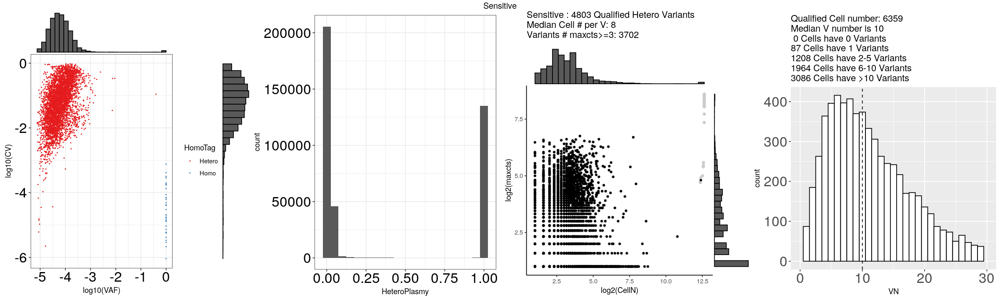

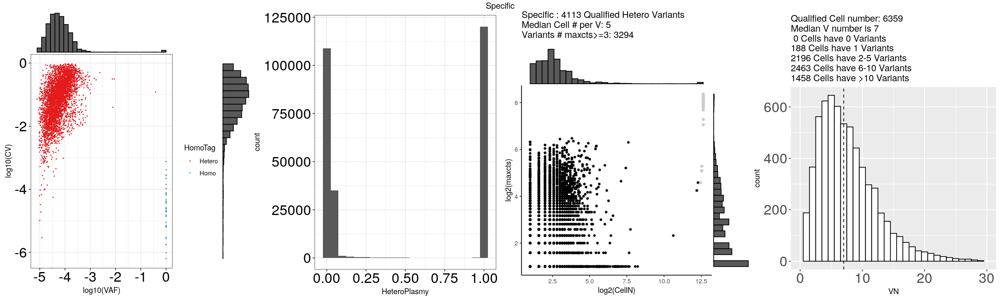

In [17]:
plot_variant(DN4_HPC.VariantsGTSummary,DN4_HPC.Variants.feature.lst,depth=DN4_HPC.depth,cat=c("Total","VerySensitive","Sensitive","Specific"),p4xlim = 30)

## DN4_HSC

### Fast load

In [21]:
## Fast load
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HSC/MTenrichCombine/mitoV/final"
DN4_HSC.depth<-readRDS(paste(WD,"/DN4_HSC.depth",sep=""))
DN4_HSC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN4_HSC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_HSC.VariantsGTSummary,depth=DN4_HSC.depth)

[1] "Total :\n 47753 variants to start"
[1] "47708 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 11674_C_T" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 11947_A_G" "Tag Homoplasmy: 12414_T_C"
 [5] "Tag Homoplasmy: 1243_T_C"  "Tag Homoplasmy: 12705_C_T"
 [7] "Tag Homoplasmy: 12923_G_T" "Tag Homoplasmy: 1406_T_C" 
 [9] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
[11] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 15884_G_C"
[13] "Tag Homoplasmy: 16223_C_T" "Tag Homoplasmy: 16292_C_T"
[15] "Tag Homoplasmy: 16519_T_C" "Tag Homoplasmy: 194_C_T"  
[17] "Tag Homoplasmy: 195_T_C"   "Tag Homoplasmy: 199_T_C"  
[19] "Tag Homoplasmy: 204_T_C"   "Tag Homoplasmy: 207_G_A"  
[21] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 2706_A_G" 
[23] "Tag Homoplasmy: 3505_A_G"  "Tag Homoplasmy: 4769_A_G" 
[25] "Tag Homoplasmy: 5046_G_A"  "Tag Homoplasmy: 5460_G_A" 
[27] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 7058_T_C" 
[29] "Tag Homoplasmy: 709_G_A"   "Tag Homoplasmy: 73_A

### Processing

In [19]:
## Sequencing depth (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HSC/MTenrichCombine/mitoV/final"
DN4_HSC.depth<-DepthSummary(WD,CellSubset = NA,cellSubSetName = NA) ## Note, recommend to save out as RDS  
#saveRDS(DN4_HSC.depth,paste(WD,"/DN4_HSC.depth",sep=""))

[1] "Use all cells"
[1] "7257 Cells in QualifiedTotalCts"


In [20]:
## Genotype and variant feature (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HSC/MTenrichCombine/mitoV/final"
DN4_HSC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =F)
DN4_HSC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_HSC.VariantsGTSummary,depth=DN4_HSC.depth)

[1] "Total :\n 47753 variants to start"
[1] "47708 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 11674_C_T" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 11947_A_G" "Tag Homoplasmy: 12414_T_C"
 [5] "Tag Homoplasmy: 1243_T_C"  "Tag Homoplasmy: 12705_C_T"
 [7] "Tag Homoplasmy: 12923_G_T" "Tag Homoplasmy: 1406_T_C" 
 [9] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
[11] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 15884_G_C"
[13] "Tag Homoplasmy: 16223_C_T" "Tag Homoplasmy: 16292_C_T"
[15] "Tag Homoplasmy: 16519_T_C" "Tag Homoplasmy: 194_C_T"  
[17] "Tag Homoplasmy: 195_T_C"   "Tag Homoplasmy: 199_T_C"  
[19] "Tag Homoplasmy: 204_T_C"   "Tag Homoplasmy: 207_G_A"  
[21] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 2706_A_G" 
[23] "Tag Homoplasmy: 3505_A_G"  "Tag Homoplasmy: 4769_A_G" 
[25] "Tag Homoplasmy: 5046_G_A"  "Tag Homoplasmy: 5460_G_A" 
[27] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 7058_T_C" 
[29] "Tag Homoplasmy: 709_G_A"   "Tag Homoplasmy: 73_A

### Basic plotting

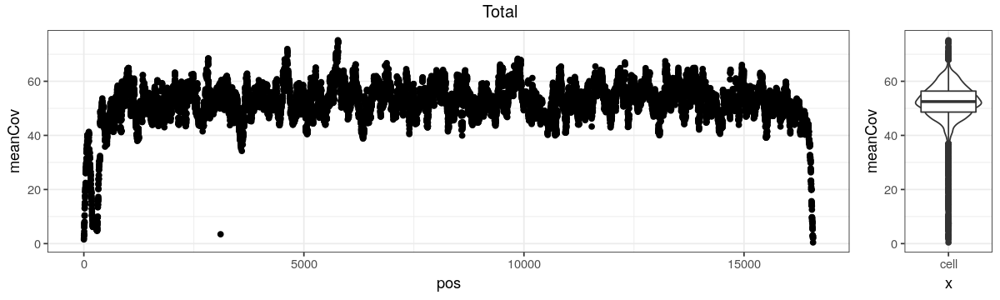

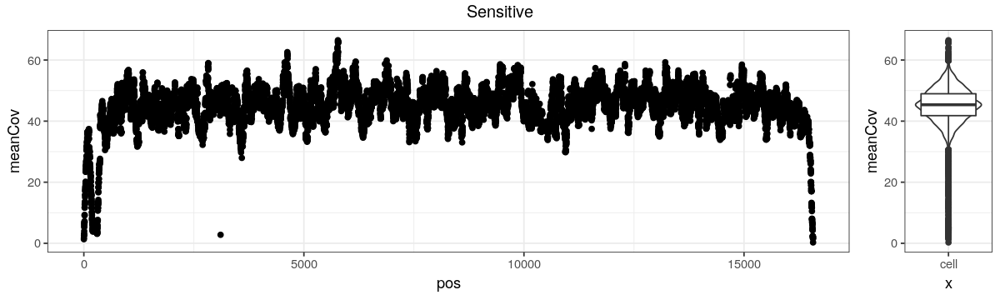

In [32]:
plot_depth(DN4_HSC.depth$Total,"Total")
plot_depth(DN4_HSC.depth$Sensitive,"Sensitive")

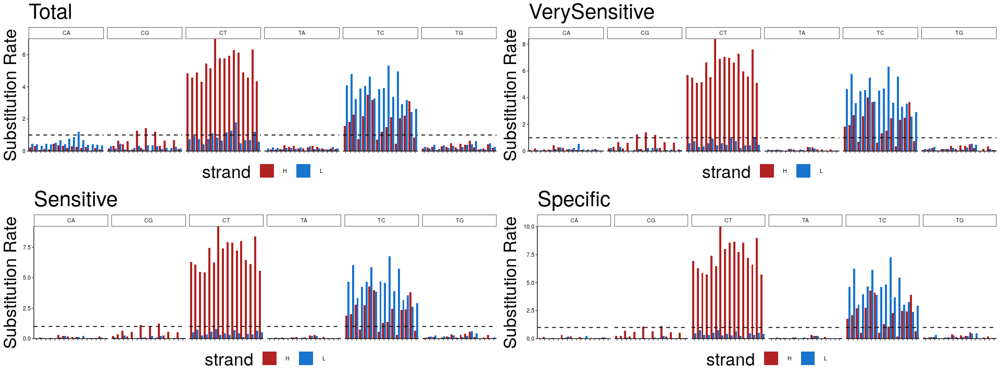

In [33]:
options(repr.plot.width=16, repr.plot.height=6)
ps<-list()
for(name in names(DN4_HSC.Variants.feature.lst)){
p<-MutationProfile.bulk(DN4_HSC.Variants.feature.lst[[name]]$Variants)+ggtitle(name)+theme(title =element_text(size=20))
ps<-c(ps,list(p))
}
grid.arrange(grobs=ps)

Warning message:
“Removed 2098 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 116 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


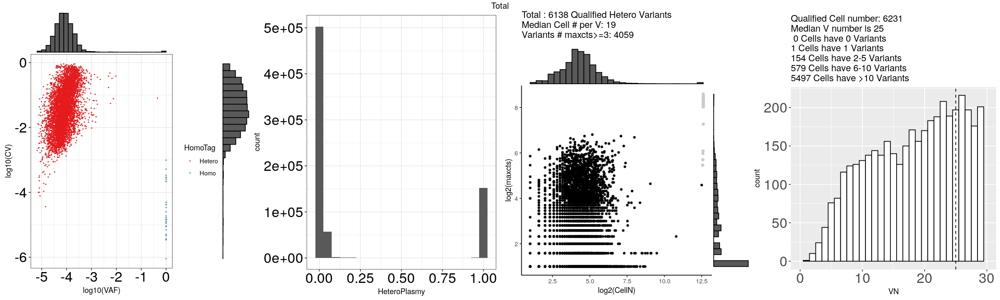

Warning message:
“Removed 14 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”


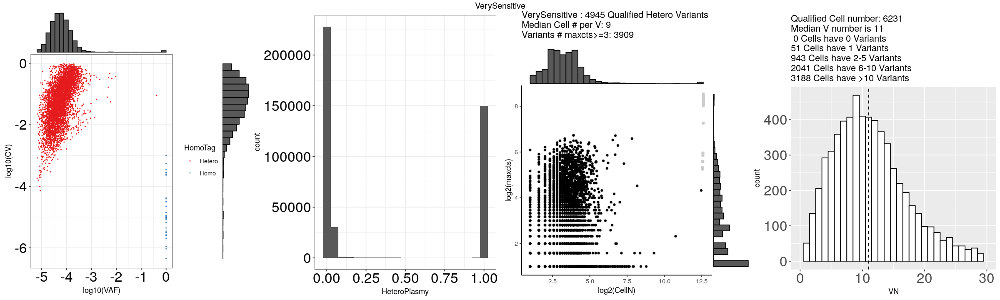

Warning message:
“Removed 2 rows containing missing values (geom_bar).”


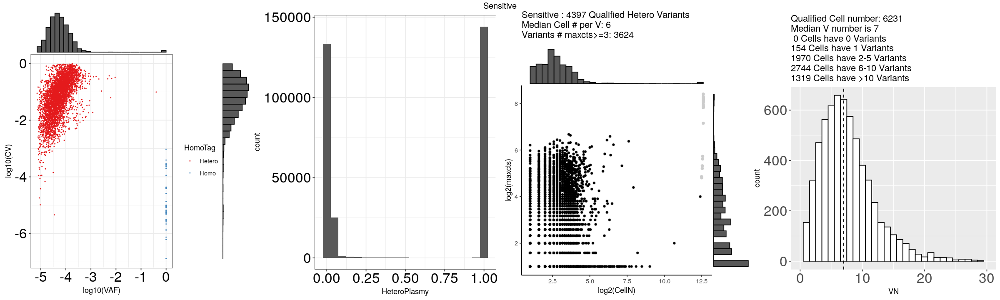

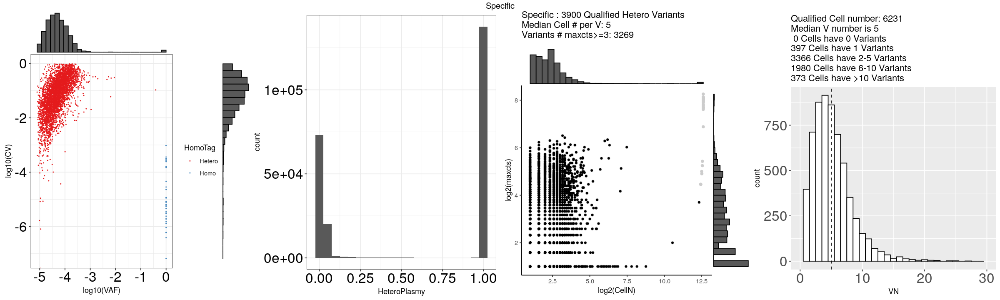

In [35]:
plot_variant(DN4_HSC.VariantsGTSummary,DN4_HSC.Variants.feature.lst,depth=DN4_HSC.depth,cat=c("Total","VerySensitive","Sensitive","Specific"),p4xlim = 30)

## DN9_BMMC

### Fast load

In [24]:
## Fast load
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_BMMC/MTenrichCombine/mitoV/final"
DN9_BMMC.depth<-readRDS(paste(WD,"/DN9_BMMC.depth",sep=""))
DN9_BMMC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN9_BMMC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_BMMC.VariantsGTSummary,depth=DN9_BMMC.depth)

[1] "Total :\n 48154 variants to start"
[1] "47959 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5995 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 45796 variants to start"
[1] "45398 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 4670 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 42762 variants to start"
[1] "42188 variants after remove low quality cel

### Processing

In [22]:
## Sequencing depth (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_BMMC/MTenrichCombine/mitoV/final"
DN9_BMMC.depth<-DepthSummary(WD,CellSubset = NA,cellSubSetName = NA) ## Note, recommend to save out as RDS  
saveRDS(DN9_BMMC.depth,paste(WD,"/DN9_BMMC.depth",sep=""))

[1] "Use all cells"
[1] "11607 Cells in QualifiedTotalCts"


In [23]:
## Genotype and variant feature (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_BMMC/MTenrichCombine/mitoV/final"
DN9_BMMC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =F)
DN9_BMMC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_BMMC.VariantsGTSummary,depth=DN9_BMMC.depth)

[1] "Total :\n 48154 variants to start"
[1] "47959 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5995 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 45796 variants to start"
[1] "45398 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 4670 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 42762 variants to start"
[1] "42188 variants after remove low quality cel

### Basic plotting

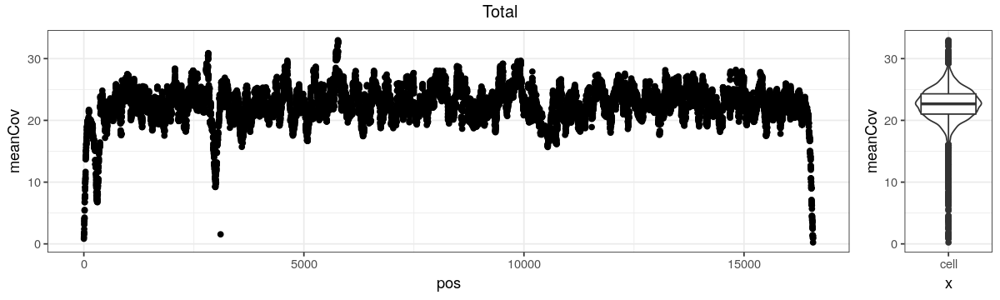

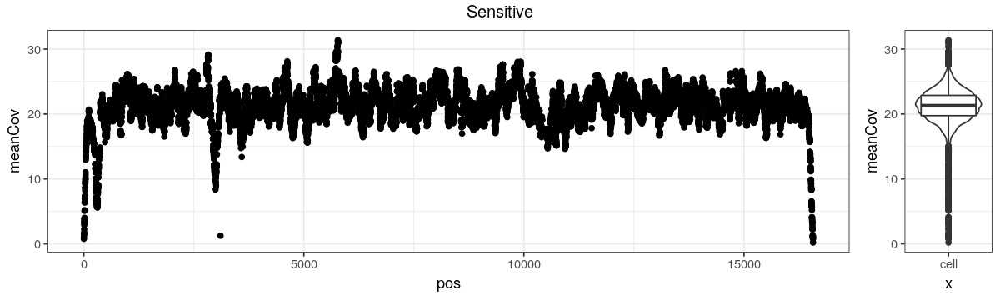

In [36]:
plot_depth(DN9_BMMC.depth$Total,"Total")
plot_depth(DN9_BMMC.depth$Sensitive,"Sensitive")

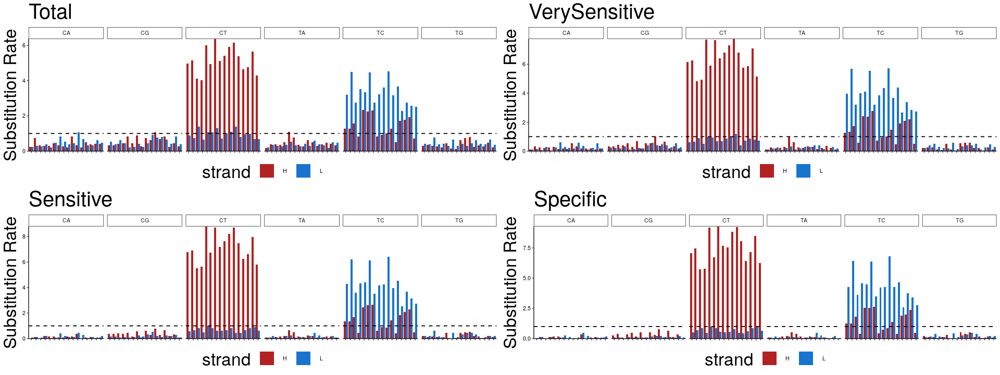

In [37]:
options(repr.plot.width=16, repr.plot.height=6)
ps<-list()
for(name in names(DN9_BMMC.Variants.feature.lst)){
p<-MutationProfile.bulk(DN9_BMMC.Variants.feature.lst[[name]]$Variants)+ggtitle(name)+theme(title =element_text(size=20))
ps<-c(ps,list(p))
}
grid.arrange(grobs=ps)

Warning message:
“Removed 698 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 127 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


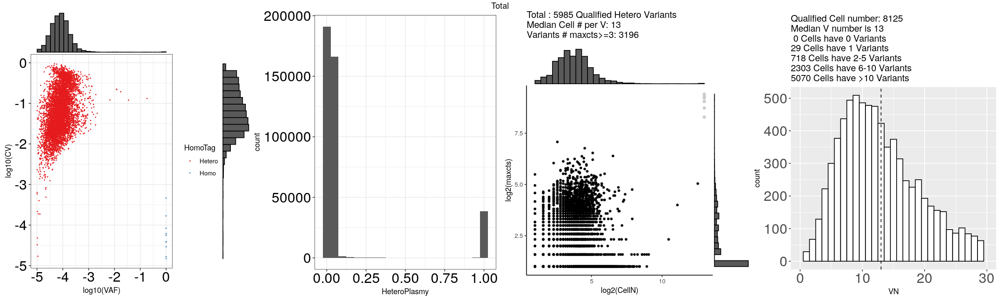

Warning message:
“Removed 38 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”


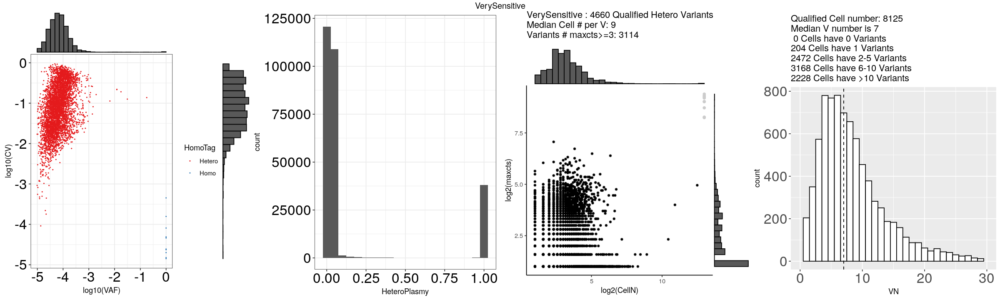

Warning message:
“Removed 11 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


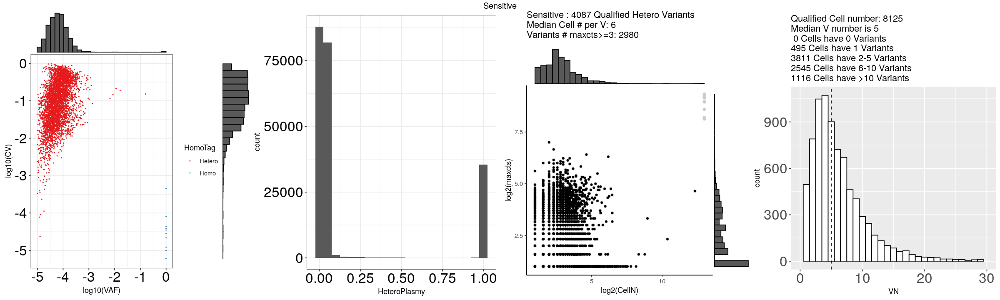

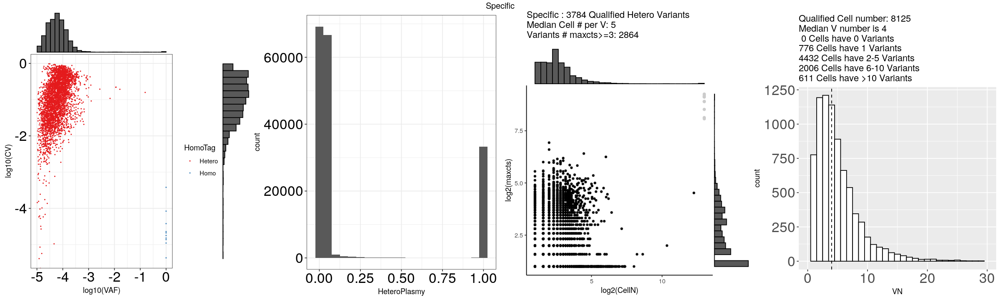

In [38]:
plot_variant(DN9_BMMC.VariantsGTSummary,DN9_BMMC.Variants.feature.lst,depth=DN9_BMMC.depth,cat=c("Total","VerySensitive","Sensitive","Specific"),p4xlim = 30)

## DN9_HPC

### Fast load

In [27]:
## Fast load
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HPC/MTenrichCombine/mitoV/final"
DN9_HPC.depth<-readRDS(paste(WD,"/DN9_HPC.depth",sep=""))
DN9_HPC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN9_HPC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_HPC.VariantsGTSummary,depth=DN9_HPC.depth)

[1] "Total :\n 48603 variants to start"
[1] "48556 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 7140 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 46615 variants to start"
[1] "46525 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5735 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 43003 variants to start"
[1] "42867 variants after remove low quality cel

### Processing

In [25]:
## Sequencing depth (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HPC/MTenrichCombine/mitoV/final"
DN9_HPC.depth<-DepthSummary(WD,CellSubset = NA,cellSubSetName = NA) ## Note, recommend to save out as RDS  
saveRDS(DN9_HPC.depth,paste(WD,"/DN9_HPC.depth",sep=""))

[1] "Use all cells"
[1] "10945 Cells in QualifiedTotalCts"


In [26]:
## Genotype and variant feature (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HPC/MTenrichCombine/mitoV/final"
DN9_HPC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =F)
DN9_HPC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_HPC.VariantsGTSummary,depth=DN9_HPC.depth)

[1] "Total :\n 48603 variants to start"
[1] "48556 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 7140 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 46615 variants to start"
[1] "46525 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5735 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 43003 variants to start"
[1] "42867 variants after remove low quality cel

### Basic plotting

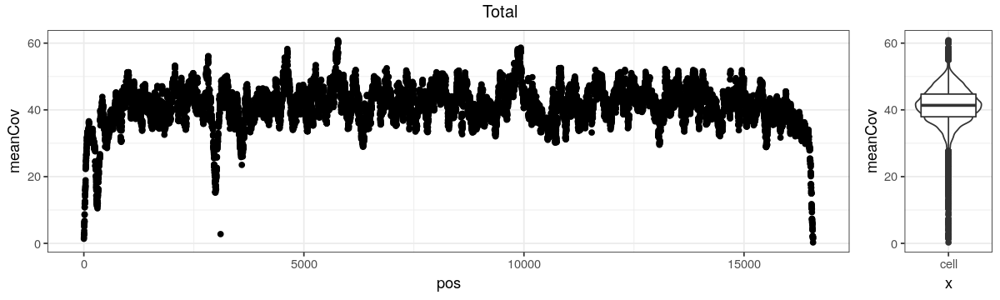

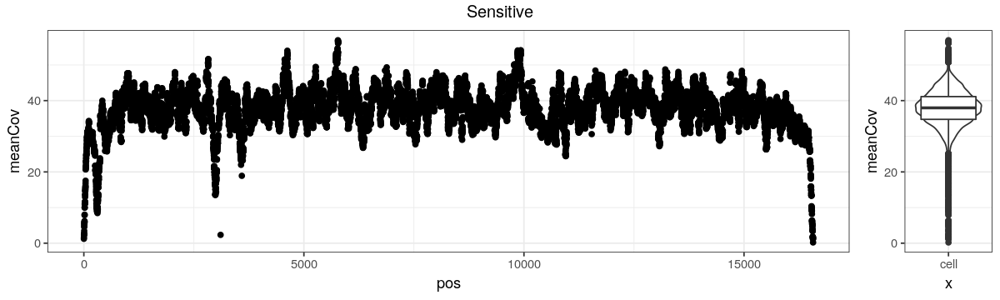

In [40]:
plot_depth(DN9_HPC.depth$Total,"Total")
plot_depth(DN9_HPC.depth$Sensitive,"Sensitive")

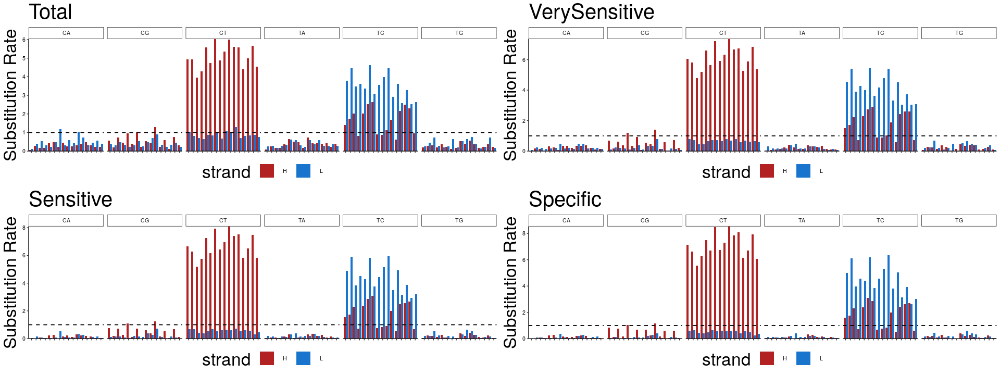

In [41]:
options(repr.plot.width=16, repr.plot.height=6)
ps<-list()
for(name in names(DN9_HPC.Variants.feature.lst)){
p<-MutationProfile.bulk(DN9_HPC.Variants.feature.lst[[name]]$Variants)+ggtitle(name)+theme(title =element_text(size=20))
ps<-c(ps,list(p))
}
grid.arrange(grobs=ps)

Warning message:
“Removed 2799 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 478 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


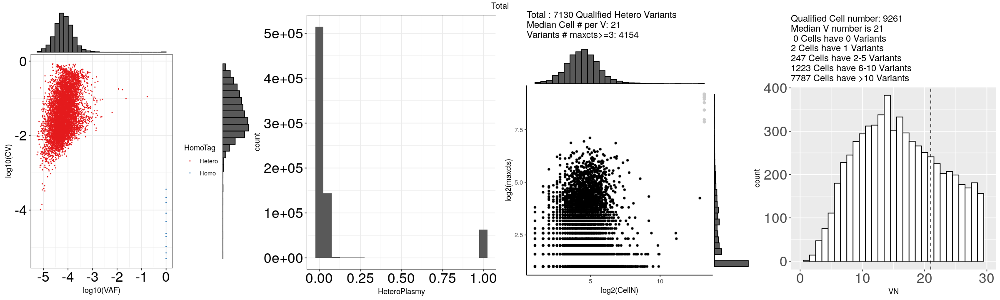

Warning message:
“Removed 118 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


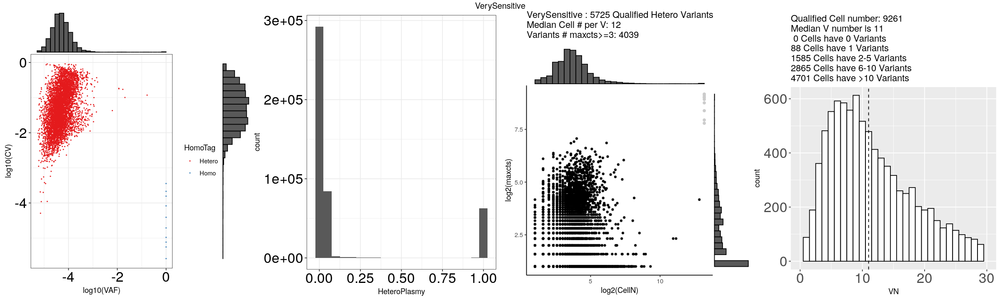

Warning message:
“Removed 16 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


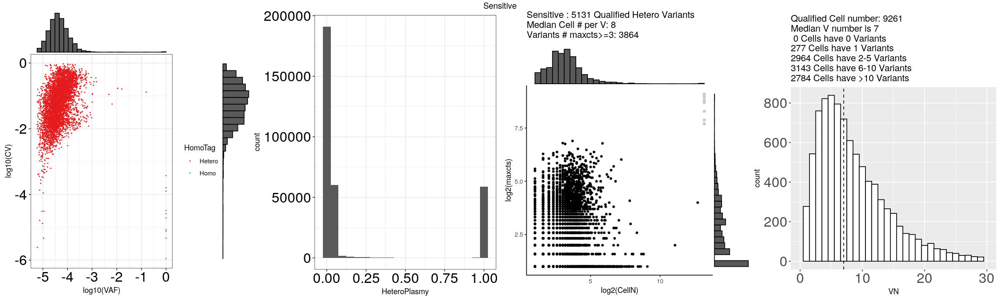

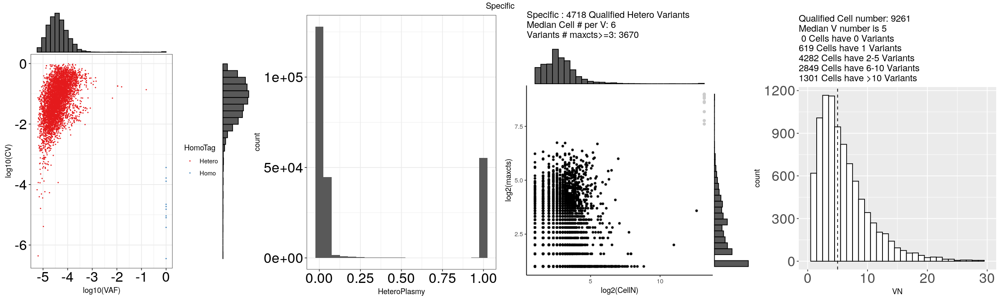

In [42]:
plot_variant(DN9_HPC.VariantsGTSummary,DN9_HPC.Variants.feature.lst,depth=DN9_HPC.depth,cat=c("Total","VerySensitive","Sensitive","Specific"),p4xlim = 30)

In [117]:
DN9_HPC.VariantsGTSummary$Sensitive %>% head

,Var1,Cell,Variants,Freq,depth,Type,Context,hetero
,<fct>,<chr>,<chr>,<int>,<dbl>,<chr>,<chr>,<dbl>
1,AAACAAGCAAGGCTGT_10195_C_T,AAACAAGCAAGGCTGT,10195_C_T,1,42,C_T,CCC,0.02380952
2,AAACAAGCAAGGCTGT_11016_G_A,AAACAAGCAAGGCTGT,11016_G_A,1,35,G_A,TCA,0.02857143
3,AAACAAGCAAGGCTGT_11510_A_G,AAACAAGCAAGGCTGT,11510_A_G,1,29,A_G,GTT,0.03448276
4,AAACAAGCAAGGCTGT_13738_A_C,AAACAAGCAAGGCTGT,13738_A_C,1,31,A_C,GTA,0.03225806
5,AAACAAGCAAGGCTGT_13740_T_G,AAACAAGCAAGGCTGT,13740_T_G,1,31,T_G,TTA,0.03225806
6,AAACAAGCAAGGCTGT_14130_C_T,AAACAAGCAAGGCTGT,14130_C_T,1,36,C_T,CCC,0.02777778


## DN9_HSC

### Fast load

In [30]:
## Fast load
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HSC/MTenrichCombine/mitoV/final"
DN9_HSC.depth<-readRDS(paste(WD,"/DN9_HSC.depth",sep=""))
DN9_HSC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN9_HSC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_HSC.VariantsGTSummary,depth=DN9_HSC.depth)

[1] "Total :\n 48823 variants to start"
[1] "48797 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 7449 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 47029 variants to start"
[1] "46967 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5953 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 43222 variants to start"
[1] "43114 variants after remove low quality cel

### Processing

In [28]:
## Sequencing depth (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HSC/MTenrichCombine/mitoV/final"
DN9_HSC.depth<-DepthSummary(WD,CellSubset = NA,cellSubSetName = NA) ## Note, recommend to save out as RDS  
# saveRDS(DN9_HSC.depth,paste(WD,"/DN9_HSC.depth",sep=""))

[1] "Use all cells"
[1] "12169 Cells in QualifiedTotalCts"


In [29]:
## Genotype and variant feature (Processed 1/24/22, skip)
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HSC/MTenrichCombine/mitoV/final"
DN9_HSC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =F)
DN9_HSC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_HSC.VariantsGTSummary,depth=DN9_HSC.depth)

[1] "Total :\n 48823 variants to start"
[1] "48797 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 7449 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 47029 variants to start"
[1] "46967 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5953 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 43222 variants to start"
[1] "43114 variants after remove low quality cel

### Basic plotting

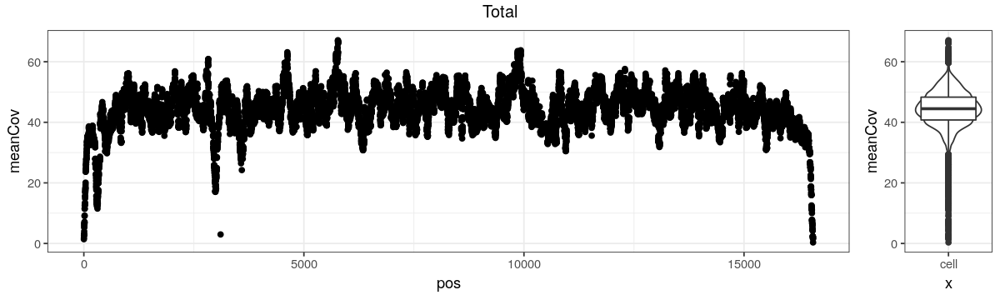

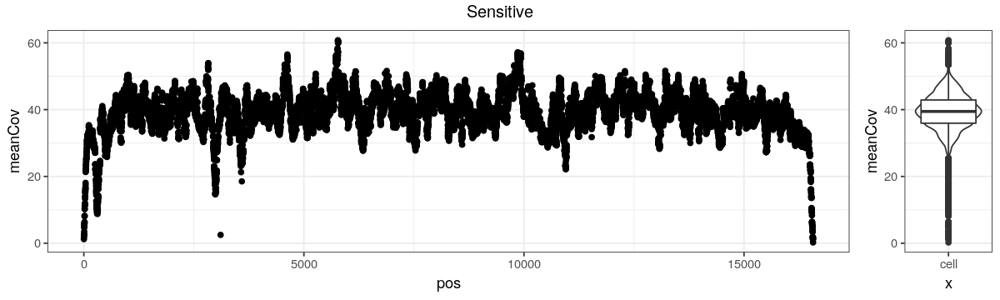

In [43]:
plot_depth(DN9_HSC.depth$Total,"Total")
plot_depth(DN9_HSC.depth$Sensitive,"Sensitive")

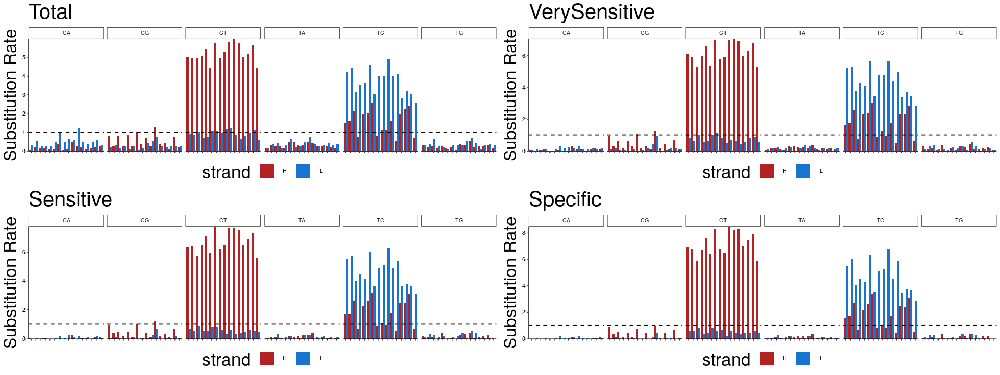

In [44]:
options(repr.plot.width=16, repr.plot.height=6)
ps<-list()
for(name in names(DN9_HSC.Variants.feature.lst)){
p<-MutationProfile.bulk(DN9_HSC.Variants.feature.lst[[name]]$Variants)+ggtitle(name)+theme(title =element_text(size=20))
ps<-c(ps,list(p))
}
grid.arrange(grobs=ps)

Warning message:
“Removed 3510 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 398 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”
Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”


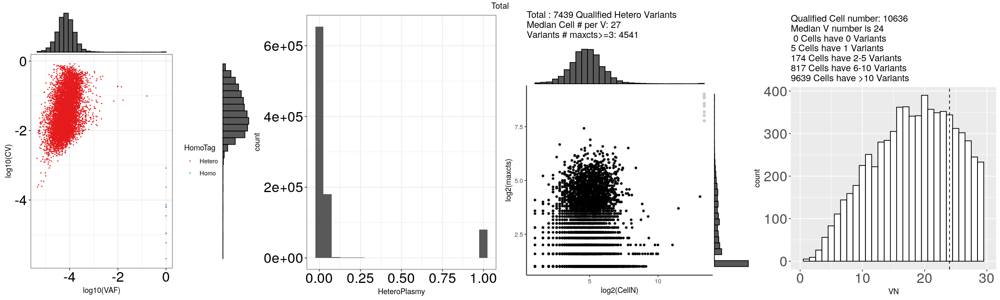

Warning message:
“Removed 59 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


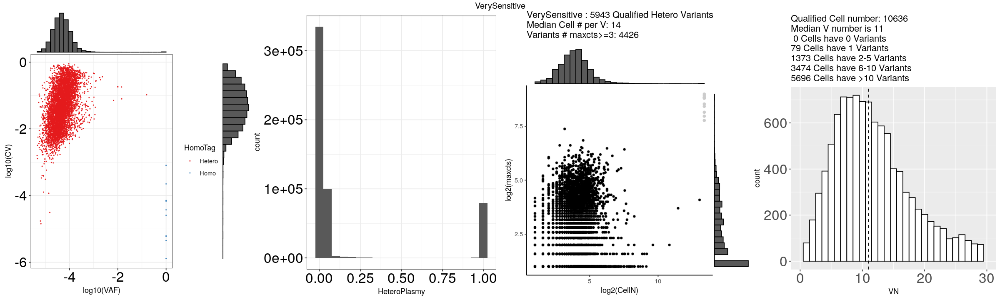

Warning message:
“Removed 4 rows containing non-finite values (stat_bin).”
Warning message:
“Removed 2 rows containing missing values (geom_bar).”


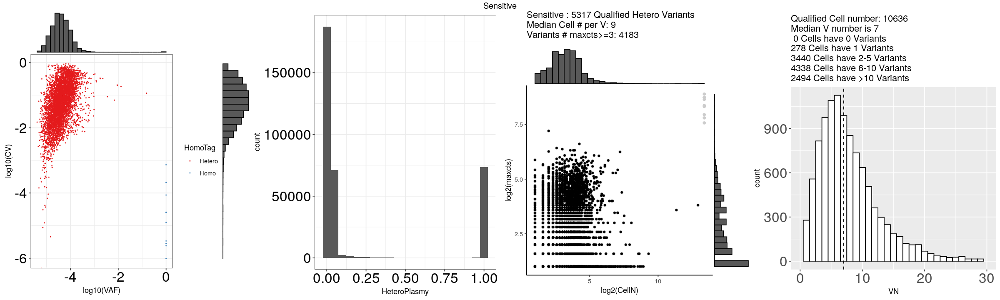

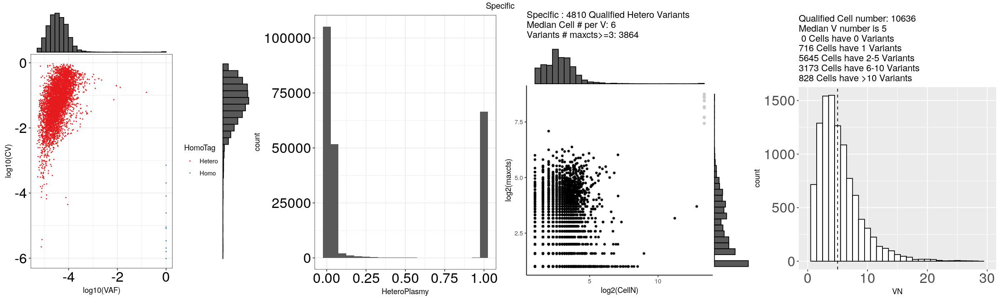

In [45]:
plot_variant(DN9_HSC.VariantsGTSummary,DN9_HSC.Variants.feature.lst,depth=DN9_HSC.depth,cat=c("Total","VerySensitive","Sensitive","Specific"),p4xlim = 30)

ERROR: Error in eval(expr, envir, enclos): lazy-load database '/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/renv/library/R-4.1/x86_64-pc-linux-gnu/scMitoTracing/R/scMitoTracing.rdb' is corrupt


# Basic Clustering

## DN4_BMMC

In [46]:
Donor04_BMMC_Multiome_wrapper<-Multi_Wrapper(path="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_BMMC/CellRanger/DN4_BMMC/outs/")

Loading required package: Seurat

Attaching SeuratObject

Loading required package: Signac

Loading required package: EnsDb.Hsapiens.v86

Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:gridExtra’:

    combine


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, tapply,
    union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: S4Vectors


Attaching package: ‘S4Vecto

## DN4_HPC

In [48]:
Donor04_HPC_Multiome_wrapper<-Multi_Wrapper(path="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HPC/CellRanger/DN4_HPC/outs/")

Warning message in sparseMatrix(i = indices[] + 1, p = indptr[], x = as.numeric(x = counts[]), :
"'giveCsparse' has been deprecated; setting 'repr = "T"' for you"
Genome matrix has multiple modalities, returning a list of matrices for this genome

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Do

## DN4_HSC

In [53]:
Donor04_HSC_Multiome_wrapper<-Multi_Wrapper(path="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HSC/CellRanger/DN4_HSC/outs/")

Warning message in sparseMatrix(i = indices[] + 1, p = indptr[], x = as.numeric(x = counts[]), :
"'giveCsparse' has been deprecated; setting 'repr = "T"' for you"
Genome matrix has multiple modalities, returning a list of matrices for this genome

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Do

## DN9_BMMC

In [56]:
Donor09_BMMC_Multiome_wrapper<-Multi_Wrapper(path="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_BMMC/CellRanger/DN9_BMMC/outs/")

Warning message in sparseMatrix(i = indices[] + 1, p = indptr[], x = as.numeric(x = counts[]), :
"'giveCsparse' has been deprecated; setting 'repr = "T"' for you"
Genome matrix has multiple modalities, returning a list of matrices for this genome

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Do

## DN9_HPC

In [57]:
Donor09_HPC_Multiome_wrapper<-Multi_Wrapper(path="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HPC/CellRanger/DN9_HPC/outs/")

Warning message in sparseMatrix(i = indices[] + 1, p = indptr[], x = as.numeric(x = counts[]), :
"'giveCsparse' has been deprecated; setting 'repr = "T"' for you"
Genome matrix has multiple modalities, returning a list of matrices for this genome

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Do

## DN9_HSC

In [58]:
Donor09_HSC_Multiome_wrapper<-Multi_Wrapper(path="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HSC/CellRanger/DN9_HSC/outs/")

Warning message in sparseMatrix(i = indices[] + 1, p = indptr[], x = as.numeric(x = counts[]), :
"'giveCsparse' has been deprecated; setting 'repr = "T"' for you"
Genome matrix has multiple modalities, returning a list of matrices for this genome

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Done

Fetching data...
OK

Parsing exons...
OK
Defining introns...
OK
Defining UTRs...
OK
Defining CDS...
OK

aggregating...

Do

## Save RDS

In [50]:
#saveRDS(Donor04_BMMC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_BMMC_Multiome_wrapper.rds")

In [62]:
#saveRDS(Donor04_HPC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HPC_Multiome_wrapper.rds")

In [63]:
#saveRDS(Donor04_HSC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HSC_Multiome_wrapper.rds")

In [59]:
#saveRDS(Donor09_BMMC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_BMMC_Multiome_wrapper.rds")

In [60]:
#saveRDS(Donor09_HPC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_HPC_Multiome_wrapper.rds")

In [61]:
#saveRDS(Donor09_HSC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_HSC_Multiome_wrapper.rds")

In [309]:
## 
Donor04_BMMC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_BMMC_Multiome_wrapper.rds")

In [303]:
Donor09_BMMC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_BMMC_Multiome_wrapper.rds")

In [307]:
DN4.bmmc.anno_peterV<-Donor04_BMMC_Multiome_wrapper$seurat@meta.data %>% .[,"CellType",drop=F]
DN9.bmmc.anno_peterV<-Donor09_BMMC_Multiome_wrapper$seurat@meta.data %>% .[,"CellType",drop=F]

In [308]:
write.table(DN4.bmmc.anno_peterV,"/lab/solexa_weissman/cweng/Projects/Collaborator/PeterV/DN4.bmmc.anno_peterV.txt",sep="\t",quote=F,col.names = F)
write.table(DN9.bmmc.anno_peterV,"/lab/solexa_weissman/cweng/Projects/Collaborator/PeterV/DN9.bmmc.anno_peterV.txt",sep="\t",quote=F,col.names = F)

In [304]:
library(dplyr)

In [316]:
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(Donor04_BMMC_Multiome_wrapper$seurat, features ="TRB",pt.size = 0.5)

ERROR: Error: None of the requested features were found: TRB in slot data


# Combine object for reclustering 

In [1503]:
Donor04_BMMC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_BMMC_Multiome_wrapper.rds")
Donor04_HPC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HPC_Multiome_wrapper.rds")
Donor04_HSC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HSC_Multiome_wrapper.rds")

In [1517]:
Donor4_HSC_HPC_BMMC.RNA.Mtx<-MergeMtx(list(Donor04_BMMC_Multiome_wrapper$seurat@assays$RNA@counts,Donor04_HPC_Multiome_wrapper$seurat@assays$RNA@counts,Donor04_HSC_Multiome_wrapper$seurat@assays$RNA@counts),c(3,2,1))
Donor4_HSC_HPC_BMMC.ATAC.Mtx<-MergeMtx(list(Donor04_BMMC_Multiome_wrapper$seurat@assays$ATAC@counts,Donor04_HPC_Multiome_wrapper$seurat@assays$ATAC@counts,Donor04_HSC_Multiome_wrapper$seurat@assays$ATAC@counts),c(3,2,1))

In [1688]:
# Donor04_BMMC_Multiome_wrapper$seurat@assays$ATAC@counts %>% head

# Single-cell basic plotting

## DN4_BMMC

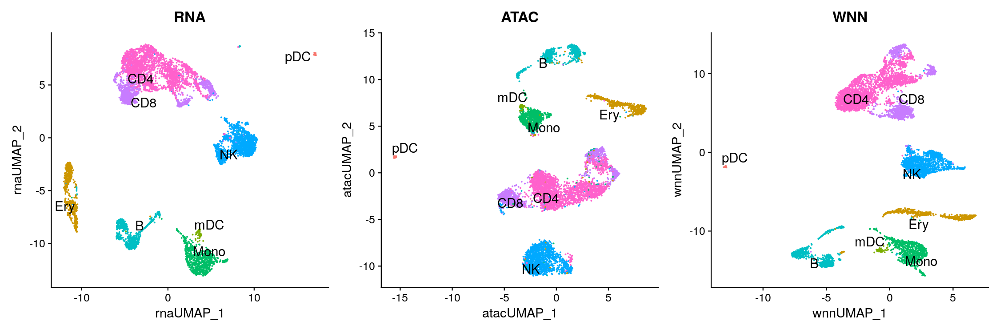

In [153]:
options(repr.plot.width=15, repr.plot.height=5,repr.plot.res=150)
p1 <- DimPlot(Donor04_BMMC_Multiome_wrapper$seurat, reduction = "umap.rna",  label = T, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(Donor04_BMMC_Multiome_wrapper$seurat, reduction = "umap.atac",  label = T, label.size = 5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(Donor04_BMMC_Multiome_wrapper$seurat, reduction = "wnn.umap", label = T, label.size = 5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
"The following requested variables were not found: CD20"


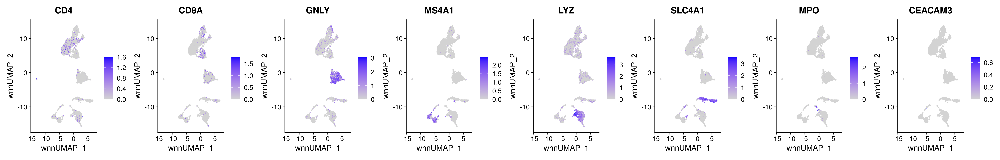

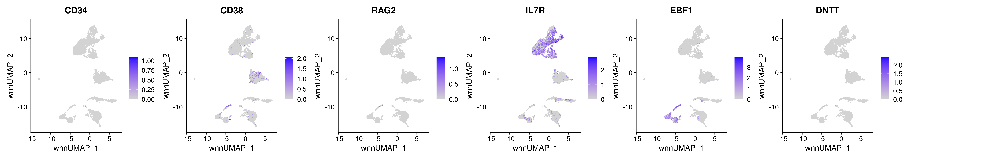

In [142]:
options(repr.plot.width=25, repr.plot.height=4)
DefaultAssay(Donor04_BMMC_Multiome_wrapper$seurat)<-"SCT"
FeaturePlot(Donor04_BMMC_Multiome_wrapper$seurat, features = c("CD4","CD8A","GNLY","MS4A1","LYZ","SLC4A1","MPO","CEACAM3"),reduction = 'wnn.umap',ncol=8)
FeaturePlot(Donor04_BMMC_Multiome_wrapper$seurat, features = c("CD34","CD20","CD38","RAG2","IL7R","EBF1","DNTT"),reduction = 'wnn.umap',ncol=7)

### Identify markers

In [119]:
Donor04_BMMC_markers <- FindAllMarkers(Donor04_BMMC_Multiome_wrapper$seurat, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

For a more efficient implementation of the Wilcoxon Rank Sum Test,
(default method for FindMarkers) please install the limma package
--------------------------------------------
install.packages('BiocManager')
BiocManager::install('limma')
--------------------------------------------
After installation of limma, Seurat will automatically use the more 
efficient implementation (no further action necessary).
This message will be shown once per session

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18



In [143]:
#subset(Donor04_BMMC_markers,cluster==2)
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '0'='CD4', '4'='CD4', '5'='CD4', '13'='CD4')
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '3'='CD8', '14'='CD8', '10'='CD8')
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '1'='NK', '11'='NK', '12'='NK')
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '7'='B', '8'='B', '15'='B')
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '2'='Mono', '17'='Mono')
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '16'='mDC')
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '6'='Ery', '9'='Ery')
Donor04_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor04_BMMC_Multiome_wrapper$seurat, '18'='pDC')


In [145]:
Donor04_BMMC_Multiome_wrapper$seurat@meta.data$CellType<-Idents(Donor04_BMMC_Multiome_wrapper$seurat)

## DN4_HPC

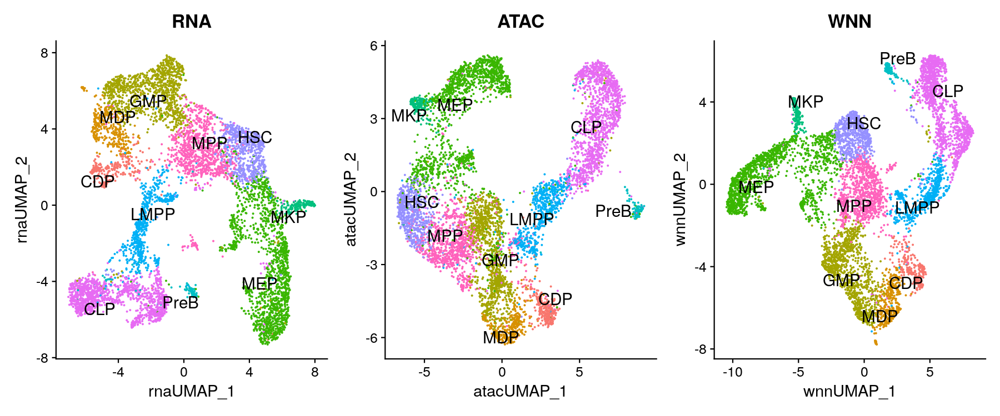

In [182]:
options(repr.plot.width=12, repr.plot.height=5,repr.plot.res=150)
p1 <- DimPlot(Donor04_HPC_Multiome_wrapper$seurat, reduction = "umap.rna",  label = T, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(Donor04_HPC_Multiome_wrapper$seurat, reduction = "umap.atac",  label = T, label.size = 5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(Donor04_HPC_Multiome_wrapper$seurat, reduction = "wnn.umap", label = T, label.size = 5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
"The following requested variables were not found: IGH"


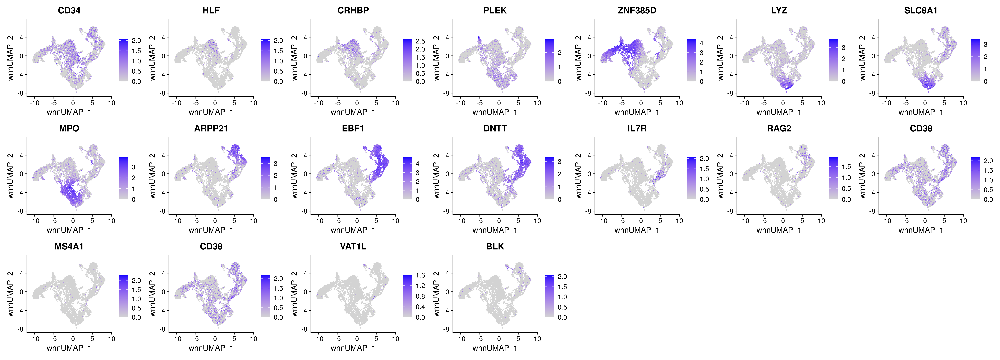

In [178]:
options(repr.plot.width=25, repr.plot.height=9)
DefaultAssay(Donor04_HPC_Multiome_wrapper$seurat)<-"SCT"
FeaturePlot(Donor04_HPC_Multiome_wrapper$seurat, features = c("CD34","HLF","CRHBP","PLEK","ZNF385D","LYZ","SLC8A1","MPO","ARPP21","EBF1","DNTT","IL7R","RAG2","CD38","MS4A1","CD38","IGH","VAT1L","BLK"),reduction = 'wnn.umap',ncol=7)

### Identify markers

In [155]:
Donor04_HPC_markers <- FindAllMarkers(Donor04_HPC_Multiome_wrapper$seurat, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16



In [179]:
#subset(Donor04_HPC_markers,cluster==15)
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '0'='MPP', '13'='MPP')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '1'='CLP', '3'='CLP')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '2'='HSC')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '6'='LMPP', '14'='LMPP')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '15'='PreB')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '12'='MKP')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '8'='MEP', '5'='MEP','9'='MEP', '16'='MEP')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '4'='GMP','7'='GMP')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '10'='MDP')
Donor04_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HPC_Multiome_wrapper$seurat, '11'='CDP')


In [180]:
Donor04_HPC_Multiome_wrapper$seurat@meta.data$CellType<-Idents(Donor04_HPC_Multiome_wrapper$seurat)

## DN4_HSC

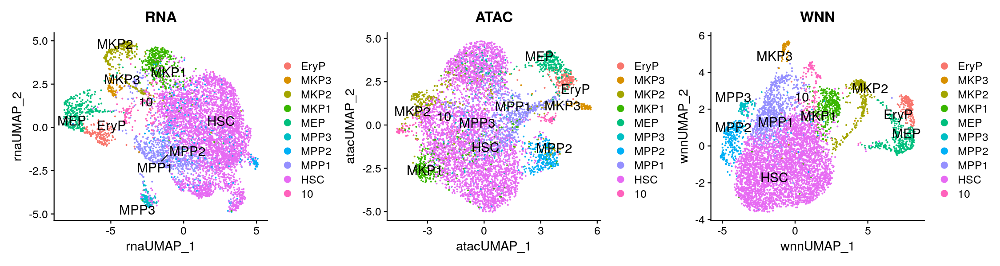

In [214]:
options(repr.plot.width=15, repr.plot.height=4,repr.plot.res=150)
p1 <- DimPlot(Donor04_HSC_Multiome_wrapper$seurat, reduction = "umap.rna",  label = T, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(Donor04_HSC_Multiome_wrapper$seurat, reduction = "umap.atac",  label = T, label.size =5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(Donor04_HSC_Multiome_wrapper$seurat, reduction = "wnn.umap", label = T, label.size = 5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & theme(plot.title = element_text(hjust = 0.5))

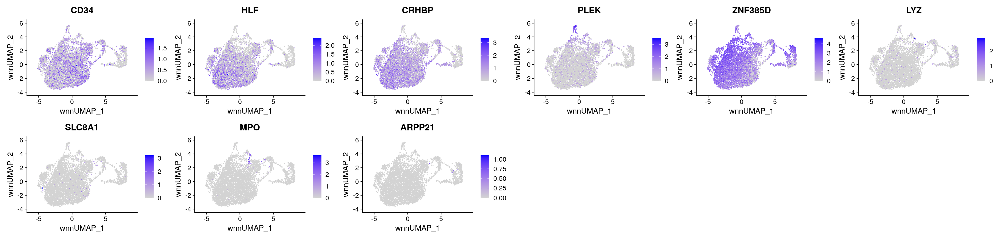

Warning message:
"Could not find HOXB9 in the default search locations, found in RNA assay instead"
Warning message in FeaturePlot(Donor04_HSC_Multiome_wrapper$seurat, features = c("HOXB5", :
"All cells have the same value (0) of rna_HOXB9."


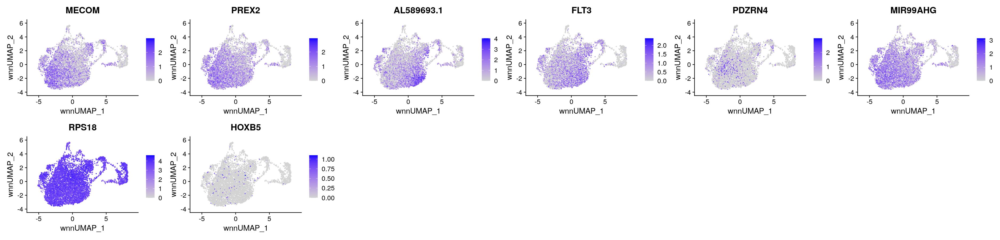

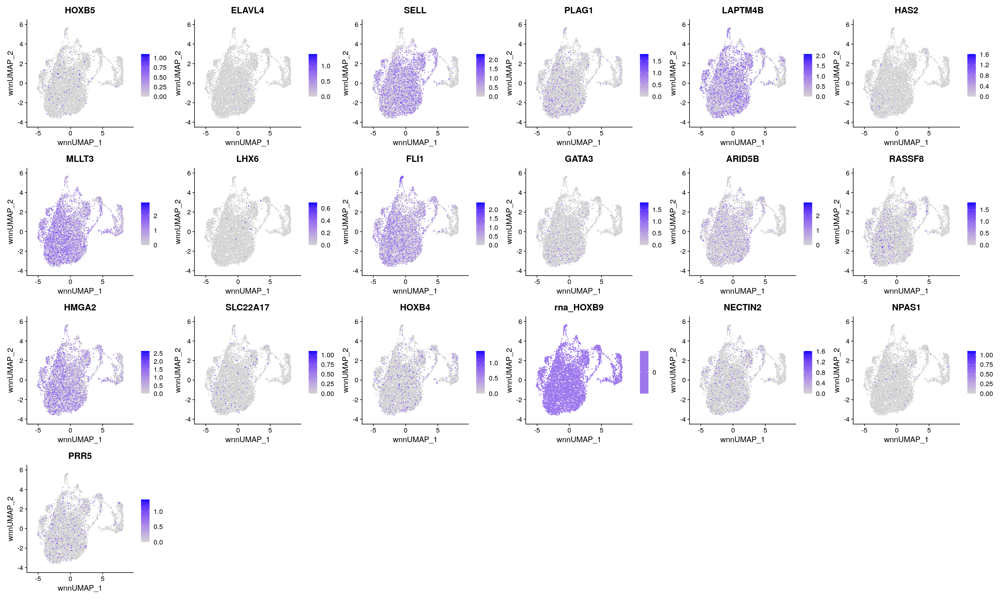

In [230]:
options(repr.plot.width=25, repr.plot.height=6)
DefaultAssay(Donor04_HSC_Multiome_wrapper$seurat)<-"SCT"
FeaturePlot(Donor04_HSC_Multiome_wrapper$seurat, features = c("CD34","HLF","CRHBP","PLEK","ZNF385D","LYZ","SLC8A1","MPO","ARPP21"),reduction = 'wnn.umap',ncol=6)
FeaturePlot(Donor04_HSC_Multiome_wrapper$seurat, features = c("MECOM","PREX2","AL589693.1","FLT3","PDZRN4","MIR99AHG","RPS18","HOXB5"),reduction = 'wnn.umap',ncol=6)
options(repr.plot.width=25, repr.plot.height=15)
FeaturePlot(Donor04_HSC_Multiome_wrapper$seurat, features = c("HOXB5","ELAVL4","SELL","PLAG1","LAPTM4B","HAS2","MLLT3","LHX6","FLI1","GATA3","ARID5B","RASSF8","HMGA2","SLC22A17","HOXB4","HOXB9","NECTIN2","NPAS1","PRR5"),reduction = 'wnn.umap',ncol=6)

### Identify markers

In [186]:
Donor04_HSC_markers <- FindAllMarkers(Donor04_HSC_Multiome_wrapper$seurat, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12



In [211]:
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '0'='HSC', '1'='HSC', '2'='HSC', '4'='HSC')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '3'='MPP1')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '7'='MPP2')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '11'='MPP3')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '6'='MEP')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '5'='MKP1')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '8'='MKP2')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '12'='MKP3')
Donor04_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor04_HSC_Multiome_wrapper$seurat, '9'='EryP')


In [212]:
Donor04_HSC_Multiome_wrapper$seurat@meta.data$CellType<-Idents(Donor04_HSC_Multiome_wrapper$seurat)

## DN9_BMMC

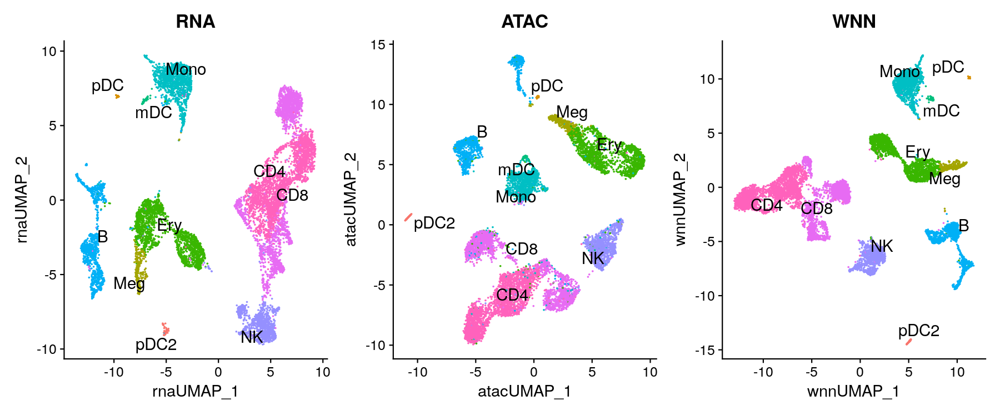

In [300]:
options(repr.plot.width=12, repr.plot.height=5,repr.plot.res=150)
p1 <- DimPlot(Donor09_BMMC_Multiome_wrapper$seurat, reduction = "umap.rna",  label = T, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(Donor09_BMMC_Multiome_wrapper$seurat, reduction = "umap.atac",  label = T, label.size = 5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(Donor09_BMMC_Multiome_wrapper$seurat, reduction = "wnn.umap", label = T, label.size = 5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

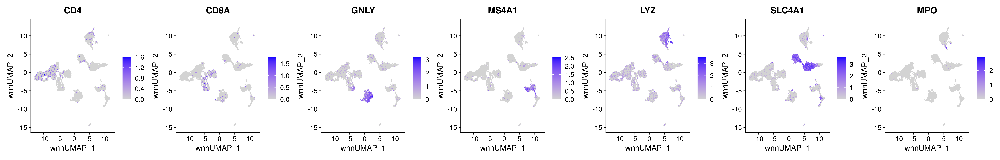

In [242]:
options(repr.plot.width=25, repr.plot.height=4)
DefaultAssay(Donor09_BMMC_Multiome_wrapper$seurat)<-"SCT"
FeaturePlot(Donor09_BMMC_Multiome_wrapper$seurat, features = c("CD4","CD8A","GNLY","MS4A1","LYZ","SLC4A1","MPO"),reduction = 'wnn.umap',ncol=7)

### Identify markers

In [233]:
Donor09_BMMC_markers <- FindAllMarkers(Donor09_BMMC_Multiome_wrapper$seurat, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20



In [249]:
#subset(Donor09_BMMC_markers,cluster==2)
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '0'='CD4', '3'='CD4', '16'='CD4')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '2'='CD8', '7'='CD8', '10'='CD8','13'='CD8')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '6'='NK', '14'='NK', '15'='NK')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '8'='B', '9'='B', '11'='B')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '1'='Mono', '19'='Mono')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '18'='mDC')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '4'='Ery', '5'='Ery')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '12'='Meg')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '20'='pDC')
Donor09_BMMC_Multiome_wrapper$seurat<-RenameIdents(Donor09_BMMC_Multiome_wrapper$seurat, '17'='pDC2')

In [250]:
Donor09_BMMC_Multiome_wrapper$seurat@meta.data$CellType<-Idents(Donor09_BMMC_Multiome_wrapper$seurat)

## DN9_HPC

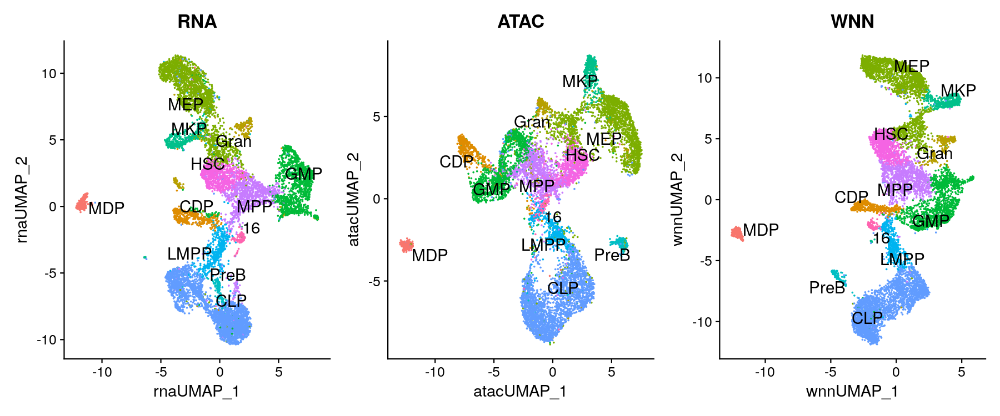

In [275]:
options(repr.plot.width=12, repr.plot.height=5,repr.plot.res=150)
p1 <- DimPlot(Donor09_HPC_Multiome_wrapper$seurat, reduction = "umap.rna",  label = T, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(Donor09_HPC_Multiome_wrapper$seurat, reduction = "umap.atac",  label = T, label.size = 5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(Donor09_HPC_Multiome_wrapper$seurat, reduction = "wnn.umap", label = T, label.size = 5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

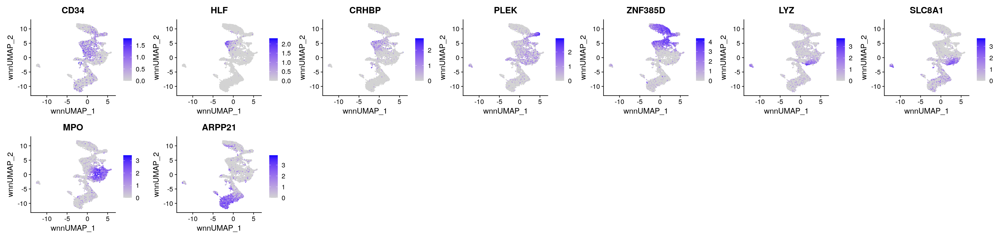

In [253]:
options(repr.plot.width=25, repr.plot.height=6)
DefaultAssay(Donor09_HPC_Multiome_wrapper$seurat)<-"SCT"
FeaturePlot(Donor09_HPC_Multiome_wrapper$seurat, features = c("CD34","HLF","CRHBP","PLEK","ZNF385D","LYZ","SLC8A1","MPO","ARPP21"),reduction = 'wnn.umap',ncol=7)

### Identify markers

In [254]:
Donor09_HPC_markers <- FindAllMarkers(Donor09_HPC_Multiome_wrapper$seurat, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17



In [272]:
#subset(Donor09_BMMC_markers,cluster==2)
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '4'='HSC')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '5'='MPP', '13'='MPP')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '0'='CLP', "1"='CLP')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '7'='LMPP')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '15'='PreB')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '11'='MKP')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '3'='GMP', '9'='GMP')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '8'='MEP','2'='MEP','6'='MEP')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '14'='Gran','17'='Gran')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '10'='CDP')
Donor09_HPC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HPC_Multiome_wrapper$seurat, '12'='MDP')


In [273]:
Donor09_HPC_Multiome_wrapper$seurat@meta.data$CellType<-Idents(Donor09_HPC_Multiome_wrapper$seurat)

## DN4_HSC

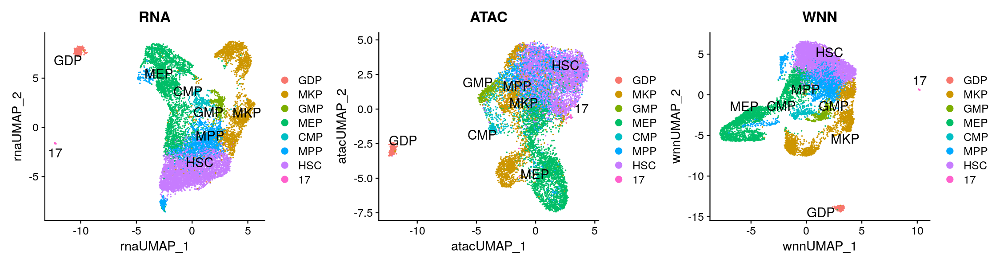

In [301]:
options(repr.plot.width=15, repr.plot.height=4,repr.plot.res=150)
p1 <- DimPlot(Donor09_HSC_Multiome_wrapper$seurat, reduction = "umap.rna",  label = T, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(Donor09_HSC_Multiome_wrapper$seurat, reduction = "umap.atac",  label = T, label.size =5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(Donor09_HSC_Multiome_wrapper$seurat, reduction = "wnn.umap", label = T, label.size = 5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & theme(plot.title = element_text(hjust = 0.5))

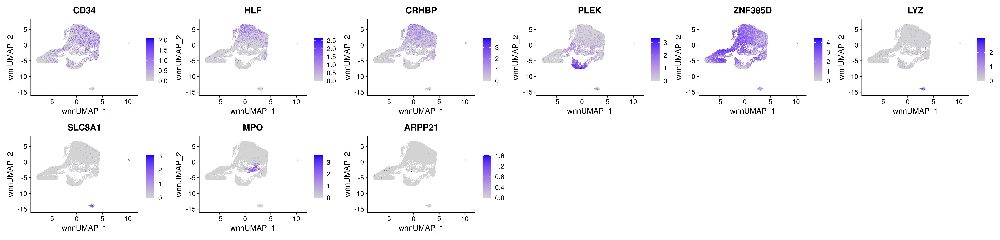

In [277]:
options(repr.plot.width=25, repr.plot.height=6)
DefaultAssay(Donor09_HSC_Multiome_wrapper$seurat)<-"SCT"
FeaturePlot(Donor09_HSC_Multiome_wrapper$seurat, features = c("CD34","HLF","CRHBP","PLEK","ZNF385D","LYZ","SLC8A1","MPO","ARPP21"),reduction = 'wnn.umap',ncol=6)

### Identify markers

In [278]:
Donor09_HSC_markers <- FindAllMarkers(Donor09_HSC_Multiome_wrapper$seurat, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17



In [297]:
#subset(Donor09_BMMC_markers,cluster==2)
Donor09_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HSC_Multiome_wrapper$seurat, '0'='HSC','2'='HSC','16'='HSC')
Donor09_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HSC_Multiome_wrapper$seurat, '1'='MPP', '13'='MPP','14'='MPP','15'='MPP')
Donor09_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HSC_Multiome_wrapper$seurat, '11'='CMP')
Donor09_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HSC_Multiome_wrapper$seurat, '3'='MEP','4'='MEP','5'='MEP')
Donor09_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HSC_Multiome_wrapper$seurat, '9'='GMP')
Donor09_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HSC_Multiome_wrapper$seurat, '6'='MKP', '7'='MKP','8'='MKP','10'='MKP')
Donor09_HSC_Multiome_wrapper$seurat<-RenameIdents(Donor09_HSC_Multiome_wrapper$seurat, '12'='GDP')

In [298]:
Donor09_HSC_Multiome_wrapper$seurat@meta.data$CellType<-Idents(Donor09_HSC_Multiome_wrapper$seurat)

# Save Seurat rds after annotations

In [183]:
#saveRDS(Donor04_BMMC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_BMMC_Multiome_wrapper.rds")

In [184]:
#saveRDS(Donor04_HPC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HPC_Multiome_wrapper.rds")

In [231]:
#saveRDS(Donor04_HSC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HSC_Multiome_wrapper.rds")

In [302]:
#saveRDS(Donor09_BMMC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_BMMC_Multiome_wrapper.rds")

In [303]:
#saveRDS(Donor09_HPC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_HPC_Multiome_wrapper.rds")

In [304]:
#Donor09_HSC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_HSC_Multiome_wrapper.rds")
#saveRDS(Donor09_HSC_Multiome_wrapper,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_HSC_Multiome_wrapper.rds")

# Mutation analysis across samples DN4, DN9, DN1, NK, AML

---
## Load mito variant 
- First, load all needed mito variant metrics

In [4]:
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_BMMC/MTenrichCombine/mitoV/final"
DN4_BMMC.depth<-readRDS(paste(WD,"/DN4_BMMC.depth",sep=""))
DN4_BMMC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN4_BMMC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_BMMC.VariantsGTSummary,depth=DN4_BMMC.depth)


WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HPC/MTenrichCombine/mitoV/final"
DN4_HPC.depth<-readRDS(paste(WD,"/DN4_HPC.depth",sep=""))
DN4_HPC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN4_HPC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_HPC.VariantsGTSummary,depth=DN4_HPC.depth)

WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_HSC/MTenrichCombine/mitoV/final"
DN4_HSC.depth<-readRDS(paste(WD,"/DN4_HSC.depth",sep=""))
DN4_HSC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN4_HSC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN4_HSC.VariantsGTSummary,depth=DN4_HSC.depth)

[1] "Total :\n 47320 variants to start"
[1] "47138 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 11674_C_T" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 11947_A_G" "Tag Homoplasmy: 12414_T_C"
 [5] "Tag Homoplasmy: 1243_T_C"  "Tag Homoplasmy: 12705_C_T"
 [7] "Tag Homoplasmy: 12923_G_T" "Tag Homoplasmy: 1406_T_C" 
 [9] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
[11] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 15884_G_C"
[13] "Tag Homoplasmy: 16223_C_T" "Tag Homoplasmy: 16292_C_T"
[15] "Tag Homoplasmy: 16519_T_C" "Tag Homoplasmy: 194_C_T"  
[17] "Tag Homoplasmy: 195_T_C"   "Tag Homoplasmy: 199_T_C"  
[19] "Tag Homoplasmy: 204_T_C"   "Tag Homoplasmy: 207_G_A"  
[21] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 2706_A_G" 
[23] "Tag Homoplasmy: 3505_A_G"  "Tag Homoplasmy: 4769_A_G" 
[25] "Tag Homoplasmy: 5046_G_A"  "Tag Homoplasmy: 5460_G_A" 
[27] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 7058_T_C" 
[29] "Tag Homoplasmy: 709_G_A"   "Tag Homoplasmy: 73_A

In [5]:
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_BMMC/MTenrichCombine/mitoV/final"
DN9_BMMC.depth<-readRDS(paste(WD,"/DN9_BMMC.depth",sep=""))
DN9_BMMC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN9_BMMC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_BMMC.VariantsGTSummary,depth=DN9_BMMC.depth)

WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HPC/MTenrichCombine/mitoV/final"
DN9_HPC.depth<-readRDS(paste(WD,"/DN9_HPC.depth",sep=""))
DN9_HPC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN9_HPC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_HPC.VariantsGTSummary,depth=DN9_HPC.depth)

WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor9/DN9_HSC/MTenrichCombine/mitoV/final"
DN9_HSC.depth<-readRDS(paste(WD,"/DN9_HSC.depth",sep=""))
DN9_HSC.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN9_HSC.Variants.feature.lst<-Vfilter_v3(InputSummary=DN9_HSC.VariantsGTSummary,depth=DN9_HSC.depth)

[1] "Total :\n 48154 variants to start"
[1] "47959 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5995 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 45796 variants to start"
[1] "45398 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
 [3] "Tag Homoplasmy: 16188_C_G" "Tag Homoplasmy: 16519_T_C"
 [5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 3010_G_A" 
 [7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 4859_T_C" 
 [9] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 4670 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 42762 variants to start"
[1] "42188 variants after remove low quality cel

In [6]:
WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/Run210706L2/COMBINE_CALLV/CW_mgatk_Full/final"
DN1BMMC1.depth<-readRDS(paste(WD,"/DN1BMMC1.depth.RDS",sep=""))
DN1BMMC1.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN1BMMC1.Variants.feature.lst<-Vfilter_v3(InputSummary=DN1BMMC1.VariantsGTSummary,depth=DN1BMMC1.depth)

WD<-"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor01_CD34_1_Multiomekit/MTenrichCombine/Enrich/CW_mgatk/final"
DN1CD34_1.depth<-readRDS(paste(WD,"/DN1CD34_1.depth.RDS",sep=""))
DN1CD34_1.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
DN1CD34_1.Variants.feature.lst<-Vfilter_v3(InputSummary=DN1CD34_1.VariantsGTSummary,depth=DN1CD34_1.depth)

[1] "Total :\n 47906 variants to start"
[1] "47188 variants after remove low quality cells"
[1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
[3] "Tag Homoplasmy: 16304_T_C" "Tag Homoplasmy: 16519_T_C"
[5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 456_C_T"  
[7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 750_A_G"  
[9] "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 8715 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 44348 variants to start"
[1] "42907 variants after remove low quality cells"
[1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
[3] "Tag Homoplasmy: 16304_T_C" "Tag Homoplasmy: 16519_T_C"
[5] "Tag Homoplasmy: 263_A_G"   "Tag Homoplasmy: 456_C_T"  
[7] "Tag Homoplasmy: 4769_A_G"  "Tag Homoplasmy: 750_A_G"  
[9] "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 5765 Variants left"
[1] "\n\n"
[1] "Sensitive :\n 36614 variants to start"
[1] "34578 variants after remove low quality cells"
[1] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 15326_A_G"
[3

In [7]:
WD<-"/lab/solexa_weissman/cweng/Projects/Collaborator/Roman/SecondaryAnalysis/NKPilot2/SRN/MTenrichCombine/Enrich/mgatk/final"
SRN.depth<-readRDS(paste(WD,"/depth.RDS",sep=""))
SRN.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
SRN.Variants.feature.lst<-Vfilter_v3(InputSummary=SRN.VariantsGTSummary,depth=SRN.depth)

WD<-"/lab/solexa_weissman/cweng/Projects/Collaborator/Roman/SecondaryAnalysis/NKPilot2/INF/MTenrichCombine/Enrich/mgatk/final"
INF.depth<-readRDS(paste(WD,"/depth.RDS",sep=""))
INF.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
INF.Variants.feature.lst<-Vfilter_v3(InputSummary=INF.VariantsGTSummary,depth=INF.depth)

WD<-"/lab/solexa_weissman/cweng/Projects/Collaborator/Roman/SecondaryAnalysis/NKPilot2/021028/MTenrichCombine/Enrich/mgatk/final"
L021.depth<-readRDS(paste(WD,"/depth.RDS",sep=""))
L021.VariantsGTSummary<-CW_mgatk.read(WD,Processed =T)
L021.Variants.feature.lst<-Vfilter_v3(InputSummary=L021.VariantsGTSummary,depth=L021.depth)

[1] "Total :\n 36377 variants to start"
[1] "35026 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 10398_A_G" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
 [5] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 263_A_G"  
 [7] "Tag Homoplasmy: 2706_A_G"  "Tag Homoplasmy: 4769_A_G" 
 [9] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 73_A_G"   
[11] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 2660 Variants left"
[1] "\n\n"
[1] "VerySensitive :\n 26079 variants to start"
[1] "24782 variants after remove low quality cells"
 [1] "Tag Homoplasmy: 10398_A_G" "Tag Homoplasmy: 11719_G_A"
 [3] "Tag Homoplasmy: 1438_A_G"  "Tag Homoplasmy: 14766_C_T"
 [5] "Tag Homoplasmy: 15326_A_G" "Tag Homoplasmy: 263_A_G"  
 [7] "Tag Homoplasmy: 2706_A_G"  "Tag Homoplasmy: 4769_A_G" 
 [9] "Tag Homoplasmy: 7028_C_T"  "Tag Homoplasmy: 73_A_G"   
[11] "Tag Homoplasmy: 750_A_G"   "Tag Homoplasmy: 8860_A_G" 
[1] "After filtering, 1

In [8]:
## For more meta information 
Donor04_BMMC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_BMMC_Multiome_wrapper.rds")
Donor04_HPC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HPC_Multiome_wrapper.rds")
Donor04_HSC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_HSC_Multiome_wrapper.rds")
Donor09_BMMC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_BMMC_Multiome_wrapper.rds")
Donor09_HPC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_HPC_Multiome_wrapper.rds")
Donor09_HSC_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor09_HSC_Multiome_wrapper.rds")

---
## Get Cell percentage info (compare across samples)
- Second, make a lookup table of variant vs cell percentage in different samples(cell types)

In [13]:
# Get Cell percentage info (For given variants)
D4.BM<-DN4_BMMC.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.D4BM=CellNPCT)
D4.HPC<-DN4_HPC.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")] %>% rename(PCT.D4HPC=CellNPCT)
D4.HSC<-DN4_HSC.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")] %>% rename(PCT.D4HSC=CellNPCT)

In [14]:
# Get Cell percentage info (For given variants)
D9.BM<-DN9_BMMC.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero") %>% .[,c("Variants","CellNPCT")]   %>% rename(PCT.D9BM=CellNPCT)
D9.HPC<-DN9_HPC.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.D9HPC=CellNPCT)
D9.HSC<-DN9_HSC.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.D9HSC=CellNPCT)


In [15]:
# Get Cell percentage info (For given variants)
D1.BM<-DN1BMMC1.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero") %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.D1BM=CellNPCT)
D1.HPC<-DN1CD34_1.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.D1HPC=CellNPCT)

In [31]:
# Get Cell percentage info (For given variants)
NK.1<-SRN.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.NK1=CellNPCT)
NK.2<-INF.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero") %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.NK2=CellNPCT)
NK.3<-L021.Variants.feature.lst$VerySensitive %>% .[order(.$CellNPCT,decreasing=T),] %>% subset(.,HomoTag=="Hetero")  %>% .[,c("Variants","CellNPCT")]  %>% rename(PCT.NK3=CellNPCT)

In [48]:
head(DN4_BM.meta)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nCount_SCT,nFeature_SCT,SCT.weight,ATAC.weight,wsnn_res.0.8,seurat_clusters,CellType,ATACName
,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<chr>
AAACAGCCAATTAGCT-1,SeuratProject,2821,1527,7353,3378,2805,1526,0.7672044,0.2327956,5,5,CD4,ACAGCGGGTCCAAATC_1
AAACAGCCAGCTCATA-1,SeuratProject,2939,1596,8410,3886,2891,1596,0.5170815,0.4829185,4,4,CD4,ACAGCGGGTTCAAGCT_1
AAACAGCCATAGCGGA-1,SeuratProject,3889,2027,3394,1701,3174,2020,0.5582230,0.4417770,2,2,Mono,ACAGCGGGTAGCTTTA_1
AAACATGCAAGCCACT-1,SeuratProject,2350,1372,12789,5675,2386,1370,0.5000000,0.5000000,7,7,B,CATTTAGGTTTACCGG_1
AAACATGCAAGGCCAA-1,SeuratProject,2775,1479,7326,3383,2769,1479,0.5273375,0.4726625,4,4,CD4,CATTTAGGTGAATCGA_1
AAACCAACAGGATAAC-1,SeuratProject,2536,1468,2877,1430,2537,1465,0.5830835,0.4169165,3,3,CD8,CTTTATCGTGAGGAAG_1


In [50]:
# (Optional), Cell Type specific 
#Get Cell type info
DN4_BM.meta<-Donor04_BMMC_Multiome_wrapper$seurat@meta.data %>% Translate_RNA2ATAC(.,from=1,to=1)
DN9_BM.meta<-Donor09_BMMC_Multiome_wrapper$seurat@meta.data %>% Translate_RNA2ATAC(.,from=1,to=1)

In [55]:
DN4.NK.cell<-subset(DN4_BM.meta,CellType=="NK")$ATACName %>% substr(.,1,16)
DN4.CD4.cell<-subset(DN4_BM.meta,CellType=="CD4")$ATACName  %>% substr(.,1,16)
DN4.CD8.cell<-subset(DN4_BM.meta,CellType=="CD8")$ATACName  %>% substr(.,1,16)
DN4.B.cell<-subset(DN4_BM.meta,CellType=="B")$ATACName  %>% substr(.,1,16)
DN4.Mono.cell<-subset(DN4_BM.meta,CellType=="Mono")$ATACName  %>% substr(.,1,16)

DN9.NK.cell<-subset(DN9_BM.meta,CellType=="NK")$ATACName  %>% substr(.,1,16)
DN9.CD4.cell<-subset(DN9_BM.meta,CellType=="CD4")$ATACName  %>% substr(.,1,16)
DN9.CD8.cell<-subset(DN9_BM.meta,CellType=="CD8")$ATACName  %>% substr(.,1,16)
DN9.B.cell<-subset(DN9_BM.meta,CellType=="B")$ATACName  %>% substr(.,1,16)
DN9.Mono.cell<-subset(DN9_BM.meta,CellType=="Mono")$ATACName  %>% substr(.,1,16)

In [56]:
DN4_BM.meta$CellType %>% table
DN9_BM.meta$CellType %>% table

.
 pDC  Ery  mDC Mono    B   NK  CD8  CD4 
  47  605   55  829  740 1394 1046 2416 

.
pDC2  pDC  Meg  Ery  mDC Mono    B   NK  CD8  CD4 
  80   29  285 1721   60 1278 1188 1047 2029 2577 

In [57]:
# Get celltype specific cell percentage for DN4
DN4.BM.Hetero<-DN4_BMMC.Variants.feature.lst$VerySensitive %>% subset(.,HomoTag=="Hetero") %>% .$Variants

DN4.NK.PCT<-DN4_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN4.NK.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/1394)  %>% rename(PCT.DN4.NK=CellN)%>% subset(.,Variants %in% DN4.BM.Hetero)
DN4.CD4.PCT<-DN4_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN4.CD4.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/2416)  %>% rename(PCT.DN4.CD4=CellN)%>% subset(.,Variants %in% DN4.BM.Hetero)
DN4.CD8.PCT<-DN4_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN4.CD8.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/1046)  %>% rename(PCT.DN4.CD8=CellN)%>% subset(.,Variants %in% DN4.BM.Hetero)
DN4.B.PCT<-DN4_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN4.B.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/740)  %>% rename(PCT.DN4.B=CellN)%>% subset(.,Variants %in% DN4.BM.Hetero)
DN4.Mono.PCT<-DN4_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN4.Mono.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/829)  %>% rename(PCT.DN4.Mono=CellN)%>% subset(.,Variants %in% DN4.BM.Hetero)


In [59]:
# Get celltype specific cell percentage for DN9
DN9.BM.Hetero<-DN9_BMMC.Variants.feature.lst$VerySensitive %>% subset(.,HomoTag=="Hetero") %>% .$Variants

DN9.NK.PCT<-DN9_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN9.NK.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/1047)  %>% rename(PCT.DN9.NK=CellN)%>% subset(.,Variants %in% DN9.BM.Hetero)
DN9.CD4.PCT<-DN9_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN9.CD4.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/2577)  %>% rename(PCT.DN9.CD4=CellN)%>% subset(.,Variants %in% DN9.BM.Hetero)
DN9.CD8.PCT<-DN9_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN9.CD8.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/2029)  %>% rename(PCT.DN9.CD8=CellN)%>% subset(.,Variants %in% DN9.BM.Hetero)
DN9.B.PCT<-DN9_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN9.B.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/1188)  %>% rename(PCT.DN9.B=CellN)%>% subset(.,Variants %in% DN9.BM.Hetero)
DN9.Mono.PCT<-DN9_BMMC.VariantsGTSummary$VerySensitive %>% subset(.,Cell %in% DN9.Mono.cell) %>% group_by(Variants) %>% dplyr::summarise(CellN=n()) %>% .[order(.$CellN,decreasing=T),] %>% mutate(CellN=CellN/1278)  %>% rename(PCT.DN9.Mono=CellN)%>% subset(.,Variants %in% DN9.BM.Hetero)


In [60]:
CellPCT<-merge(D4.BM,D4.HPC,by="Variants",all = T) %>% merge(.,D4.HSC,by="Variants",all = T) %>% 
merge(.,D9.BM,by="Variants",all = T) %>% merge(.,D9.HPC,by="Variants",all = T) %>% merge(.,D9.HSC,by="Variants",all = T) %>%
merge(.,D1.BM,by="Variants",all = T) %>% merge(.,D1.HPC,by="Variants",all = T) %>%
merge(.,NK.1,by="Variants",all = T) %>% merge(.,NK.2,by="Variants",all = T) %>% merge(.,NK.3,by="Variants",all = T)
CellPCT[is.na(CellPCT)]<-0
CellPCT<-CellPCT[order(CellPCT$PCT.D4BM,decreasing=T),]
CellPCT$Variants<-factor(CellPCT$Variants,levels=CellPCT$Variants)
head(CellPCT)

,Variants,PCT.D4BM,PCT.D4HPC,PCT.D4HSC,PCT.D9BM,PCT.D9HPC,PCT.D9HSC,PCT.D1BM,PCT.D1HPC,PCT.NK1,PCT.NK2,PCT.NK3
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
8938,310_T_C,0.86117101,0.89793993,0.90932435,0.707446154,0.781881006,0.78826627,0.40864642,0.647128902,0.584215301,0.5882553191,0.58514903
8947,3109_T_C,0.23453309,0.31168423,0.27636013,0.170830769,0.244789979,0.26560737,0.06570595,0.188706219,0.121257938,0.1421276596,0.13526233
11899,5764_C_T,0.07447338,0.08256015,0.10126785,0.059569231,0.068459130,0.07399398,0.00000000,0.068024780,0.000000000,0.0250212766,0.02335716
11900,5765_C_A,0.05058882,0.05755622,0.07077516,0.043569231,0.049886621,0.05424972,0.00000000,0.049082678,0.000000000,0.0000000000,0.00000000
11903,5766_C_G,0.04644220,0.04890706,0.05504734,0.038400000,0.043731778,0.04334336,0.00000000,0.040981654,0.000000000,0.0000000000,0.00000000
16889,9979_G_A,0.04627633,0.04104419,0.03643075,0.003076923,0.005075046,0.00319669,0.00171556,0.002978318,0.001814333,0.0008510638,0.00000000


In [334]:
#saveRDS(CellPCT,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN1_DN4_DN9.CellPCT")
CellPCT<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN1_DN4_DN9.CellPCT")

In [62]:
CellPCT.DetailDN4<-merge(D4.BM,D4.HPC,by="Variants",all = T) %>% merge(.,D4.HSC,by="Variants",all = T) %>% 
merge(.,D9.BM,by="Variants",all = T) %>% merge(.,D9.HPC,by="Variants",all = T) %>% merge(.,D9.HSC,by="Variants",all = T) %>%
merge(.,D1.BM,by="Variants",all = T) %>% merge(.,D1.HPC,by="Variants",all = T) %>%
merge(.,NK.1,by="Variants",all = T) %>% merge(.,NK.2,by="Variants",all = T) %>% merge(.,NK.3,by="Variants",all = T) %>%
merge(.,DN4.NK.PCT,by="Variants",all=T) %>% merge(.,DN4.CD4.PCT,by="Variants",all=T) %>% merge(.,DN4.CD8.PCT,by="Variants",all=T) %>% merge(.,DN4.B.PCT,by="Variants",all=T) %>% merge(.,DN4.Mono.PCT,by="Variants",all=T) 

CellPCT.DetailDN4[is.na(CellPCT.DetailDN4)]<-0
CellPCT.DetailDN4<-CellPCT.DetailDN4[order(CellPCT.DetailDN4$PCT.D4BM,decreasing=T),]
CellPCT.DetailDN4$Variants<-factor(CellPCT.DetailDN4$Variants,levels=CellPCT.DetailDN4$Variants)
head(CellPCT.DetailDN4)

,Variants,PCT.D4BM,PCT.D4HPC,PCT.D4HSC,PCT.D9BM,PCT.D9HPC,PCT.D9HSC,PCT.D1BM,PCT.D1HPC,PCT.NK1,PCT.NK2,PCT.NK3,PCT.DN4.NK,PCT.DN4.CD4,PCT.DN4.CD8,PCT.DN4.B,PCT.DN4.Mono
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
8938,310_T_C,0.86117101,0.89793993,0.90932435,0.707446154,0.781881006,0.78826627,0.40864642,0.647128902,0.584215301,0.5882553191,0.58514903,0.56671449,0.81622517,0.85277247,0.89864865,0.81182147
8947,3109_T_C,0.23453309,0.31168423,0.27636013,0.170830769,0.244789979,0.26560737,0.06570595,0.188706219,0.121257938,0.1421276596,0.13526233,0.10043042,0.20860927,0.24569790,0.30405405,0.18335344
11899,5764_C_T,0.07447338,0.08256015,0.10126785,0.059569231,0.068459130,0.07399398,0.00000000,0.068024780,0.000000000,0.0250212766,0.02335716,0.03299857,0.04925497,0.05066922,0.12567568,0.08926417
11900,5765_C_A,0.05058882,0.05755622,0.07077516,0.043569231,0.049886621,0.05424972,0.00000000,0.049082678,0.000000000,0.0000000000,0.00000000,0.02367288,0.03559603,0.04110899,0.08378378,0.04463209
11903,5766_C_G,0.04644220,0.04890706,0.05504734,0.038400000,0.043731778,0.04334336,0.00000000,0.040981654,0.000000000,0.0000000000,0.00000000,0.02439024,0.03352649,0.03728489,0.07567568,0.03860072
16889,9979_G_A,0.04627633,0.04104419,0.03643075,0.003076923,0.005075046,0.00319669,0.00171556,0.002978318,0.001814333,0.0008510638,0.00000000,0.02439024,0.03766556,0.05353728,0.05540541,0.04342581


In [63]:
CellPCT.DetailDN9<-merge(D4.BM,D4.HPC,by="Variants",all = T) %>% merge(.,D4.HSC,by="Variants",all = T) %>% 
merge(.,D9.BM,by="Variants",all = T) %>% merge(.,D9.HPC,by="Variants",all = T) %>% merge(.,D9.HSC,by="Variants",all = T) %>%
merge(.,D1.BM,by="Variants",all = T) %>% merge(.,D1.HPC,by="Variants",all = T) %>%
merge(.,NK.1,by="Variants",all = T) %>% merge(.,NK.2,by="Variants",all = T) %>% merge(.,NK.3,by="Variants",all = T) %>%
merge(.,DN9.NK.PCT,by="Variants",all=T) %>% merge(.,DN9.CD4.PCT,by="Variants",all=T) %>% merge(.,DN9.CD8.PCT,by="Variants",all=T) %>% merge(.,DN9.B.PCT,by="Variants",all=T) %>% merge(.,DN9.Mono.PCT,by="Variants",all=T) 

CellPCT.DetailDN9[is.na(CellPCT.DetailDN9)]<-0
CellPCT.DetailDN9<-CellPCT.DetailDN9[order(CellPCT.DetailDN9$PCT.D9BM,decreasing=T),]
CellPCT.DetailDN9$Variants<-factor(CellPCT.DetailDN9$Variants,levels=CellPCT.DetailDN9$Variants)
head(CellPCT.DetailDN9)

,Variants,PCT.D4BM,PCT.D4HPC,PCT.D4HSC,PCT.D9BM,PCT.D9HPC,PCT.D9HSC,PCT.D1BM,PCT.D1HPC,PCT.NK1,PCT.NK2,PCT.NK3,PCT.DN9.NK,PCT.DN9.CD4,PCT.DN9.CD8,PCT.DN9.B,PCT.DN9.Mono
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
8938,310_T_C,0.86117101,0.89793993,0.90932435,0.70744615,0.78188101,0.78826627,0.40864642,0.64712890,0.58421530,0.58825532,0.58514903,0.44890162,0.57935584,0.64810251,0.73569024,0.62910798
8920,309_C_T,0.03068502,0.02264507,0.03097416,0.23704615,0.21218011,0.17102294,0.04048722,0.06111508,0.07106138,0.05923404,0.07146592,0.11652340,0.16880093,0.20453425,0.25420875,0.20422535
8947,3109_T_C,0.23453309,0.31168423,0.27636013,0.17083077,0.24478998,0.26560737,0.06570595,0.18870622,0.12125794,0.14212766,0.13526233,0.07736390,0.12922002,0.14834894,0.16498316,0.14241002
11899,5764_C_T,0.07447338,0.08256015,0.10126785,0.05956923,0.06845913,0.07399398,0.00000000,0.06802478,0.00000000,0.02502128,0.02335716,0.02674308,0.03414823,0.03992114,0.05471380,0.04694836
11900,5765_C_A,0.05058882,0.05755622,0.07077516,0.04356923,0.04988662,0.05424972,0.00000000,0.04908268,0.00000000,0.00000000,0.00000000,0.01623687,0.02599922,0.02809266,0.03956229,0.04381847
11903,5766_C_G,0.04644220,0.04890706,0.05504734,0.03840000,0.04373178,0.04334336,0.00000000,0.04098165,0.00000000,0.00000000,0.00000000,0.01623687,0.02405898,0.02513553,0.03703704,0.03599374


[1] 16922    17

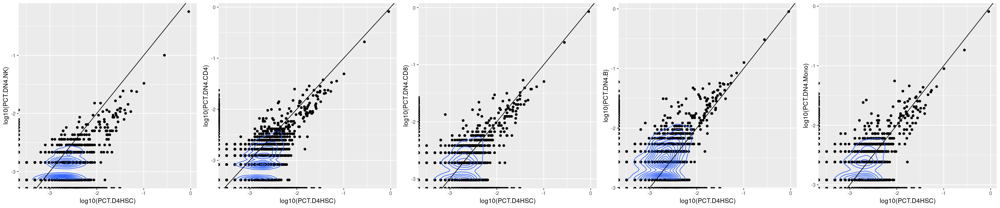

In [66]:
## Look at Donor 4:  HSC VS other cell types in BMMC, no obvious shift
options(repr.plot.width=24, repr.plot.height=5,repr.plot.res=150,warn=-1)
dim(CellPCT.DetailDN4)
p1<-ggplot(CellPCT.DetailDN4)+aes(log10(PCT.D4HSC),log10(PCT.DN4.NK))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p2<-ggplot(CellPCT.DetailDN4)+aes(log10(PCT.D4HSC),log10(PCT.DN4.CD4))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p3<-ggplot(CellPCT.DetailDN4)+aes(log10(PCT.D4HSC),log10(PCT.DN4.CD8))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p4<-ggplot(CellPCT.DetailDN4)+aes(log10(PCT.D4HSC),log10(PCT.DN4.B))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p5<-ggplot(CellPCT.DetailDN4)+aes(log10(PCT.D4HSC),log10(PCT.DN4.Mono))+geom_point()+geom_density_2d()+geom_abline(slope=1)
grid.arrange(p1,p2,p3,p4,p5,nrow=1)

[1] 16922    17

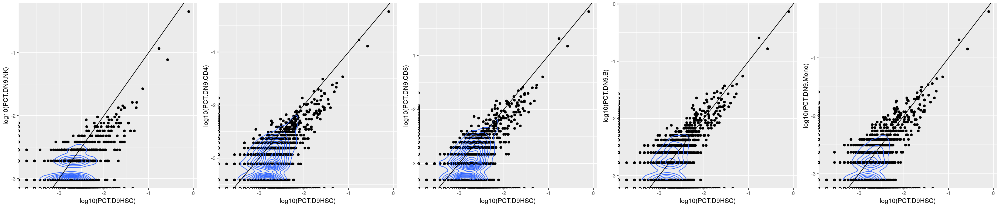

In [67]:
## Look at Donor 9:  HSC VS other cell types in BMMC, no obvious shift
options(repr.plot.width=24, repr.plot.height=5,repr.plot.res=150,warn=-1)
dim(CellPCT.DetailDN9)
p1<-ggplot(CellPCT.DetailDN9)+aes(log10(PCT.D9HSC),log10(PCT.DN9.NK))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p2<-ggplot(CellPCT.DetailDN9)+aes(log10(PCT.D9HSC),log10(PCT.DN9.CD4))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p3<-ggplot(CellPCT.DetailDN9)+aes(log10(PCT.D9HSC),log10(PCT.DN9.CD8))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p4<-ggplot(CellPCT.DetailDN9)+aes(log10(PCT.D9HSC),log10(PCT.DN9.B))+geom_point()+geom_density_2d()+geom_abline(slope=1)
p5<-ggplot(CellPCT.DetailDN9)+aes(log10(PCT.D9HSC),log10(PCT.DN9.Mono))+geom_point()+geom_density_2d()+geom_abline(slope=1)
grid.arrange(p1,p2,p3,p4,p5,nrow=1)

In [68]:
## Plot all,  DN4(BMMC/HPC/HSC), DN9(BMMC/HPC/HSC), DN1 (BMMC/HPC), NK1,2,3
options(repr.plot.width=24, repr.plot.height=24,repr.plot.res=300,warn=-1)
ps<-list()
col<-colnames(CellPCT)
for(i in 2:12){
    for(j in 2:12){
        if ((i %in% c(2,3,4) & j %in% c(2,3,4)) | (i %in% c(5,6,7) & j %in% c(5,6,7)) | (i %in% c(8,9) & j %in% c(8,9)) | (i %in% c(10,11,12) & j %in% c(10,11,12))){
            bg<-"limegreen"
        }else{
            bg<-"coral"
        }
        p<-ggplot(CellPCT)+aes_string(col[i],col[j])+geom_point(size=0.1)+geom_density_2d()+scale_x_log10()+scale_y_log10()+theme(panel.background = element_rect(fill = bg))
        ps<-c(ps,list(p))
    }
}

In [319]:
head(CellPCT)

,Variants,PCT.D4BM,PCT.D4HPC,PCT.D4HSC,PCT.D9BM,PCT.D9HPC,PCT.D9HSC,PCT.D1BM,PCT.D1HPC,PCT.NK1,PCT.NK2,PCT.NK3,top20_DN4.9_BM
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
8938,310_T_C,0.86117101,0.89793993,0.90932435,0.707446154,0.781881006,0.78826627,0.40864642,0.647128902,0.584215301,0.5882553191,0.58514903,310_T_C
8947,3109_T_C,0.23453309,0.31168423,0.27636013,0.170830769,0.244789979,0.26560737,0.06570595,0.188706219,0.121257938,0.1421276596,0.13526233,3109_T_C
11899,5764_C_T,0.07447338,0.08256015,0.10126785,0.059569231,0.068459130,0.07399398,0.00000000,0.068024780,0.000000000,0.0250212766,0.02335716,
11900,5765_C_A,0.05058882,0.05755622,0.07077516,0.043569231,0.049886621,0.05424972,0.00000000,0.049082678,0.000000000,0.0000000000,0.00000000,
11903,5766_C_G,0.04644220,0.04890706,0.05504734,0.038400000,0.043731778,0.04334336,0.00000000,0.040981654,0.000000000,0.0000000000,0.00000000,
16889,9979_G_A,0.04627633,0.04104419,0.03643075,0.003076923,0.005075046,0.00319669,0.00171556,0.002978318,0.001814333,0.0008510638,0.00000000,


In [69]:
options(repr.plot.width=24, repr.plot.height=24,repr.plot.res=300,warn=-1)
grid.arrange(grobs=ps)

<blockquote>It seems there are variants that always show high cell percentage even in different donors.<br></blockquote>

---
- Pick the consistently high variants in both DN4 and DN9 HSCs

In [70]:
head(CellPCT)

,Variants,PCT.D4BM,PCT.D4HPC,PCT.D4HSC,PCT.D9BM,PCT.D9HPC,PCT.D9HSC,PCT.D1BM,PCT.D1HPC,PCT.NK1,PCT.NK2,PCT.NK3
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
8938,310_T_C,0.86117101,0.89793993,0.90932435,0.707446154,0.781881006,0.78826627,0.40864642,0.647128902,0.584215301,0.5882553191,0.58514903
8947,3109_T_C,0.23453309,0.31168423,0.27636013,0.170830769,0.244789979,0.26560737,0.06570595,0.188706219,0.121257938,0.1421276596,0.13526233
11899,5764_C_T,0.07447338,0.08256015,0.10126785,0.059569231,0.068459130,0.07399398,0.00000000,0.068024780,0.000000000,0.0250212766,0.02335716
11900,5765_C_A,0.05058882,0.05755622,0.07077516,0.043569231,0.049886621,0.05424972,0.00000000,0.049082678,0.000000000,0.0000000000,0.00000000
11903,5766_C_G,0.04644220,0.04890706,0.05504734,0.038400000,0.043731778,0.04334336,0.00000000,0.040981654,0.000000000,0.0000000000,0.00000000
16889,9979_G_A,0.04627633,0.04104419,0.03643075,0.003076923,0.005075046,0.00319669,0.00171556,0.002978318,0.001814333,0.0008510638,0.00000000


In [71]:
CellPCT.HSC.DN4_DN9<-CellPCT[,c("Variants","PCT.D4HSC","PCT.D9HSC")]
CellPCT.HSC.DN4_DN9$rk<-rank(-(CellPCT$PCT.D4HSC+CellPCT$PCT.D9HSC)/2)
CellPCT.HSC.DN4_DN9<-CellPCT.HSC.DN4_DN9[order(CellPCT.HSC.DN4_DN9$rk),]

CellPCT.BM.DN4_DN9_DN1<-CellPCT[,c("Variants","PCT.D4BM","PCT.D9BM","PCT.D1BM")]
#CellPCT.BM.DN4_DN9_DN1$rk<-rank(-CellPCT$PCT.D4BM*CellPCT$PCT.D9BM)
CellPCT.BM.DN4_DN9_DN1$rk<-rank(-CellPCT$PCT.D4BM*CellPCT$PCT.D9BM*CellPCT$PCT.D1BM)

CellPCT.BM.DN4_DN9_DN1<-CellPCT.BM.DN4_DN9_DN1[order(CellPCT.BM.DN4_DN9_DN1$rk),]

In [72]:
top20<-head(CellPCT.BM.DN4_DN9_DN1,n=20)$Variants
top20

[1] 310_T_C   3109_T_C  309_C_T   12219_A_G 6577_G_A  515_A_G   13589_T_C
 [8] 5747_A_G  1468_T_C  5752_A_G  15784_T_C 12796_C_A 13175_T_C 12179_A_G
[15] 6320_T_C  9616_T_C  12628_T_G 3707_G_T  6293_T_C  11556_T_G
16922 Levels: 310_T_C 3109_T_C 5764_C_T 5765_C_A 5766_C_G 9979_G_A ... 9999_A_T

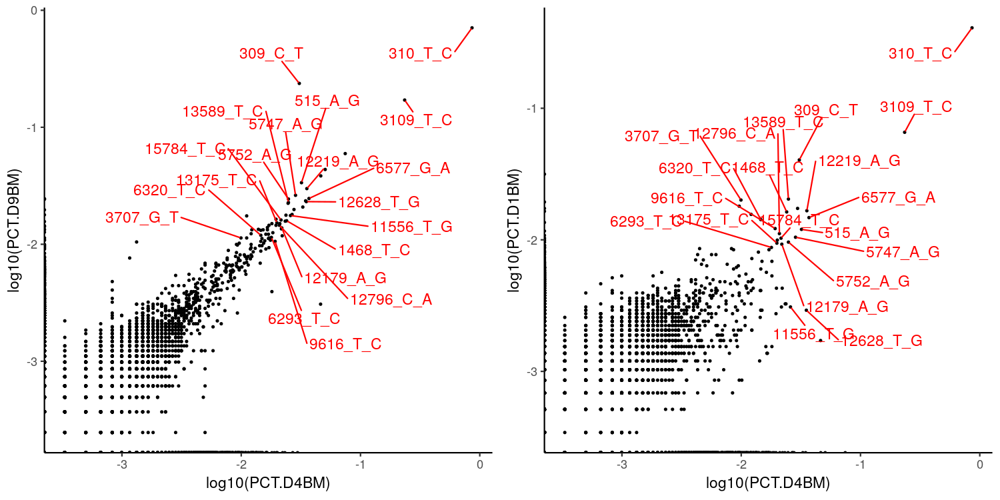

In [73]:
options(repr.plot.width=10, repr.plot.height=5,repr.plot.res=150,warn=-1)
CellPCT$top20_DN4.9_BM<-as.character(CellPCT$Variants)  %>% ifelse(. %in% top20,.,"")
p1<-ggplot(CellPCT)+aes(log10(PCT.D4BM),log10(PCT.D9BM),label=top20_DN4.9_BM)+geom_point(size=0.5)+geom_text_repel(color="red",box.padding = 2,max.overlaps = Inf)+theme_classic()
p2<-ggplot(CellPCT)+aes(log10(PCT.D4BM),log10(PCT.D1BM),label=top20_DN4.9_BM)+geom_point(size=0.5)+geom_text_repel(color="red",box.padding = 2,max.overlaps = Inf)+theme_classic()
grid.arrange(p1,p2,nrow=1)

---
## Recurrent variants across samples
- Below Use the DN1 BMMC data to show mgatk vs mitoV method

In [279]:
## Check with mtscATAC paper mgatk data CD34 cells (47 yo donor)
## I think use DN1 BMMC for this comparative analysis is better 
# library(SummarizedExperiment)
# mgatk_se_cd34 <- readRDS("/lab/solexa_weissman/cweng/PlayRoom/temp/mtscATACpaper_reproducibility/figure_paired_cd34_pbmc/output/filteredCD34_mgatk_calls.rds")
# mgatk.v<-mgatk_se_cd34@elementMetadata %>% as.data.frame 
# mgatk_cd34.raw<-read.delim("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/mtscATAC/Invivo/CD34_scATACseq_rep1/CD34rep1_mgatk/final/CD34rep1.variant_stats.tsv.gz")

In [580]:
#head(CellPCT)
#DN1BMMC1.Variants.feature.lst$VerySensitive %>% subset(.,HomoTag=="Homo")

In [74]:
DN1_BMMC_variantsStat.mgatk<-read.table("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/Run210706L2/COMBINE_CALLV/mgatk_Full/final/Donor01_BMMC.variant_stats.tsv.gz",header=T, sep="\t")

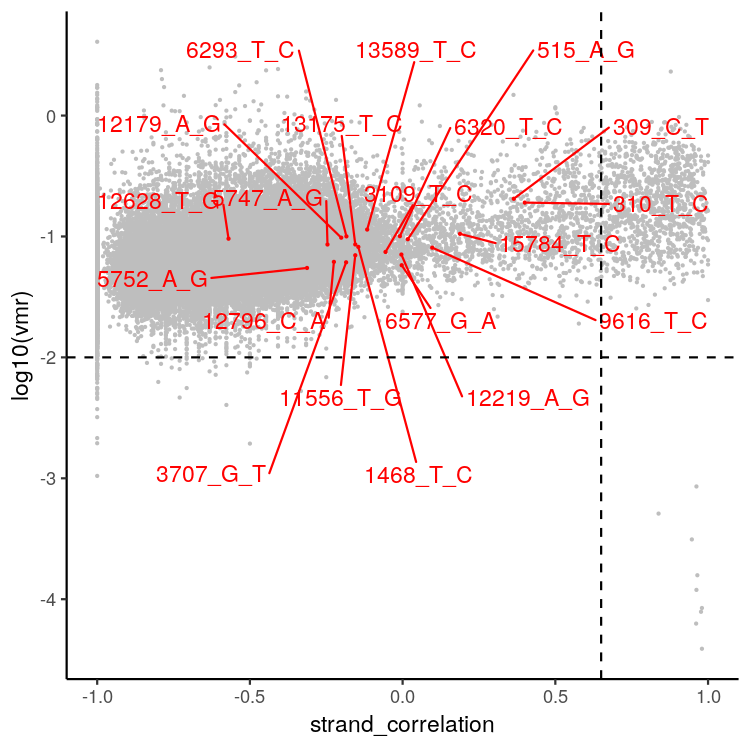

In [75]:
datatoplot<-subset(DN1_BMMC_variantsStat.mgatk,n_cells_over_5>=0) 
datatoplot$Variants<-paste(datatoplot$position,gsub(">","_",datatoplot$nucleotide),sep="_") 
datatoplot$tag<-datatoplot$Variants %>% ifelse(. %in% top20,.,"")
# datatoplot$tag2<- ifelse(datatoplot$Variants %in% top20,"top20","")

#subset(datatoplot,tag!="")
options(repr.plot.width=5, repr.plot.height=5,repr.plot.res=150,warn=-1)
ggplot()+geom_point(data=subset(datatoplot,tag==""),aes(strand_correlation,log10(vmr)),color="grey",size=0.3)+
    geom_point(data=subset(datatoplot,tag!=""),aes(strand_correlation,log10(vmr)),color="red",size=0.3)+
    geom_text_repel(data=subset(datatoplot,tag!=""),aes(strand_correlation,log10(vmr),label=tag),color="red",box.padding = 1,max.overlaps = Inf)+
    theme_classic()+geom_vline(xintercept = 0.65,linetype=2)+geom_hline(yintercept = -2,linetype=2)
    

- Look at the mgatk selected variants in my standard (Using Ncell VS positive heteroplamsy)

In [76]:
DN1_BMMC.mgatkV<-subset(DN1_BMMC_variantsStat.mgatk,strand_correlation>0.65 & vmr>0.01 & n_cells_conf_detected>=2)
DN1_BMMC.mgatkV<-DN1_BMMC.mgatkV %>% mutate(myV=paste(position,gsub(">","_",nucleotide),sep="_"))

In [77]:
head(DN1_BMMC.mgatkV)

,position,nucleotide,variant,vmr,mean,variance,n_cells_conf_detected,n_cells_over_5,n_cells_over_10,n_cells_over_20,n_cells_over_95,max_heteroplasmy,strand_correlation,mean_coverage,myV
,<int>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
172,64,C>T,64C>T,0.12059130,0.0002930477,3.533900e-05,2,10,5,2,0,0.3461538,0.930,31.66344,64_C_T
259,93,A>G,93A>G,0.53263975,0.0005118140,2.726125e-04,8,16,10,5,1,1.0000000,0.892,32.89197,93_A_G
287,102,A>G,102A>G,0.06436831,0.0003111073,2.002545e-05,2,14,4,1,0,0.2000000,0.745,32.80793,102_A_G
305,108,A>G,108A>G,0.21761085,0.0003276839,7.130757e-05,2,14,4,1,0,0.6250000,0.747,31.95732,108_A_G
396,139,T>C,139T>C,0.30075960,0.0005136832,1.544951e-04,2,25,14,3,0,0.8750000,0.758,23.48250,139_T_C
415,146,T>C,146T>C,0.54274605,0.0008829283,4.792059e-04,12,33,23,8,1,1.0000000,0.791,22.97017,146_T_C


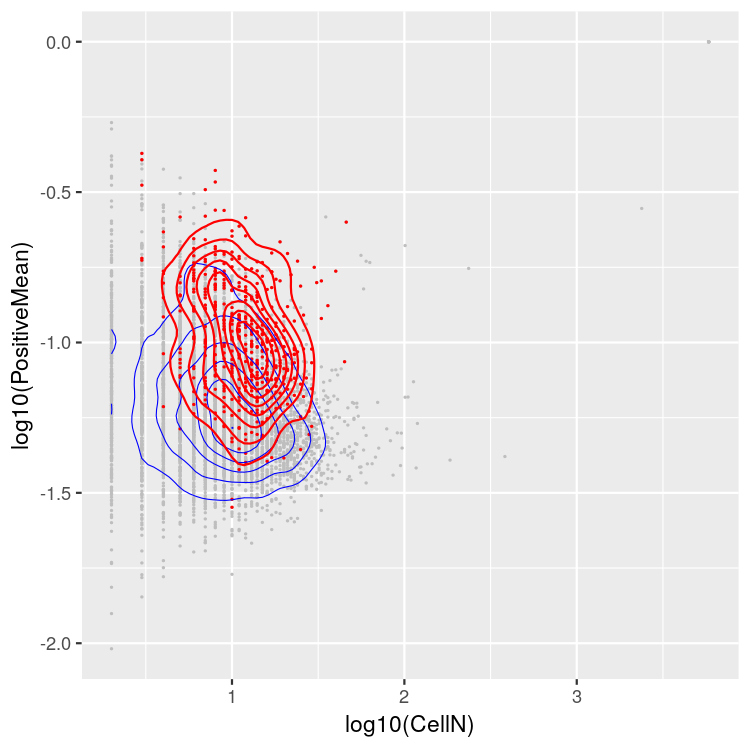

In [78]:
d<-DN1BMMC1.Variants.feature.lst$VerySensitive %>% mutate(mgatk=ifelse(Variants %in% DN1_BMMC.mgatkV$myV,DN1_BMMC.mgatkV$myV,""))
ggplot()+geom_point(data=d,aes(log10(CellN),log10(PositiveMean)),size=0.1,color="grey")+geom_point(data=subset(d,mgatk!=""),aes(log10(CellN),log10(PositiveMean)),size=0.1,color="red")+
geom_density_2d(data=d,aes(log10(CellN),log10(PositiveMean)),size=0.25,color="blue")+
geom_density_2d(data=subset(d,mgatk!=""),aes(log10(CellN),log10(PositiveMean)),size=0.5,color="red")

<blockquote>Clearly, mgatk only pick up the variants with many reads per cell, yet can be the ones appeared in limited number of cell(i,e, the rest are all zero, in which case the pearson's correlation is still high)<br>
But by this way all the variants with some dropout suffer from low pearson's r</blockquote>

- below to show the raw mgatk without filtering using strand_correlation 

In [79]:
DN1_BMMC.mgatk.loose<-subset(DN1_BMMC_variantsStat.mgatk,n_cells_conf_detected>0 & vmr>0.01)
DN1_BMMC.mgatk.loose$Variants<-paste(DN1_BMMC.mgatk.loose$position,gsub(">","_",DN1_BMMC.mgatk.loose$nucleotide),sep="_") 
DN1_BMMC.mgatk.loose<-DN1_BMMC.mgatk.loose[,c("Variants","n_cells_conf_detected","n_cells_over_5","strand_correlation")]

In [80]:
CellPCT.plusDN1BMmgatk<-merge(CellPCT,DN1_BMMC.mgatk.loose,by="Variants",all=T)
CellPCT.plusDN1BMmgatk[is.na(CellPCT.plusDN1BMmgatk)]<-0

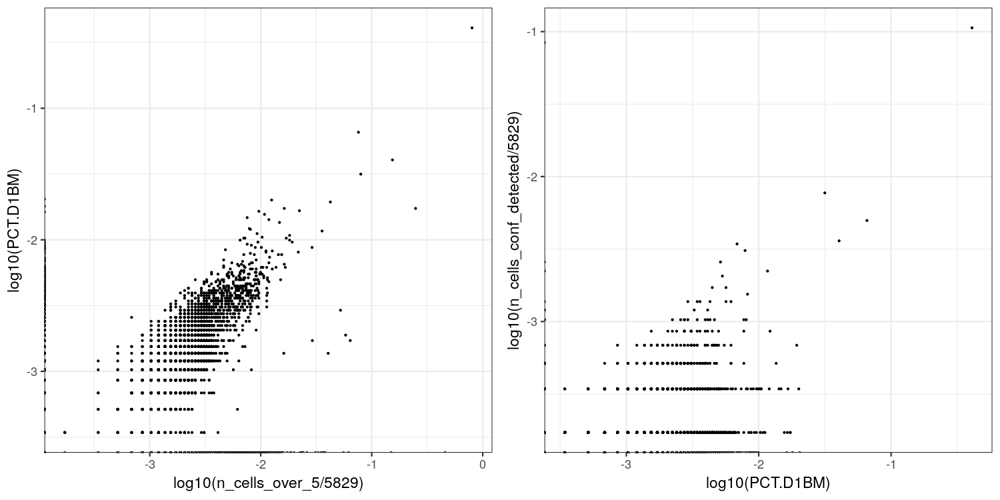

In [81]:
options(repr.plot.width=10, repr.plot.height=5,repr.plot.res=150,warn=-1)
p1<-ggplot(CellPCT.plusDN1BMmgatk)+aes(log10(n_cells_over_5/5829),log10(PCT.D1BM))+geom_point(size=0.3)+theme_bw()
p2<-ggplot(CellPCT.plusDN1BMmgatk)+aes(log10(PCT.D1BM),log10(n_cells_conf_detected/5829))+geom_point(size=0.3)+theme_bw()
grid.arrange(p1,p2,nrow=1)

---
- Below, to examplify some of the frequent mutation sites in both Donor 4 and Donor 9 and rule out the possibility of systematic techical bias

In [82]:
DN4.RawGenotypes.VerySensitive<-read.table("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_BMMC/MTenrichCombine/mitoV/final/RawGenotypes.VerySensitive.StrandBalance")

In [83]:
DN1.RawGenotypes.VerySensitive<-read.table("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/Run210706L2/COMBINE_CALLV/CW_mgatk_Full/final/RawGenotypes.VerySensitive.StrandBalance")

In [84]:
DN1.RawGenotypes.Sensitive<-read.table("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/Run210706L2/COMBINE_CALLV/CW_mgatk_Full/final/RawGenotypes.Sensitive.StrandBalance")

In [87]:
top20.DN4.RawGenotypes.VerySensitive<-subset(DN4.RawGenotypes.VerySensitive,V4 %in% top20)
top20.DN1.RawGenotypes.VerySensitive<-subset(DN1.RawGenotypes.VerySensitive,V4 %in% top20)

In [88]:
head(top20.DN4.RawGenotypes.VerySensitive)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14
,<chr>,<chr>,<int>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>
39,ATTACGAAGGACACGC_378_309,ATTACGAAGGACACGC,310,310_T_C,C,T,3,3,1,3,0,1,1,4
40,ATTACGAAGGACACGC_382_309,ATTACGAAGGACACGC,310,310_T_C,C,T,6,6,1,6,0,1,1,4
803,ATTACGAAGTACTGGG_310_222,ATTACGAAGTACTGGG,310,310_T_C,C,T,13,13,1,13,0,1,1,13
804,ATTACGAAGTACTGGG_310_236,ATTACGAAGTACTGGG,310,310_T_C,C,T,16,16,1,16,0,1,1,13
805,ATTACGAAGTACTGGG_310_249,ATTACGAAGTACTGGG,310,310_T_C,C,T,12,12,1,12,0,1,1,13
806,ATTACGAAGTACTGGG_310_252,ATTACGAAGTACTGGG,310,310_T_C,C,T,2,2,1,2,0,1,1,13


Using V4 as id variables



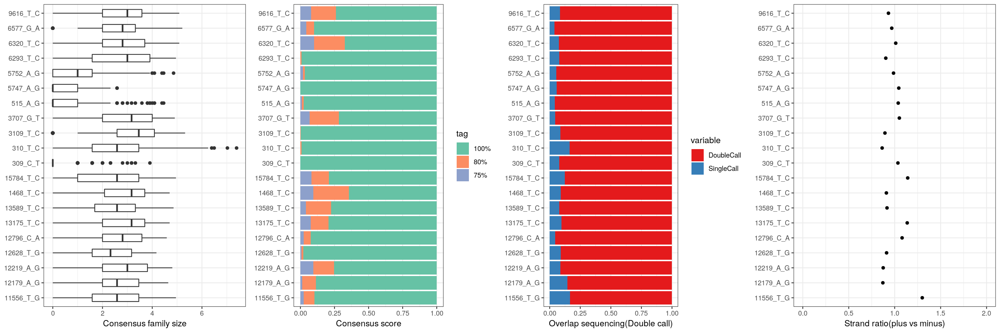

In [91]:
###p1
library(reshape2)
top20.DN4.RawGenotypes.VerySensitive$Consensus<-with(top20.DN4.RawGenotypes.VerySensitive,V8/V7)
p1<-ggplot(top20.DN4.RawGenotypes.VerySensitive)+aes(V4,log2(V7))+geom_boxplot(width=0.5)+coord_flip()+theme_bw()+
    labs(y="Consensus family size")+theme(axis.title.y=element_blank())

###p2
TagC<-function(x){
    tag<-c()
    tag[which(x==1)]<-"100%"
    tag[which(x<1 &x>0.8)]<-"80%"
    tag[which(x<0.8)]<-"75%"
    tag<-factor(tag,levels = c("100%","80%","75%"))
    return(tag)
}
top20.DN4.RawGenotypes.VerySensitive$tag<-TagC(top20.DN4.RawGenotypes.VerySensitive$Consensus)
p2<-top20.DN4.RawGenotypes.VerySensitive[,c("V4","tag")] %>% table %>% as.data.frame %>% ggplot()+aes(V4,Freq,fill=tag)+geom_bar(stat="identity",position="fill")+
    coord_flip()+theme_bw()+scale_fill_brewer(palette="Set2")+theme(axis.title.y=element_blank() )+labs(y="Consensus score")+theme(axis.title.y=element_blank())

##p3
p3<-top20.DN4.RawGenotypes.VerySensitive %>% group_by(V4) %>% dplyr::summarise(DoubleCall=sum(V10),SingleCall=sum(V11)) %>% melt %>% 
    ggplot()+aes(V4,value,fill=variable)+geom_bar(stat="identity",position="fill")+coord_flip()+theme_bw()+scale_fill_brewer(palette="Set1")+theme(axis.title.y=element_blank())+
    theme(axis.title.y=element_blank() )+labs(y="Overlap sequencing(Double call)")+theme(axis.title.y=element_blank())
##p4
p4<-top20.DN4.RawGenotypes.VerySensitive %>% group_by(V4) %>% dplyr::summarise(Strandratio=sum(V12)/sum(V13)) %>% 
    ggplot()+aes(V4,Strandratio)+geom_point()+ylim(0,2)+coord_flip()+theme_bw()+theme(axis.title.y=element_blank() )+
    theme(axis.title.y=element_blank() )+labs(y="Strand ratio(plus vs minus)")+theme(axis.title.y=element_blank())
##Draw
options(repr.plot.width=18, repr.plot.height=6,repr.plot.res=150,warn=-1)
grid.arrange(p1,p2,p3,p4,nrow=1)

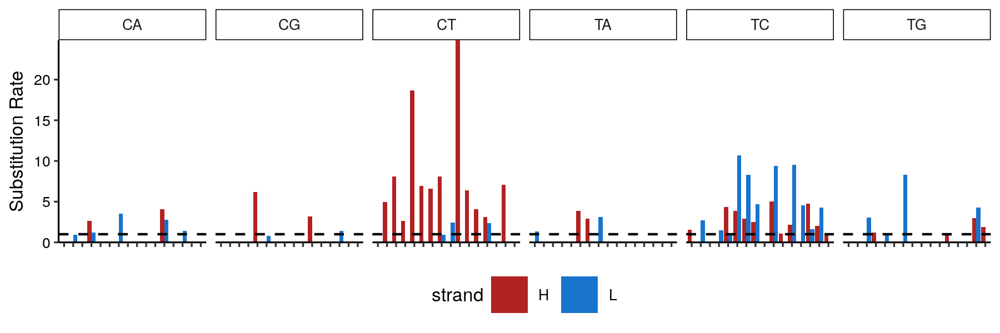

In [103]:
top100<-head(CellPCT.BM.DN4_DN9_DN1,n=100)$Variants

options(repr.plot.width=6, repr.plot.height=2,repr.plot.res=300,warn=-1)
MutationProfile.bulk(as.character(top100))

<blockquote>I do feel confident based on those top variants</blockquote>

---
## copies per cell verses number of cells 
- Show that anti-correlation between copies per cell verses number of cells carrying the variant
- Use DN4 as an example

In [733]:
#DN4_HSC_HPC_BMMC_mitoTracing.verysensitive<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN4_HSC_HPC_BMMC_mitoTracing.verysensitive")
#DN4_HSC_HPC_BMMC_mitoTracing.Sensitive<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN4_HSC_HPC_BMMC_mitoTracing.Sensitive")

In [128]:
Donor04_BMMC.meta<-Translate_RNA2ATAC(meta=Donor04_BMMC_Multiome_wrapper$seurat@meta.data,PostFix = F) %>% tibble::rownames_to_column("RNAName") 
head(Donor04_BMMC.meta)

The following `from` values were not present in `x`: 2, 3



,RNAName,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nCount_SCT,nFeature_SCT,SCT.weight,ATAC.weight,wsnn_res.0.8,seurat_clusters,CellType,ATACName
,<chr>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<chr>
1,AAACAGCCAATTAGCT-1,SeuratProject,2821,1527,7353,3378,2805,1526,0.7672044,0.2327956,5,5,CD4,ACAGCGGGTCCAAATC
2,AAACAGCCAGCTCATA-1,SeuratProject,2939,1596,8410,3886,2891,1596,0.5170815,0.4829185,4,4,CD4,ACAGCGGGTTCAAGCT
3,AAACAGCCATAGCGGA-1,SeuratProject,3889,2027,3394,1701,3174,2020,0.5582230,0.4417770,2,2,Mono,ACAGCGGGTAGCTTTA
4,AAACATGCAAGCCACT-1,SeuratProject,2350,1372,12789,5675,2386,1370,0.5000000,0.5000000,7,7,B,CATTTAGGTTTACCGG
5,AAACATGCAAGGCCAA-1,SeuratProject,2775,1479,7326,3383,2769,1479,0.5273375,0.4726625,4,4,CD4,CATTTAGGTGAATCGA
6,AAACCAACAGGATAAC-1,SeuratProject,2536,1468,2877,1430,2537,1465,0.5830835,0.4169165,3,3,CD8,CTTTATCGTGAGGAAG


In [131]:
BMMC_mitoTracing.verysensitive<-Create_mitoTracing(GTsummary_list=list(DN4_BMMC.VariantsGTSummary),
                depth_list=list(DN4_BMMC.depth),
                feature.list_list=list(DN4_BMMC.Variants.feature.lst),
                meta_list=list(Donor04_BMMC.meta),
                labels=c("BMMC"),thr="VerySensitive")
BMMC_mitoTracing.verysensitive<-Make_matrix(BMMC_mitoTracing.verysensitive)
BMMC_mitoTracing.verysensitive<-SeuratLSIClustering(BMMC_mitoTracing.verysensitive)
BMMC_mitoTracing.verysensitive<-AddDatatoplot_clustering(BMMC_mitoTracing.verysensitive)

Loading required package: Matrix.utils

Loading required package: Matrix


Attaching package: ‘Matrix’


The following object is masked from ‘package:ggtree’:

    expand


Loading required package: Signac

Performing TF-IDF normalization

Running SVD

Scaling cell embeddings

15:10:30 UMAP embedding parameters a = 0.9922 b = 1.112

15:10:30 Read 5793 rows and found 20 numeric columns

15:10:30 Using Annoy for neighbor search, n_neighbors = 30

15:10:30 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:10:32 Writing NN index file to temp file /tmp/Rtmp5RpYYt/filed02d5b088091

15:10:32 Searching Annoy index using 1 thread, search_k = 3000

15:10:35 Annoy recall = 99.93%

15:10:41 Commencing smooth kNN distance calibration using 1 thread

15:10:41 34 smooth knn distance

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5793
Number of edges: 187355

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9686
Number of communities: 32
Elapsed time: 0 seconds


In [129]:
WD="/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/Donor4/DN4_BMMC/MTenrichCombine/mitoV/final/"
q<-read.table(paste(WD,"QualifiedTotalCts",sep=""))
q$V1<-paste(q$V1,"1",sep="_")

In [132]:
## Add depth matrix
BMMC_mitoTracing.verysensitive<-Add_DepthMatrix(BMMC_mitoTracing.verysensitive,q)

Using VerySensitive as value column: use value.var to override.



In [133]:
## Make a dataframe that summarize Number of cell. totalPosMuts and totalPosDepths for each variant
Ns<-c()
totalPosMuts<-c()
totalPosDepths<-c()
for(i in 1:ncol(BMMC_mitoTracing.verysensitive@Cts.Mtx)){
x<-BMMC_mitoTracing.verysensitive@Cts.Mtx[,i]
Ns<-c(Ns,length(which(x>0)))
totalPosMuts<-c(totalPosMuts,sum(x[x>0]))
totalPosDepths<-c(totalPosDepths,sum(BMMC_mitoTracing.verysensitive@Ctx.Mtx.depth[,i][x>0]))
}

In [134]:
datatoplot.BMMC<-data.frame(V=colnames(BMMC_mitoTracing.verysensitive@Cts.Mtx),Ns,totalPosMuts,totalPosDepths)

In [135]:
head(datatoplot.BMMC)

,V,Ns,totalPosMuts,totalPosDepths
,<chr>,<int>,<dbl>,<dbl>
1,Variants10000GA,10,31,634
2,Variants10001TC,5,10,242
3,Variants10009GA,8,17,323
4,Variants10010TC,3,8,375
5,Variants10013CA,93,95,5565
6,Variants10014GA,11,14,1051


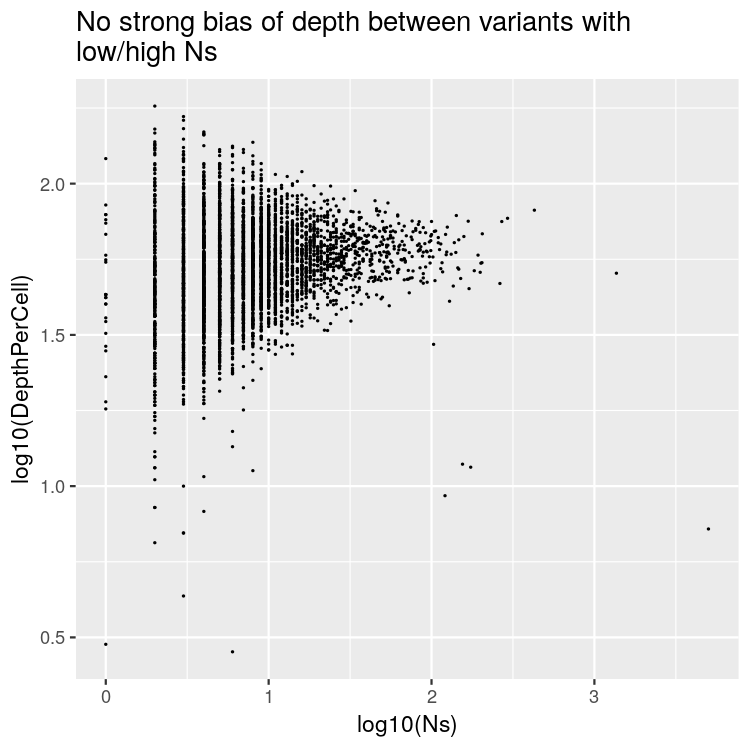

In [137]:
options(repr.plot.width=5, repr.plot.height=5,repr.plot.res=150,warn=-1)
datatoplot.BMMC %>% mutate(DepthPerCell=totalPosDepths/Ns) %>% .[order(.$Ns,decreasing=T),] %>% ggplot()+aes(log10(Ns),log10(DepthPerCell))+geom_point(size=0.1)+ggtitle("No strong bias of depth between variants with \nlow/high Ns")

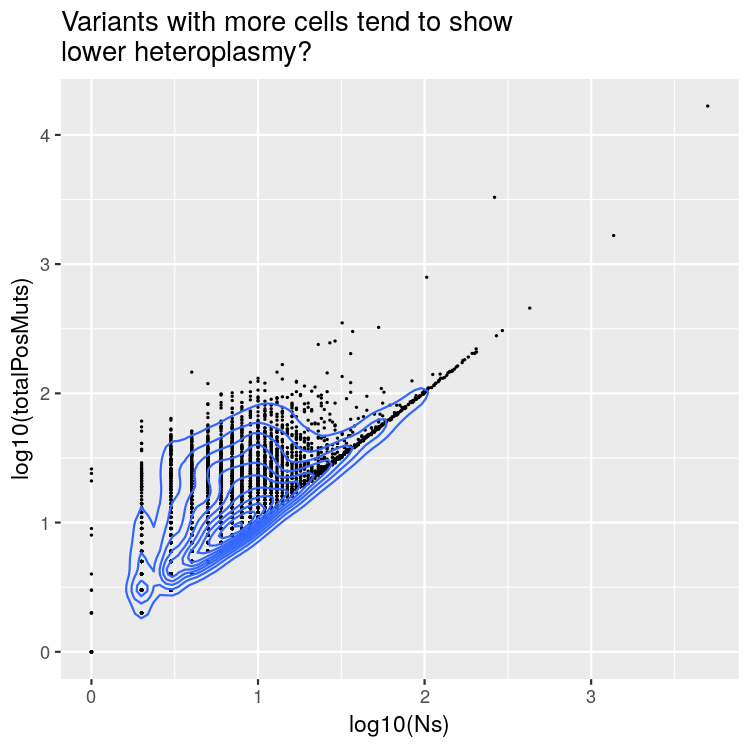

In [138]:
options(repr.plot.width=5, repr.plot.height=5,repr.plot.res=150,warn=-1)
ggplot(datatoplot.BMMC)+aes(log10(Ns),log10(totalPosMuts))+geom_point(size=0.1)+geom_density_2d()+ggtitle("Variants with more cells tend to show \nlower heteroplasmy?")

- The same point Show that anti-correlation between copies per cell verses number of cells carrying the variant in BMMC, HPC, HSC cells together

In [139]:
## In all 
HSC_HPC_BMMC_mitoTracing.verysensitive<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN4_HSC_HPC_BMMC_mitoTracing.verysensitive")

In [141]:
## In all 
datatoplot.ALL<-data.frame(V=colnames(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx),Ns=colSums(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx.bi),
                           totalPosMuts=colSums(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx),
                           N3=apply(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx,2,function(x){length(which(x>=3))}),
                           N4=apply(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx,2,function(x){length(which(x>=4))}),
                           N5=apply(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx,2,function(x){length(which(x>=5))}),
                           MEAN=apply(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx,2,function(x){mean(x[x>0])}),
                           MEDIAN=apply(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx,2,function(x){median(x[x>0])})
                          )

`geom_smooth()` using formula 'y ~ x'

`geom_smooth()` using formula 'y ~ x'

`geom_smooth()` using formula 'y ~ x'

`geom_smooth()` using formula 'y ~ x'

`geom_smooth()` using formula 'y ~ x'



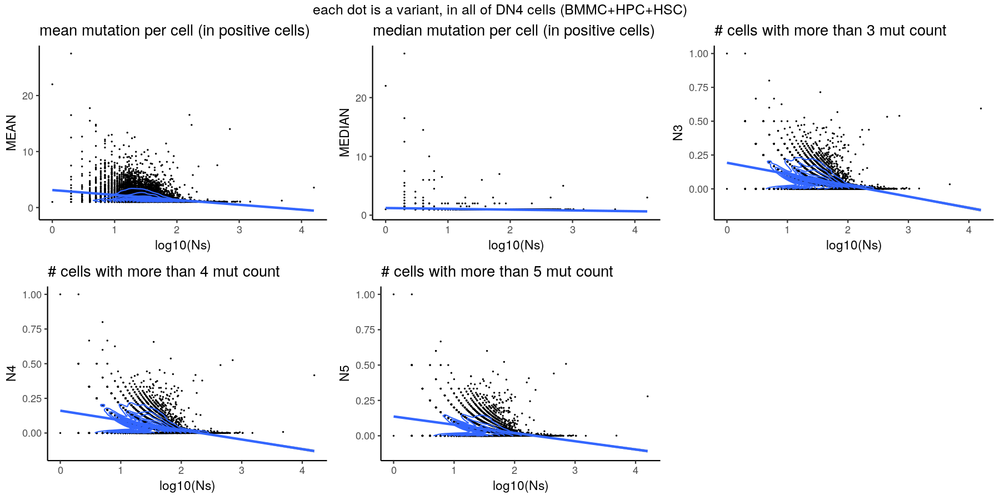

In [142]:
options(repr.plot.width=12, repr.plot.height=6,repr.plot.res=150,warn=-1)
p1<-datatoplot.ALL %>%  mutate(MutPerCell=totalPosMuts/Ns) %>% ggplot()+aes(log10(Ns),MutPerCell)+geom_point(size=0.1)+geom_density_2d()+geom_smooth(method="lm")+theme_classic()+ggtitle("mean mutation per cell (in positive cells)")
p2<-datatoplot.ALL %>%  ggplot()+aes(log10(Ns),MEAN)+geom_point(size=0.1)+geom_density_2d()+geom_smooth(method="lm")+theme_classic()+ggtitle("mean mutation per cell (in positive cells)")
p3<-datatoplot.ALL %>%  ggplot()+aes(log10(Ns),MEDIAN)+geom_point(size=0.1)+geom_smooth(method="lm")+theme_classic()+ggtitle("median mutation per cell (in positive cells)")
p4<-datatoplot.ALL %>% mutate(N3=N3/Ns, N4=N4/Ns, N5=N5/Ns) %>%  ggplot()+aes(log10(Ns),N3)+geom_point(size=0.1)+geom_density_2d()+geom_smooth(method="lm")+theme_classic()+ggtitle("# cells with more than 3 mut count")
p5<-datatoplot.ALL %>% mutate(N3=N3/Ns, N4=N4/Ns, N5=N5/Ns) %>%  ggplot()+aes(log10(Ns),N4)+geom_point(size=0.1)+geom_density_2d()+geom_smooth(method="lm")+theme_classic()+ggtitle("# cells with more than 4 mut count")
p6<-datatoplot.ALL %>% mutate(N3=N3/Ns, N4=N4/Ns, N5=N5/Ns) %>%  ggplot()+aes(log10(Ns),N5)+geom_point(size=0.1)+geom_density_2d()+geom_smooth(method="lm")+theme_classic()+ggtitle("# cells with more than 5 mut count")


grid.arrange(p2,p3,p4,p5,p6,nrow=2, top="each dot is a variant, in all of DN4 cells (BMMC+HPC+HSC)")

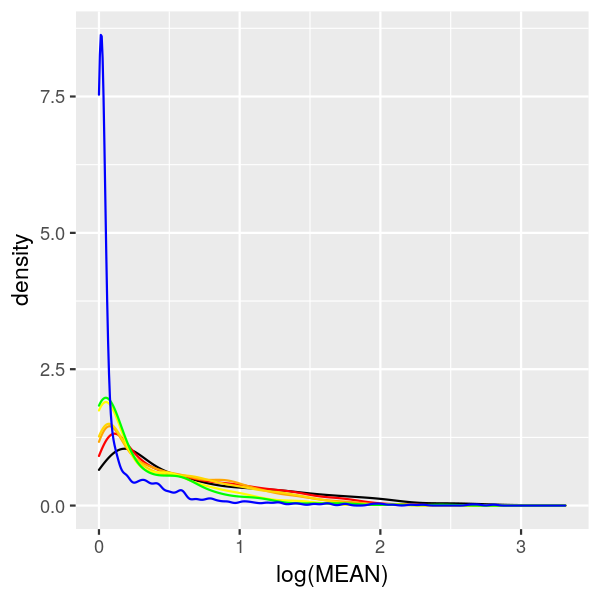

In [143]:
## In case the scatter plot is misleading, here I take bins and show distribution of means for each bin
options(repr.plot.width=4, repr.plot.height=4,repr.plot.res=150,warn=-1)
ggplot()+geom_density(data=subset(datatoplot.ALL,Ns>0 & Ns<10),aes(log(MEAN)))+
    geom_density(data=subset(datatoplot.ALL,Ns>10 & Ns<20),aes(log(MEAN)),color="red")+
    geom_density(data=subset(datatoplot.ALL,Ns>20 & Ns<30),aes(log(MEAN)),color="orange")+
    geom_density(data=subset(datatoplot.ALL,Ns>30 & Ns<40),aes(log(MEAN)),color="gold")+
    geom_density(data=subset(datatoplot.ALL,Ns>50 & Ns<60),aes(log(MEAN)),color="yellow")+
    geom_density(data=subset(datatoplot.ALL,Ns>60 & Ns<70),aes(log(MEAN)),color="green")+
    geom_density(data=subset(datatoplot.ALL,Ns>70),aes(log(MEAN)),color="blue")

<blockquote>I think overall the data suggest that the variant with more cells tend to have in average lower heteroplasmy, how to intepret?</blockquote>

---
- Below is a simple example code to check the cells, as well as the celltype info for any given variant

In [144]:
V<-"Variants14523TC"
BMMC_mitoTracing.verysensitive@Cts.Mtx[,V][BMMC_mitoTracing.verysensitive@Cts.Mtx[,V]>0]
BMMC_mitoTracing.verysensitive@Ctx.Mtx.depth[,V][BMMC_mitoTracing.verysensitive@Cts.Mtx[,V]>0]
C<-names(BMMC_mitoTracing.verysensitive@Cts.Mtx[,V][BMMC_mitoTracing.verysensitive@Cts.Mtx[,V]>0])
BMMC_mitoTracing.verysensitive@CellMeta[C,] 

CCCGCAATCATGGTCC_1 CTTGTGTCAACAAAGA_1 GCTATTAGTTTATCCT_1 
                 1                  1                 45

CCCGCAATCATGGTCC_1 CTTGTGTCAACAAAGA_1 GCTATTAGTTTATCCT_1 
                14                 54                 46

,Cell,meanCov,RNAName,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nCount_SCT,nFeature_SCT,SCT.weight,ATAC.weight,wsnn_res.0.8,seurat_clusters,CellType,Label
,<chr>,<dbl>,<chr>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<chr>
CCCGCAATCATGGTCC_1,CCCGCAATCATGGTCC_1,21.24093,CCTAAGTAGCTCAATA-1,SeuratProject,2283,1352,10178,4594,2364,1351,0.4253438,0.5746562,10,10,CD8,BMMC
CTTGTGTCAACAAAGA_1,CTTGTGTCAACAAAGA_1,53.17201,GAAGCCTGTCTCAGCC-1,SeuratProject,2723,1478,9148,4232,2720,1477,0.6397298,0.3602702,8,8,B,BMMC
GCTATTAGTTTATCCT_1,GCTATTAGTTTATCCT_1,36.06458,AGTAACACATGTTTGG-1,SeuratProject,2066,1220,10365,4535,2267,1218,0.5228288,0.4771712,5,5,CD4,BMMC


## Variant level, potential lineage bias (DN4)
- HSC
- MPP only  
~- HSC/MPP/MK only (MK biased HSC)~
~- HSC/MPP/Lym (Lym biased HSC)~
~- HSC/MPP/Mye (Mye biased HSC)~
- MK only (MK subclonal)
- Lym only (Lym subclonal)
- Mye only (Mye subclonal)
- others (unbiased HSC, low-power)

---
- In variant level, identify the variant showing lineage bias
- Use Donor4 as example

In [374]:
## Recode the cell type into general lineage
table(HSC_HPC_BMMC_mitoTracing.verysensitive@CellMeta$CellType)
HSC_HPC_BMMC_mitoTracing.verysensitive@CellMeta$Lineage<-dplyr::recode(HSC_HPC_BMMC_mitoTracing.verysensitive@CellMeta$CellType,
             EryP ="MkEry",MKP3="MkEry",MKP2="MkEry", MKP1="MkEry", MEP="MkEry", MKP="MkEry", Ery="MkEry",
             HSC="HSC",                                                          
             MPP3="MPP", MPP2="MPP",MPP1="MPP", MPP="MPP",
             CDP="Mye", MDP="Mye", GMP="Mye",pDC="Mye",mDC="Mye", Mono="Mye",
             PreB="Lym",LMPP="Lym", CLP="Lym", B="Lym", NK="Lym", CD8="Lym", CD4="Lym"
             )

HSC_HPC_BMMC_mitoTracing.verysensitive@CellMeta$Lineage2<-dplyr::recode(HSC_HPC_BMMC_mitoTracing.verysensitive@CellMeta$CellType,
             EryP ="Com",MKP3="Com",MKP2="Com", MKP1="Com", MEP="Com", MKP="Com", Ery="Com",
             HSC="HSC",                                                          
             MPP3="MPP", MPP2="MPP",MPP1="MPP", MPP="MPP",
             CDP="Com", MDP="Com", GMP="Com",pDC="Com",mDC="Com", Mono="Com",
             PreB="Com",LMPP="Com", CLP="Com", B="Com", NK="Com", CD8="Com", CD4="Com"
             )

L<-HSC_HPC_BMMC_mitoTracing.verysensitive@CellMeta %>% subset(.,Lineage !="10")
head(L)  # L is the meta dataframe with a column of collapsed lineage info


EryP MKP3 MKP2 MKP1  MEP MPP3 MPP2 MPP1  HSC   10  CDP  MDP  GMP  MKP PreB LMPP 
 143   67  250  339 1635   79  252  698 4003  139  239  310  972  154  101  548 
 CLP  MPP  pDC  Ery  mDC Mono    B   NK  CD8  CD4 
1153  812   43  400   53  726  696  849  943 2106 

,Cell,meanCov,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nCount_SCT,nFeature_SCT,SCT.weight,ATAC.weight,wsnn_res.0.8,seurat_clusters,CellType,Label,Lineage,Lineage2
,<chr>,<dbl>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<chr>,<fct>,<fct>
AAACAAGCACATTGTC_1,AAACAAGCACATTGTC_1,74.74682,SeuratProject,2664,1373,35552,14086,4830,1388,0.4932988,0.5067012,0,0,HSC,HSC,HSC,HSC
AAACAAGCACTTGCTG_1,AAACAAGCACTTGCTG_1,122.72612,SeuratProject,7744,3007,53533,19345,6280,3004,0.5438496,0.4561504,8,8,MKP2,HSC,MkEry,Com
AAACAAGCAGGCAACT_1,AAACAAGCAGGCAACT_1,51.26821,SeuratProject,14113,4109,12215,5759,6081,2519,0.5372254,0.4627746,6,6,MEP,HSC,MkEry,Com
AAACCAGGTTAGCCAT_1,AAACCAGGTTAGCCAT_1,63.90531,SeuratProject,5366,2202,29607,12383,5367,2202,0.6139536,0.3860464,4,4,HSC,HSC,HSC,HSC
AAACCGCCAAGTCCTT_1,AAACCGCCAAGTCCTT_1,15.61856,SeuratProject,5037,2129,8805,4279,5171,2128,0.2623231,0.7376769,4,4,HSC,HSC,HSC,HSC
AAACCGCCAATAGCAT_1,AAACCGCCAATAGCAT_1,63.88509,SeuratProject,3855,1803,24233,10397,4763,1803,0.4080758,0.5919242,0,0,HSC,HSC,HSC,HSC


In [375]:
## The major data to start with is @GTsummary.filtered
## Put together lineage info with the GTsummary as LV
HSC_HPC_BMMC_mitoTracing.verysensitive@GTsummary.filtered %>% head
LV<-HSC_HPC_BMMC_mitoTracing.verysensitive@GTsummary.filtered %>% merge(.,L[,c("Cell","Lineage")]) 
LV2<-HSC_HPC_BMMC_mitoTracing.verysensitive@GTsummary.filtered %>% merge(.,L[,c("Cell","Lineage2")]) 

,Var1,Cell,Variants,Freq,depth,Type,Context,hetero
,<fct>,<chr>,<chr>,<int>,<dbl>,<chr>,<chr>,<dbl>
2,AAACAAGCACATTGTC_10537_G_A,AAACAAGCACATTGTC_1,10537_G_A,1,60,G_A,GCG,0.01666667
8,AAACAAGCACATTGTC_11775_G_A,AAACAAGCACATTGTC_1,11775_G_A,1,98,G_A,TCA,0.01020408
14,AAACAAGCACATTGTC_13041_A_G,AAACAAGCACATTGTC_1,13041_A_G,1,59,A_G,GTC,0.01694915
15,AAACAAGCACATTGTC_13339_T_C,AAACAAGCACATTGTC_1,13339_T_C,2,75,T_C,CTT,0.02666667
19,AAACAAGCACATTGTC_14502_T_C,AAACAAGCACATTGTC_1,14502_T_C,1,63,T_C,ATT,0.01587302
28,AAACAAGCACATTGTC_16048_G_A,AAACAAGCACATTGTC_1,16048_G_A,1,67,G_A,CCC,0.01492537


In [376]:
## Make LV.summarise
LV.summarise<-LV %>% group_by(Variants) %>% dplyr::count(Lineage) %>% dcast(Variants~Lineage)
row.names(LV.summarise)<-LV.summarise$Variants
LV.summarise<-LV.summarise[,-1]
LV.summarise[is.na(LV.summarise)]<-0
LV.summarise$sum<-rowSums(LV.summarise)
head(LV.summarise)

## Make LV.summarise.2
LV.summarise.2<-LV2 %>% group_by(Variants) %>% dplyr::count(Lineage2) %>% dcast(Variants~Lineage2)
row.names(LV.summarise.2)<-LV.summarise.2$Variants
LV.summarise.2<-LV.summarise.2[,-1]
LV.summarise.2[is.na(LV.summarise.2)]<-0
LV.summarise.2$sum<-rowSums(LV.summarise.2)
head(LV.summarise.2)



Using n as value column: use value.var to override.



,MkEry,MPP,HSC,Mye,Lym,sum
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1000_T_C,7,3,4,4,2,20
10000_G_A,5,1,4,6,7,23
10001_T_C,3,2,3,2,4,14
10002_A_C,3,0,1,1,6,11
10005_A_G,5,3,1,2,4,15
10007_T_C,3,2,3,2,4,14


Using n as value column: use value.var to override.



,Com,MPP,HSC,sum
,<dbl>,<dbl>,<dbl>,<dbl>
1000_T_C,13,3,4,20
10000_G_A,18,1,4,23
10001_T_C,9,2,3,14
10002_A_C,10,0,1,11
10005_A_G,11,3,1,15
10007_T_C,9,2,3,14


- below is to run binom test to call potentially biased variants

In [377]:
## Calculate expected lineage proportion
Exp<-colSums(LV.summarise[,-6])/sum(colSums(LV.summarise[,-6]))
Exp

Exp2<-colSums(LV.summarise.2[,-4])/sum(colSums(LV.summarise.2[,-4]))
Exp2

MkEry       MPP       HSC       Mye       Lym 
0.2186644 0.1099224 0.1841340 0.1782788 0.3090004

Com       MPP       HSC 
0.7059436 0.1099224 0.1841340

In [407]:
## A specific function to test lineage bias
VariantLinBiase.compute<-function(x,alt="greater"){
p1<-binom.test(x[1],x[6],Exp[1],alternative = alt)$p.value
Es1<-(x[1]/x[6])/Exp[1]
p2<-binom.test(x[2],x[6],Exp[2],alternative = alt)$p.value
Es2<-(x[2]/x[6])/Exp[2]
p3<-binom.test(x[3],x[6],Exp[3],alternative = alt)$p.value
Es3<-(x[3]/x[6])/Exp[3]
p4<-binom.test(x[4],x[6],Exp[4],alternative = alt)$p.value
Es4<-(x[4]/x[6])/Exp[4]
p5<-binom.test(x[5],x[6],Exp[5],alternative = alt)$p.value
Es5<-(x[5]/x[6])/Exp[5]
ps<-c(p1,p2,p3,p4,p5)
Ess<-c(Es1,Es2,Es3,Es4,Es5)
return(list(ps,Ess))
}

VariantLinBiase.compute.2<-function(x,alt="greater"){
p1<-binom.test(x[1],x[4],Exp2[1],alternative = alt)$p.value
Es1<-(x[1]/x[4])/Exp2[1]
p2<-binom.test(x[2],x[4],Exp2[2],alternative = alt)$p.value
Es2<-(x[2]/x[4])/Exp2[2]
p3<-binom.test(x[3],x[4],Exp2[3],alternative = alt)$p.value
Es3<-(x[3]/x[4])/Exp2[3]
ps<-c(p1,p2,p3)
Ess<-c(Es1,Es2,Es3)
return(list(ps,Ess))
}

In [151]:
LV.summarise.raw<-apply(LV.summarise,1,VariantLinBiase.compute)

In [408]:
## Compute for commited cells
LV.summarise.raw.2<-apply(LV.summarise.2,1,VariantLinBiase.compute.2)

In [152]:
## Compute enrichment
LV.summarise.enrich.pvalues<- lapply(LV.summarise.raw,function(x){x[[1]]}) %>% do.call(rbind,.) %>% as.data.frame
LV.summarise.enrich.effectSizes<-lapply(LV.summarise.raw,function(x){x[[2]]}) %>% do.call(rbind,.)  %>% as.data.frame

In [410]:
## Compute for committed p values and effect size
LV.summarise.enrich.pvalues.2<- lapply(LV.summarise.raw.2,function(x){x[[1]]}) %>% do.call(rbind,.) %>% as.data.frame
LV.summarise.enrich.effectSizes.2<-lapply(LV.summarise.raw.2,function(x){x[[2]]}) %>% do.call(rbind,.)  %>% as.data.frame

In [356]:
## Generate significantly biased variants
HSC.V<-LV.summarise.enrich.pvalues[which(LV.summarise.enrich.effectSizes$HSC>2 & LV.summarise.enrich.pvalues$HSC<0.01),] %>% .[order(.$HSC,decreasing=T),] %>% row.names
MPP.V<-LV.summarise.enrich.pvalues[which(LV.summarise.enrich.effectSizes$MPP>2 & LV.summarise.enrich.pvalues$MPP<0.01),] %>% .[order(.$MPP,decreasing=T),] %>% row.names
Mye.V<-LV.summarise.enrich.pvalues[which(LV.summarise.enrich.effectSizes$Mye>2 & LV.summarise.enrich.pvalues$Mye<0.01),] %>% .[order(.$Mye,decreasing=T),] %>% row.names
Lym.V<-LV.summarise.enrich.pvalues[which(LV.summarise.enrich.effectSizes$Lym>2 & LV.summarise.enrich.pvalues$Lym<0.01),] %>% .[order(.$Lym,decreasing=T),] %>% row.names
MKEry.V<-LV.summarise.enrich.pvalues[which(LV.summarise.enrich.effectSizes$MkEry>2 & LV.summarise.enrich.pvalues$MkEry<0.05),] %>% .[order(.$MkEry,decreasing=T),] %>% row.names
SigV<-data.frame(V=HSC.V,name="V_HSC") %>% rbind(.,data.frame(V=MPP.V,name="V_MPP")) %>% rbind(.,data.frame(V=Mye.V,name="V_Mye")) %>% 
rbind(.,data.frame(V=Lym.V,name="V_Lym")) %>% rbind(.,data.frame(V=MKEry.V,name="V_MKEry")) %>% .[!duplicated(.$V),] 
row.names(SigV)<-SigV$V
nrow(SigV)

[1] 339

In [403]:
DN4.Comit.enrich.V<-LV.summarise.enrich.pvalues.2[which(LV.summarise.enrich.effectSizes.2$Com>1 & LV.summarise.enrich.pvalues.2$Com<1e-5),] %>% .[order(.$HSC,decreasing=T),] %>% row.names 

In [445]:
DN4.MyeLym.specificV
head(LV.summarise.2)


# length(which(LV.summarise.enrich.effectSizes.2[,"Com"]>1.2))


# length(which(LV.summarise.enrich.pvalues.2[DN4.MyeLym.specificV,"Com"]))



# data.frame(x=LV.summarise.enrich.effectSizes.2[DN4.MyeLym.specificV,"Com"],y=LV.summarise.enrich.pvalues.2[DN4.MyeLym.specificV,"Com"]) %>% ggplot()+aes(x,y)+geom_point()+geom_density_2d()

# data.frame(x=LV.summarise.enrich.effectSizes.2[,"Com"],y=LV.summarise.enrich.pvalues.2[,"Com"]) %>% subset(.,x>1.2 & y<0.5) %>% head

DN4.Commited.V<-LV.summarise.enrich.pvalues.2[which(LV.summarise.enrich.effectSizes.2$Com>1.2 & LV.summarise.enrich.pvalues.2$Com<0.5),] %>% .[order(.$HSC,decreasing=T),] %>% row.names


# length(DN4.MyeLym.specificV)
# intersect(DN4.MyeLym.specificV,X)  %>% length
# length(DN4.Comit.enrich.V)

# DN4.Comit.enrich.V

# DN4.MyeLym.specificV
#        intersect(DN4.Comit.enrich.V,DN4.MyeLym.specificV)

[1] "3931_T_C"  "6343_T_C"  "14904_T_G" "8288_T_G"  "8946_A_G"  "11881_C_T"
  [7] "1918_G_A"  "3135_A_G"  "8243_G_A"  "12807_A_G" "4741_A_G"  "13351_C_T"
 [13] "11693_G_T" "11834_T_C" "16029_T_C" "6011_T_C"  "14680_C_T" "15923_A_T"
 [19] "15282_T_C" "2076_C_A"  "6023_G_C"  "7664_G_A"  "2316_T_C"  "8613_A_G" 
 [25] "14430_A_G" "5544_T_C"  "15931_A_G" "9671_C_T"  "3081_A_G"  "10380_C_G"
 [31] "3823_T_C"  "10287_T_G" "12313_T_C" "3180_A_C"  "4209_T_G"  "6970_T_G" 
 [37] "7018_A_G"  "12733_A_T" "2141_T_C"  "2150_T_C"  "11112_T_C" "8088_T_C" 
 [43] "978_A_G"   "5561_T_C"  "7679_T_C"  "4238_T_C"  "8458_A_C"  "13895_T_C"
 [49] "16316_A_G" "4231_A_T"  "657_G_A"   "4582_T_C"  "1897_A_C"  "1584_A_G" 
 [55] "6585_C_G"  "8895_T_C"  "10962_T_A" "7311_T_C"  "9639_A_G"  "944_T_G"  
 [61] "13497_A_C" "5782_T_G"  "10404_T_C" "10881_T_C" "12624_T_C" "13235_A_G"
 [67] "3777_T_G"  "7581_T_C"  "7725_C_A"  "9155_A_G"  "10588_T_A" "11465_T_C"
 [73] "627_G_C"   "8764_G_C"  "11201_T_C" "1178_G_A"  "12471_T_C" "4913_A_G" 
 [79] "9077_T_C"  "10408_T_C" "11559_G_A" "11972_C_T" "13751_T_C" "15255_T_C"
 [85] "16380_C_A" "2724_G_A"  "3529_C_T"  "11165_T_G" "13094_T_A" "6984_T_G" 
 [91] "13247_T_C" "16013_A_G" "390_A_G"   "5509_T_C"  "9720_T_C"  "1365_A_G" 
 [97] "1600_A_G"  "16228_C_T" "2975_G_A"  "4178_A_G"  "5598_A_C"  "741_A_G"  
[103] "7773_C_A"  "13015_T_C" "15185_A_T" "8316_T_C"  "9356_C_G"  "10884_T_C"
[109] "15109_T_C" "1785_C_A"  "790_A_G"   "8433_T_C"  "9151_A_G"  "11253_T_C"
[115] "8876_T_C"  "11386_T_C" "11509_C_A" "11975_T_C" "15721_T_C" "7686_T_C" 
[121] "8975_T_C"  "13143_T_C" "2522_T_C"  "912_T_C"   "10147_A_G" "12179_A_T"
[127] "1313_A_G"  "14319_T_C" "14604_A_G" "15712_A_G" "16343_A_G" "7423_A_G" 
[133] "8267_T_C"  "11474_G_A" "7006_A_T"  "3065_T_C"  "2040_G_A"  "7890_A_C" 
[139] "8516_T_C"  "12785_T_C" "14048_T_G" "4048_G_C"  "8738_T_C"  "4837_C_G" 
[145] "555_A_G"   "10081_T_C" "5346_T_C"  "7534_C_A"  "5947_T_C"  "14793_A_G"
[151] "4290_T_C"  "5979_G_C"  "6622_A_T"  "6973_T_C"  "7684_T_C"  "2206_C_A" 
[157] "14819_T_C" "11843_G_A" "10861_T_C" "13638_A_G" "6744_G_A"  "3440_T_C" 
[163] "1440_G_A"  "3309_A_G"  "15882_G_A" "7351_T_C"  "6053_C_T"  "4913_A_C" 
[169] "795_A_G"   "5745_G_A"  "5413_G_A"  "7428_G_A"  "13918_T_C" "12945_T_C"
[175] "16482_A_G" "14311_T_C" "3592_G_A"  "9645_G_A"  "2383_T_C"

,Com,MPP,HSC,sum
,<dbl>,<dbl>,<dbl>,<dbl>
1000_T_C,13,3,4,20
10000_G_A,18,1,4,23
10001_T_C,9,2,3,14
10002_A_C,10,0,1,11
10005_A_G,11,3,1,15
10007_T_C,9,2,3,14


In [446]:
length(HSC.V)
length(MPP.V)
length(Mye.V)
length(Lym.V)
length(MKEry.V)
# DN4.MyeLym.specificV<-HSC.V
DN4.MyeLym.specificV<-c(Mye.V,Lym.V,MKEry.V)
# 
saveRDS(DN4.MyeLym.specificV,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN4.MyeLym.specificV")
saveRDS(DN4.HSC.dep.V,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN4.HSC.dep.V")
saveRDS(DN4.Commited.V,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/DN4.Commited.V")


# head(datatoplot)

# table(datatoplot$name)
# unique(datatoplot$variable)

[1] 103

[1] 57

[1] 31

[1] 31

[1] 117

In [198]:
#pal <- wes_palette("Zissou1", 100, type = "continuous")
wes_palette("Zissou1")[1]


[1] "#3B9AB2"

Using V, name as id variables



,V,name,variable,value
,<chr>,<chr>,<fct>,<dbl>
1,10081_T_C,V_MKEry,MkEry,2.4390495
2,10093_T_C,V_HSC,MkEry,0.6669276
3,10200_C_A,V_MPP,MkEry,1.2837102
4,10287_T_G,V_Lym,MkEry,0.2858261
5,10318_T_C,V_MPP,MkEry,0.3811015
6,10348_T_C,V_HSC,MkEry,0.7035720


png 
  2

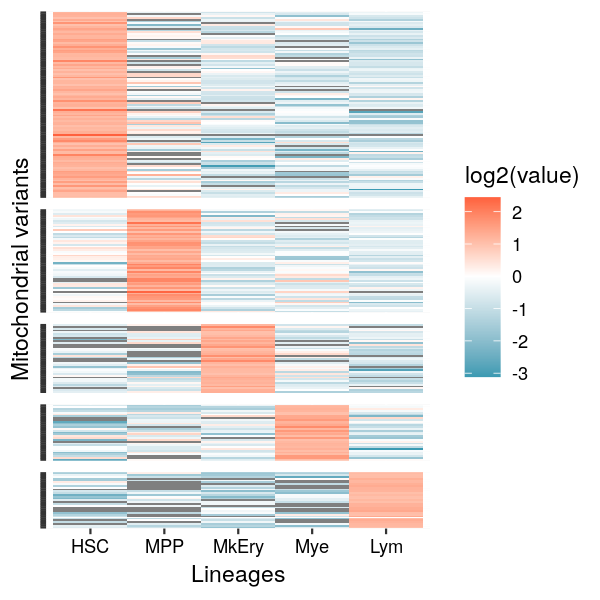

In [201]:
datatoplot<-Tomerge_v2(SigV,LV.summarise.enrich.effectSizes) %>% melt() 
head(datatoplot)
datatoplot$variable<-factor(datatoplot$variable,levels=c("HSC","MPP","MkEry","Mye","Lym"))
datatoplot$name<-factor(datatoplot$name,levels=c("V_HSC","V_MPP","V_MKEry","V_Mye","V_Lym"))

p<-ggplot(datatoplot)+aes(variable,V,fill=log2(value))+geom_tile()+facet_grid(name~.,space="free",scale="free")+
    scale_fill_gradient2(high=wes_palette("Zissou1")[5],low=wes_palette("Zissou1")[1],mid="white")+theme(axis.text.y = element_blank(),axis.text.x = element_text(color="black"),strip.text = element_blank())+labs(x="Lineages",y="Mitochondrial variants")

pdf(paste(pdf,"LinBiasV.pdf",sep=""))
print(p)
dev.off()
print(p)

---
### Show examples on UMAP


In [189]:
Donor04_agg_Multiome_wrapper<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Donor04_agg_Multiome_wrapper.rds")

Attaching SeuratObject



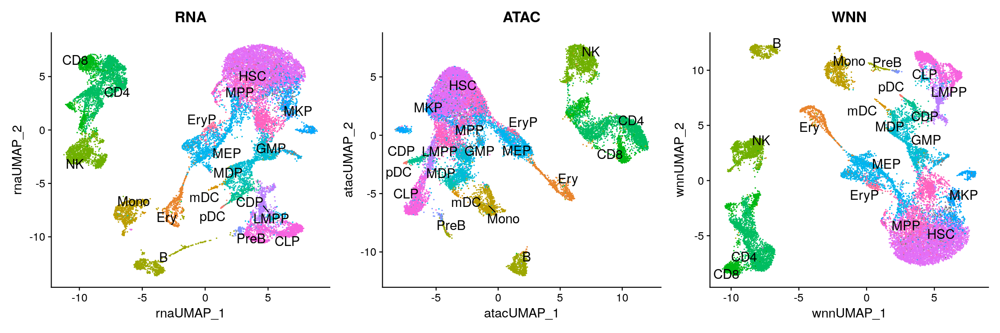

In [204]:
library(Seurat)
options(repr.plot.width=15, repr.plot.height=5,repr.plot.res=150)
p1 <- DimPlot(Donor04_agg_Multiome_wrapper, reduction = "umap.rna",  label = T, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(Donor04_agg_Multiome_wrapper, reduction = "umap.atac",  label = T, label.size = 5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(Donor04_agg_Multiome_wrapper, reduction = "wnn.umap", label = T, label.size = 5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

In [210]:
colnames(LV.summarise.enrich.pvalues)

[1] "MkEry" "MPP"   "HSC"   "Mye"   "Lym"

In [205]:
# Link RNA name with the ATAC name
meta<-Translate_RNA2ATAC(Donor04_agg_Multiome_wrapper@meta.data,from=c(1,2,3),to=c(3,2,1))

In [341]:
## Pick top HSC Variants
HSCV.example<-LV.summarise.enrich.effectSizes[row.names(subset(LV.summarise.enrich.pvalues,HSC<0.01)),] %>% .[order(.$HSC,decreasing=T),] %>% .[1:8,] # %>% row.names
Mye.example<-LV.summarise.enrich.effectSizes[row.names(subset(LV.summarise.enrich.pvalues,Mye<0.01)),] %>% .[order(.$Mye,decreasing=T),] %>% .[1:8,] 
Lym.example<-LV.summarise.enrich.effectSizes[row.names(subset(LV.summarise.enrich.pvalues,Lym<0.01)),] %>% .[order(.$Lym,decreasing=T),] %>% .[1:8,] 
MkEry.example<-LV.summarise.enrich.effectSizes[row.names(subset(LV.summarise.enrich.pvalues,MkEry<0.01)),] %>% .[order(.$MkEry,decreasing=T),] %>% .[1:8,] 


In [342]:
Mye.example
MkEry.example


,MkEry,MPP,HSC,Mye,Lym
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3823_T_C,0.7220870,0.0000000,0.2858330,3.542648,0.5109855
3081_A_G,0.7622030,0.5054072,0.6034252,3.116218,0.3595824
11693_G_T,0.4157471,0.0000000,1.4811346,3.059560,0.2942038
11834_T_C,0.8314941,0.0000000,0.4937115,3.059560,0.5884076
16029_T_C,0.0000000,0.8270300,1.4811346,3.059560,0.2942038
6011_T_C,0.8314941,0.8270300,0.0000000,3.059560,0.5884076
2076_C_A,0.2690128,1.6054113,0.3194604,2.639620,0.7614686
6023_G_C,0.0000000,0.5351371,0.0000000,2.639620,1.5229372


,MkEry,MPP,HSC,Mye,Lym
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
4048_G_C,3.658574,0.0000000,0.0000000,0.0000000,0.6472483
8738_T_C,3.658574,0.0000000,0.0000000,1.1218385,0.0000000
4913_A_C,3.429913,0.0000000,1.3577067,0.0000000,0.0000000
5947_T_C,3.266584,0.0000000,0.0000000,0.8013132,0.4623202
12945_T_C,2.858261,1.1371663,0.6788534,0.7011491,0.0000000
14793_A_G,2.667710,1.5162217,0.0000000,1.4022981,0.0000000
4290_T_C,2.667710,0.7581109,0.0000000,0.4674327,0.8090604
5979_G_C,2.667710,0.0000000,0.0000000,0.0000000,1.3484340


In [236]:
Lym.example

,MkEry,MPP,HSC,Mye,Lym
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1897_A_C,0.8314941,0.000000,0.0000000,0.0000000,2.647834
13895_T_C,0.0000000,0.000000,0.5430827,0.5609192,2.588993
7311_T_C,0.6533168,0.000000,0.3879162,0.0000000,2.542761
12733_A_T,0.5081353,1.010814,0.0000000,0.0000000,2.517077
2141_T_C,1.0162706,0.000000,0.0000000,0.0000000,2.517077
2150_T_C,0.5081353,0.000000,0.0000000,0.6232436,2.517077


In [256]:
datatoplot<-Tomerge_v2(meta,Donor04_agg_Multiome_wrapper@reductions$wnn.umap@cell.embeddings)

In [257]:
HSC.Vs<-paste("Variants",gsub("_","",row.names(HSCV.example)),sep="")
HSC.Vs.Show<-gsub("_","",row.names(HSCV.example))

Mye.Vs<-paste("Variants",gsub("_","",row.names(Mye.example)),sep="")
Mye.Vs.Show<-gsub("_","",row.names(Mye.example))

Lym.Vs<-paste("Variants",gsub("_","",row.names(Lym.example)),sep="")
Lym.Vs.Show<-gsub("_","",row.names(Lym.example))

MkEry.Vs<-paste("Variants",gsub("_","",row.names(MkEry.example)),sep="")
MkEry.Vs.Show<-gsub("_","",row.names(MkEry.example))

In [258]:
#Vsindex<-
Top.Cell.V.mtx<-HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx[,HSC.Vs] %>% .[rowSums(.)>0,] 
Highlight.HSC<-apply(Top.Cell.V.mtx,1,function(x){paste(HSC.Vs.Show[which(x!=0)],collapse="/")}) %>% data.frame(HSC.Highlight=.) %>% tibble::rownames_to_column("ATACName")

Top.Cell.V.mtx<-HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx[,Mye.Vs] %>% .[rowSums(.)>0,] 
Highlight.Mye<-apply(Top.Cell.V.mtx,1,function(x){paste(Mye.Vs.Show[which(x!=0)],collapse="/")}) %>% data.frame(Mye.Highlight=.) %>% tibble::rownames_to_column("ATACName")

Top.Cell.V.mtx<-HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx[,Lym.Vs] %>% .[rowSums(.)>0,] 
Highlight.Lym<-apply(Top.Cell.V.mtx,1,function(x){paste(Lym.Vs.Show[which(x!=0)],collapse="/")}) %>% data.frame(Lym.Highlight=.) %>% tibble::rownames_to_column("ATACName")

Top.Cell.V.mtx<-HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx[,MkEry.Vs] %>% .[rowSums(.)>0,] 
Highlight.MkEry<-apply(Top.Cell.V.mtx,1,function(x){paste(MkEry.Vs.Show[which(x!=0)],collapse="/")}) %>% data.frame(MkEry.Highlight=.) %>% tibble::rownames_to_column("ATACName")




# head(datatoplot2)

datatoplot2<-merge(datatoplot,Highlight.HSC,by="ATACName",all.x=T) %>% merge(.,Highlight.Mye,by="ATACName",all.x=T) %>% 
merge(.,Highlight.Lym,by="ATACName",all.x=T) %>% merge(.,Highlight.MkEry,by="ATACName",all.x=T)
head(datatoplot2)

,ATACName,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nCount_SCT,nFeature_SCT,SCT.weight,ATAC.weight,wsnn_res.0.8,seurat_clusters,CellType,wnnUMAP_1,wnnUMAP_2,HSC.Highlight,Mye.Highlight,Lym.Highlight,MkEry.Highlight
,<chr>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,AAACAAGCAAACTAAC_3,SeuratProject,1883,1122,11762,5062,3666,1151,0.6080491,0.3919509,9,9,CD4,-9.047747,-3.979492,NA,NA,NA,NA
2,AAACAAGCAAGGGAGC_3,SeuratProject,1665,1068,7802,3797,3450,1127,0.5218575,0.4781425,2,2,CD4,-7.658205,-7.987600,NA,NA,NA,NA
3,AAACAAGCACATTGTC_1,SeuratProject,2334,1250,13607,6308,3616,1254,0.6012776,0.3987224,1,1,HSC,2.582564,-6.728126,NA,NA,NA,NA
4,AAACAAGCACCTCGAC_2,SeuratProject,3555,2016,9006,4500,3753,2016,0.5508985,0.4491015,1,1,HSC,2.943585,-4.139294,NA,NA,NA,NA
5,AAACAAGCACTTCAAC_3,SeuratProject,2245,1307,12435,5542,3567,1317,0.5529406,0.4470594,12,12,CD8,-9.944214,-7.897418,NA,NA,NA,NA
6,AAACAAGCACTTGCTG_1,SeuratProject,6811,2759,20254,8943,4854,2732,0.6664316,0.3335684,18,18,MKP,6.209175,-1.905181,NA,NA,NA,NA


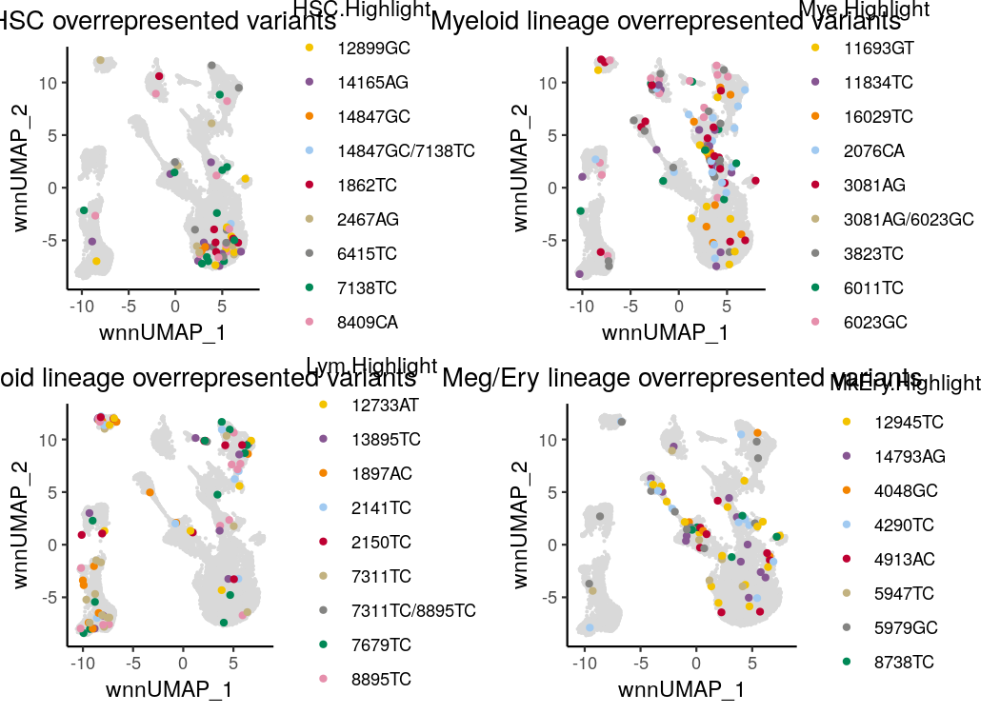

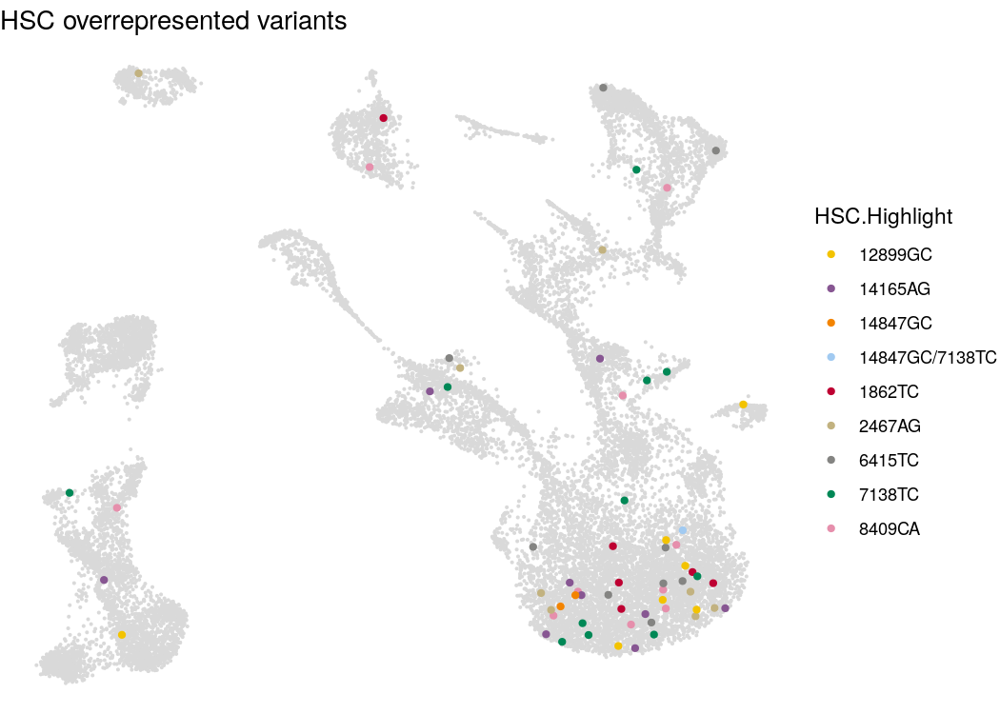

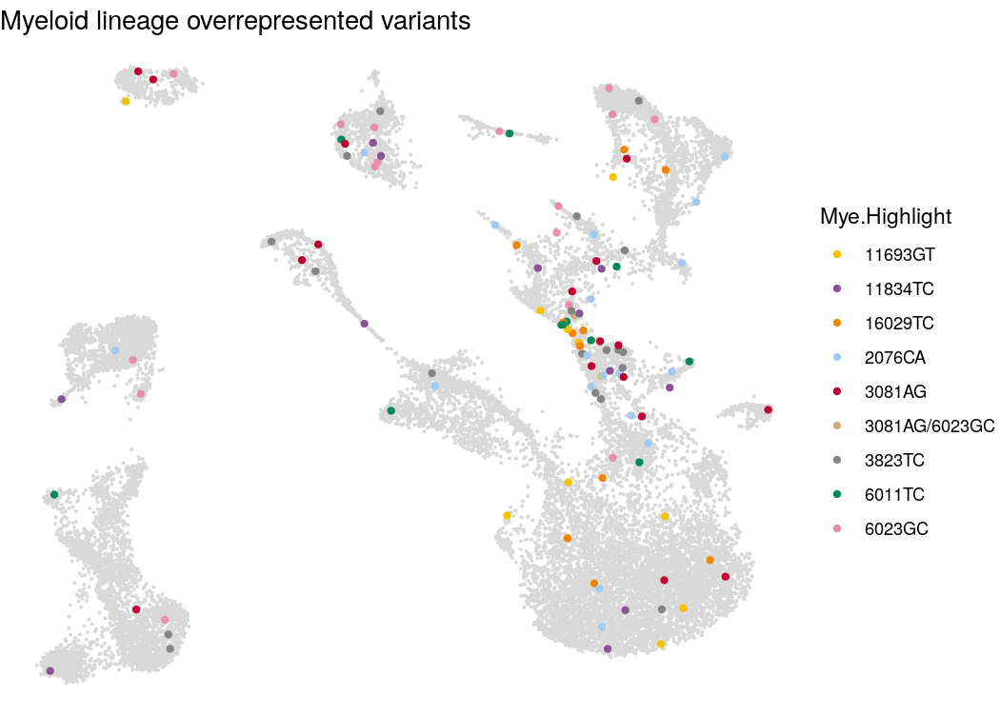

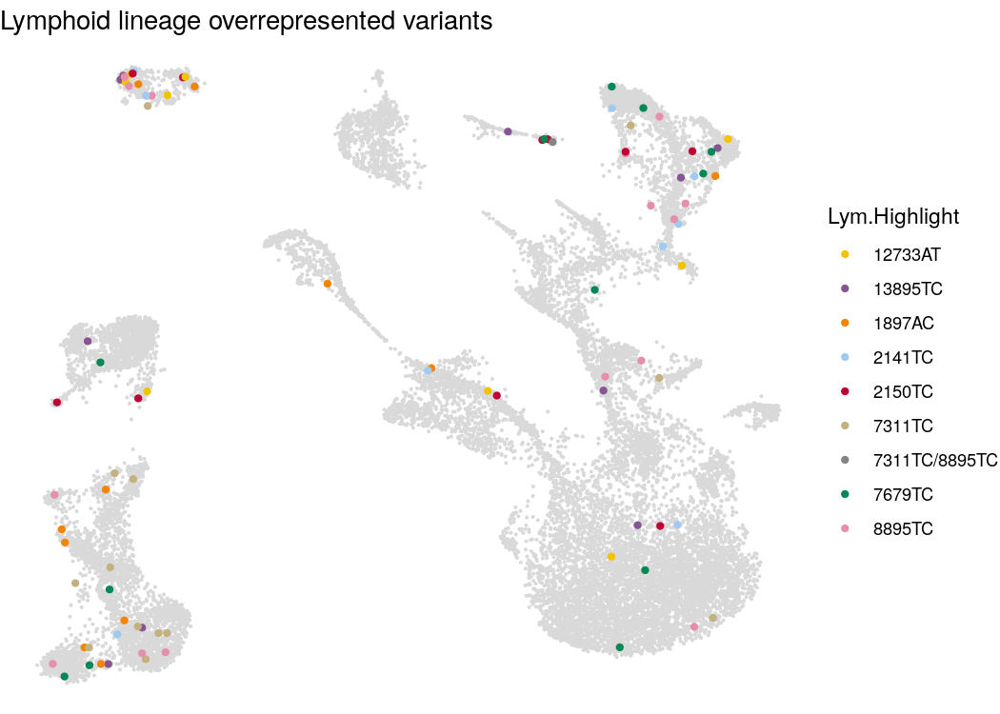

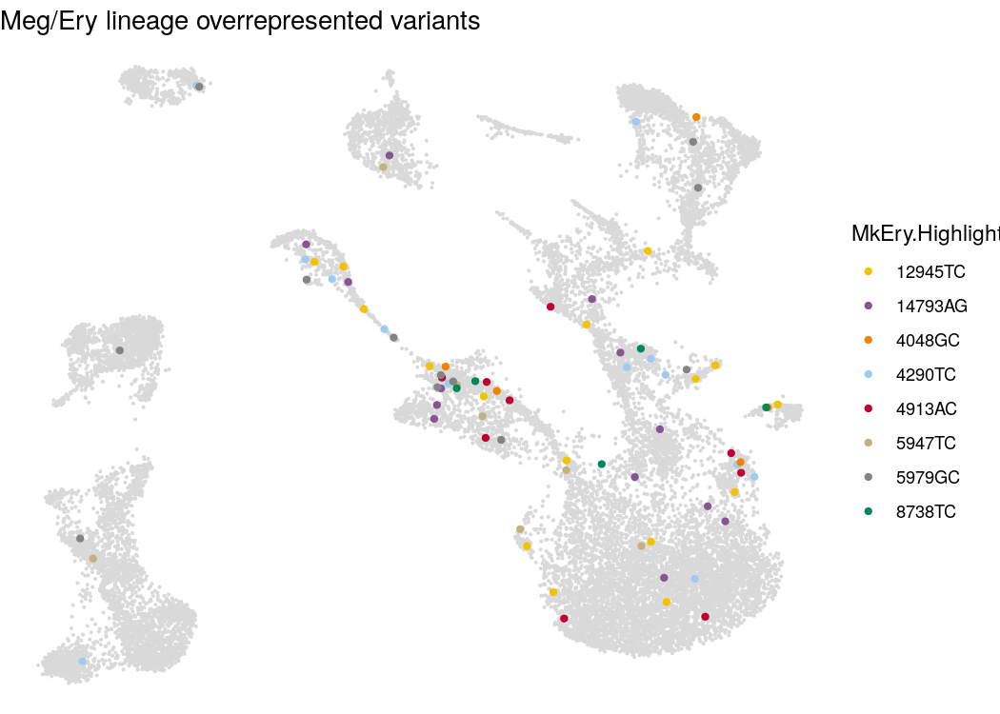

In [296]:
options(repr.plot.width=7, repr.plot.height=5,repr.plot.res=150)
p1<-ggplot(datatoplot2)+aes(wnnUMAP_1,wnnUMAP_2)+geom_point(color="grey85",size=0.25)+geom_point(data=subset(datatoplot2,! is.na(HSC.Highlight)),aes(wnnUMAP_1,wnnUMAP_2,color=HSC.Highlight),size=1.2)+
theme_classic()+scale_color_discrete_c4a_cat(palette = "kelly")+ggtitle("HSC overrepresented variants")+theme(plot.title = element_text(hjust = 0.5,colour = "black"))

p2<-ggplot(datatoplot2)+aes(wnnUMAP_1,wnnUMAP_2)+geom_point(color="grey85",size=0.25)+geom_point(data=subset(datatoplot2,! is.na(Mye.Highlight)),aes(wnnUMAP_1,wnnUMAP_2,color=Mye.Highlight),size=1.2)+
theme_classic()+scale_color_discrete_c4a_cat(palette = "kelly")+ggtitle("Myeloid lineage overrepresented variants")+theme(plot.title = element_text(hjust = 0.5,colour = "black"))

p3<-ggplot(datatoplot2)+aes(wnnUMAP_1,wnnUMAP_2)+geom_point(color="grey85",size=0.25)+geom_point(data=subset(datatoplot2,! is.na(Lym.Highlight)),aes(wnnUMAP_1,wnnUMAP_2,color=Lym.Highlight),size=1.2)+
theme_classic()+scale_color_discrete_c4a_cat(palette = "kelly")+ggtitle("Lymphoid lineage overrepresented variants")+theme(plot.title = element_text(hjust = 0.5,colour = "black"))

p4<-ggplot(datatoplot2)+aes(wnnUMAP_1,wnnUMAP_2)+geom_point(color="grey85",size=0.25)+geom_point(data=subset(datatoplot2,! is.na(MkEry.Highlight)),aes(wnnUMAP_1,wnnUMAP_2,color=MkEry.Highlight),size=1.2)+
theme_classic()+scale_color_discrete_c4a_cat(palette = "kelly")+ggtitle("Meg/Ery lineage overrepresented variants")+theme(plot.title = element_text(hjust = 0.5,colour = "black"))

grid.arrange(p1,p2,p3,p4)

print(p1+theme_void())
print(p2+theme_void())
print(p3+theme_void())
print(p4+theme_void())



In [285]:
library(grid)
library(gridExtra)
library(cowplot)
pdf(paste(pdf,"LinBiasExampleUmap.legend.pdf"))
grid.newpage()
grid.draw(get_legend(p1))
grid.newpage()
grid.draw(get_legend(p2))
grid.newpage()
grid.draw(get_legend(p3))
grid.newpage()
grid.draw(get_legend(p4))
dev.off()
dev.off()

png 
  2

pdf 
  3

In [282]:
paste(pdf,"LinBiasExampleUmap.legend.pdf")

[1] "/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/PDFs/ LinBiasExampleUmap.legend.pdf"

In [1895]:
## Pick cells for individual variant
# V="11753_T_C"
# V<-paste("Variants",gsub("_","",V),sep="")
# row.names(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx)[HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx[,V]>0]
#meta$tag<-ifelse(meta$ATACName %in% row.names(HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx)[HSC_HPC_BMMC_mitoTracing.verysensitive@Cts.Mtx[,V]>0], "H","")

[1] "14847_G_C" "1862_T_C"  "12899_G_C" "6415_T_C"  "14165_A_G" "2467_A_G" 
 [7] "7138_T_C"  "8409_C_A"  "10836_A_G" "4986_A_G"  "11627_T_C" "14566_A_G"
[13] "6955_G_C"  "11165_T_C" "11812_A_G" "789_T_C"   "13216_A_G" "6873_C_G" 
[19] "1047_A_G"  "11753_T_C"

[1] "AATGTGGGTTTACCAA_2" "ACAGTAATCCTTCATC_3" "ACTGCAACATAGGTGC_1"
 [4] "ATAATCGAGTCATAAG_1" "ATACCTAGTAGCCTTG_3" "CAGAATCAGCTCCCTC_2"
 [7] "CGTAAGGTCAAGCTTT_1" "GAAACTGGTGAGCATA_1" "GAACGATTCGCATTTG_2"
[10] "GCACACAAGTGTCCAC_1" "GCTCCATAGCTTGCCG_3" "GCTTTAGTCCGCCATG_1"
[13] "GGATTATCATACTGAG_1" "GGCTGAGGTATAGCGA_2" "GTCATTTAGGGTGGGA_1"
[16] "TCAACAAAGGCTCAAG_1" "TCAAGCCTCAGCTAGG_1" "TTTCTAGCACGGATTA_1"

In [ ]:
## Pick the top variant examples to show

### Try permutation

In [1662]:
HSCs<-c()
MPPs<-c()
Myes<-c()
Lyms<-c()
MKs<-c()
totals<-c()

In [1687]:
for(i in 1:500){
LV %>% mutate(Variants.PM=sample(Variants)) -> LV
LV.summarise.PM<-LV %>% group_by(Variants.PM) %>% dplyr::count(Lineage) %>% dcast(Variants.PM~Lineage)
row.names(LV.summarise.PM)<-LV.summarise.PM$Variants.PM
LV.summarise.PM<-LV.summarise.PM[,-1]
LV.summarise.PM[is.na(LV.summarise.PM)]<-0
LV.summarise.PM$sum<-rowSums(LV.summarise.PM)
LV.summarise.PM.raw<-apply(LV.summarise.PM,1,VariantLinBiase.compute)
LV.summarise.PM.enrich.pvalues<- lapply(LV.summarise.PM.raw,function(x){x[[1]]}) %>% do.call(rbind,.) %>% as.data.frame
LV.summarise.PM.enrich.effectSizes<-lapply(LV.summarise.PM.raw,function(x){x[[2]]}) %>% do.call(rbind,.)  %>% as.data.frame
## Generate significantly biased variants
HSC.V.PM<-LV.summarise.PM.enrich.pvalues[which(LV.summarise.PM.enrich.effectSizes$HSC>2 & LV.summarise.PM.enrich.pvalues$HSC<0.01),] %>% .[order(.$HSC,decreasing=T),] %>% row.names
MPP.V.PM<-LV.summarise.PM.enrich.pvalues[which(LV.summarise.PM.enrich.effectSizes$MPP>2 & LV.summarise.PM.enrich.pvalues$MPP<0.01),] %>% .[order(.$MPP,decreasing=T),] %>% row.names
Mye.V.PM<-LV.summarise.PM.enrich.pvalues[which(LV.summarise.PM.enrich.effectSizes$Mye>2 & LV.summarise.PM.enrich.pvalues$Mye<0.01),] %>% .[order(.$Mye,decreasing=T),] %>% row.names
Lym.V.PM<-LV.summarise.PM.enrich.pvalues[which(LV.summarise.PM.enrich.effectSizes$Lym>2 & LV.summarise.PM.enrich.pvalues$Lym<0.01),] %>% .[order(.$Lym,decreasing=T),] %>% row.names
MKEry.V.PM<-LV.summarise.PM.enrich.pvalues[which(LV.summarise.PM.enrich.effectSizes$MkEry>2 & LV.summarise.PM.enrich.pvalues$MkEry<0.01),] %>% .[order(.$MkEry,decreasing=T),] %>% row.names
SigV.PM<-data.frame(V=HSC.V.PM,name="V_HSC") %>% rbind(.,data.frame(V=MPP.V.PM,name="V_MPP")) %>% rbind(.,data.frame(V=Mye.V.PM,name="V_Mye")) %>% 
rbind(.,data.frame(V=Lym.V.PM,name="V_Lym")) %>% rbind(.,data.frame(V=MKEry.V.PM,name="V_MKEry")) %>% .[!duplicated(.$V),] 
row.names(SigV.PM)<-SigV.PM$V


HSCs<-c(HSCs,length(HSC.V.PM))
MPPs<-c(MPPs,length(MPP.V.PM))
Myes<-c(Myes,length(Mye.V.PM))
Lyms<-c(Lyms,length(Lym.V.PM))
MKs<-c(MKs,length(MKEry.V.PM))
totals<-c(totals,nrow(SigV.PM))

}    

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to override.

Using n as value column: use value.var to over

In [297]:
# length(HSC.V)
# length(MPP.V)
# length(Mye.V)
# length(Lym.V)
# length(MKEry.V)
# HSCs
# MPPs
# Myes
# Lyms
# MKs
# totals
Real.biasedN<-data.frame(variable=c("HSCs","MPPs","Myes","Lyms","MKs"),realN=c(length(HSC.V),length(MPP.V),length(Mye.V),length(Lym.V),length(MKEry.V)))

In [298]:
Permutated.LinN<-readRDS("/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Permutated.LinN.rds")

No id variables; using all as measure variables



png 
  2

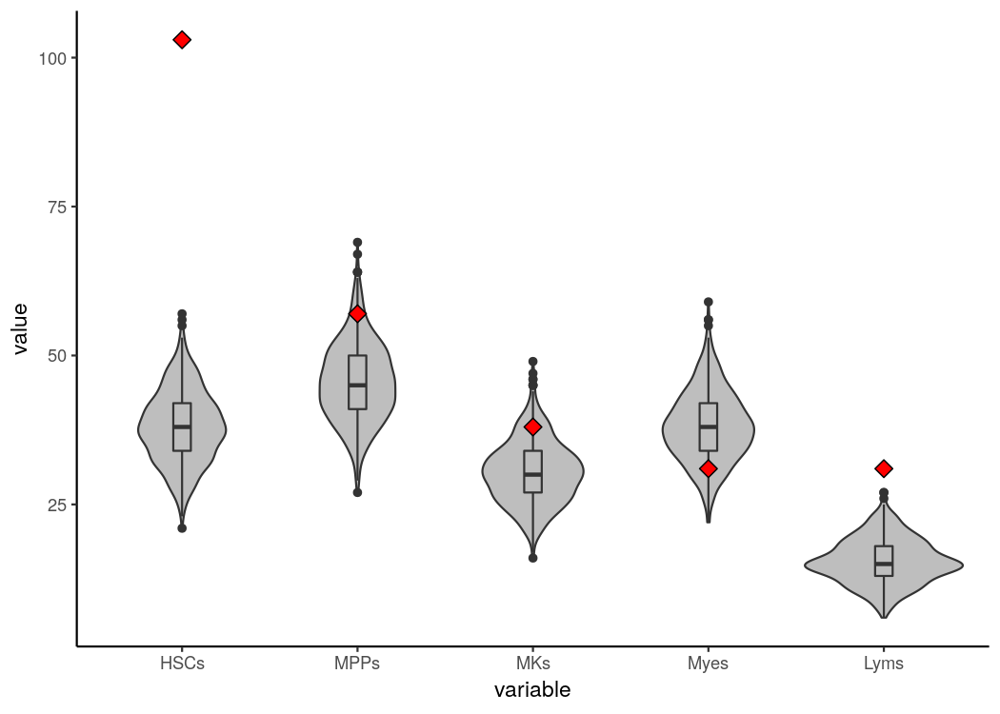

In [301]:
#Permutated.LinN<-data.frame(HSCs,MPPs,MKs,Myes,Lyms)  ## This is a dataframe that stores the background number of random biased variants

p<-melt(Permutated.LinN) %>% ggplot()+aes(variable,value)+geom_violin(fill="grey")+geom_boxplot(width=0.1,fill="grey")+
geom_point(data=Real.biasedN,aes(variable,realN),size=3,fill="red",color="black",shape=23)+theme_classic()

pdf(paste(pdf,"LinBias.PermutationViolin.pdf"))
print(p)
dev.off()

print(p)

In [1719]:
# saveRDS(Permutated.LinN,"/lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Donor4Donor9/RDS/Permutated.LinN.rds")

In [1715]:
max(length(which(length(HSC.V)<HSCs))/length(HSCs),1/length(HSCs))
max(length(which(length(MPP.V)<MPPs))/length(MPPs),1/length(MPPs))
max(length(which(length(Mye.V)<Myes))/length(Myes),1/length(Myes))
max(length(which(length(Lym.V)<Lyms))/length(Lyms),1/length(Lyms))
max(length(which(length(MKEry.V)<MKs))/length(MKs),1/length(MKs))

[1] 0.001633987

[1] 0.04575163

[1] 0.869281

[1] 0.001633987

[1] 0.0751634

In [1721]:
length(HSCs)

[1] 612

In [1645]:
183/260

[1] 0.7038462

In [1624]:
22/51

[1] 0.4313725

# compute weight for each variant

Based on 8 samples, take the cell fraction median as the p_mut

In [331]:
data(CellPCT)

In [332]:
head(CellPCT)

,Variants,PCT.D4BM,PCT.D4HPC,PCT.D4HSC,PCT.D9BM,PCT.D9HPC,PCT.D9HSC,PCT.D1BM,PCT.D1HPC,PCT.NK1,PCT.NK2,PCT.NK3,top20_DN4.9_BM
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
8938,310_T_C,0.86117101,0.89793993,0.90932435,0.707446154,0.781881006,0.78826627,0.40864642,0.647128902,0.584215301,0.5882553191,0.58514903,310_T_C
8947,3109_T_C,0.23453309,0.31168423,0.27636013,0.170830769,0.244789979,0.26560737,0.06570595,0.188706219,0.121257938,0.1421276596,0.13526233,3109_T_C
11899,5764_C_T,0.07447338,0.08256015,0.10126785,0.059569231,0.068459130,0.07399398,0.00000000,0.068024780,0.000000000,0.0250212766,0.02335716,
11900,5765_C_A,0.05058882,0.05755622,0.07077516,0.043569231,0.049886621,0.05424972,0.00000000,0.049082678,0.000000000,0.0000000000,0.00000000,
11903,5766_C_G,0.04644220,0.04890706,0.05504734,0.038400000,0.043731778,0.04334336,0.00000000,0.040981654,0.000000000,0.0000000000,0.00000000,
16889,9979_G_A,0.04627633,0.04104419,0.03643075,0.003076923,0.005075046,0.00319669,0.00171556,0.002978318,0.001814333,0.0008510638,0.00000000,


In [333]:
CellPCT$muRate<-CellPCT[,c("PCT.D4BM","PCT.D4HPC","PCT.D4HSC","PCT.D9BM","PCT.D9HPC","PCT.D9HSC","PCT.D1BM","PCT.D1HPC")] %>% apply(.,1,median)

In [330]:
head(CellPCT)

,Variants,PCT.D4BM,PCT.D4HPC,PCT.D4HSC,PCT.D9BM,PCT.D9HPC,PCT.D9HSC,PCT.D1BM,PCT.D1HPC,PCT.NK1,PCT.NK2,PCT.NK3,top20_DN4.9_BM,weight
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
8938,310_T_C,0.86117101,0.89793993,0.90932435,0.707446154,0.781881006,0.78826627,0.40864642,0.647128902,0.584215301,0.5882553191,0.58514903,310_T_C,0.785073636
8947,3109_T_C,0.23453309,0.31168423,0.27636013,0.170830769,0.244789979,0.26560737,0.06570595,0.188706219,0.121257938,0.1421276596,0.13526233,3109_T_C,0.239661535
11899,5764_C_T,0.07447338,0.08256015,0.10126785,0.059569231,0.068459130,0.07399398,0.00000000,0.068024780,0.000000000,0.0250212766,0.02335716,,0.071226556
11900,5765_C_A,0.05058882,0.05755622,0.07077516,0.043569231,0.049886621,0.05424972,0.00000000,0.049082678,0.000000000,0.0000000000,0.00000000,,0.050237721
11903,5766_C_G,0.04644220,0.04890706,0.05504734,0.038400000,0.043731778,0.04334336,0.00000000,0.040981654,0.000000000,0.0000000000,0.00000000,,0.043537570
16889,9979_G_A,0.04627633,0.04104419,0.03643075,0.003076923,0.005075046,0.00319669,0.00171556,0.002978318,0.001814333,0.0008510638,0.00000000,,0.004135868


## For Old1 BMMC/ Old1-HSPC/ Old2-BMMC/ Old2-HSPC

- Preprocess atac_chr_summarise in the Cellranger folder 
```shell
    cd /lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Old1Old2/Old1/BMMC/CellRanger/Old1_BMMC/outs 
    cd /lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Old1Old2/Old1/HSPC/CellRanger/Old1_HSPC/outs
    cd /lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Old1Old2/Old2/BMMC/CellRanger/Old2_BMMC/outs 
    cd /lab/solexa_weissman/cweng/Projects/MitoTracing_Velocity/SecondaryAnalysis/Old1Old2/Old2/HSPC/CellRanger/Old2_HSPC/outs
    
    zcat atac_fragments.tsv.gz | grep -v '^#' | sort -k1,1 -k4,4 > atac_fragments.tsv.sorted 
    path=/lab/solexa_weissman/cweng/Packages/MyMultiome/Helpers/  
    $path/Summarize.chr.py atac_fragments.tsv.sorted filtered_feature_bc_matrix/barcodes.tsv.gz > atac_chr_summarise 
```




- Read in atac_chr_summarise